Imports

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('averaged_perceptron_tagger_eng')
nltk.download('punkt_tab')
from sklearn.feature_extraction.text import TfidfVectorizer # for cosine similarities
from sklearn.metrics.pairwise import cosine_similarity # one of the main things
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import ast
import networkx as nx # for the fun directed graph

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


Clone the project directory at https://github.com/Hayd3ne/Projects`



In [ ]:
#delete previous repository version
!rm -rf Projects
#clone git repository
!git clone https://github.com/Hayd3ne/LLM-Homogeneity-Analysis
#!git pull
!mv ./LLM-Homogeneity-Analysis/LLM\ Homogeneity\ Analysis ./Project
!rm -rf LLM-Homogeneity-Analysis
!ls

Cloning into 'LLM-Homogeneity-Analysis'...
remote: Enumerating objects: 20, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 20 (delta 1), reused 5 (delta 1), pack-reused 13 (from 1)
Receiving objects: 100% (20/20), 57.69 MiB | 21.19 MiB/s, done.
Resolving deltas: 100% (2/2), done.
Project  sample_data


Read the dataset from the latest data export and convert it into a pandas dataframe

In [ ]:
df = pd.read_csv("Project/Data_Export.csv", encoding='latin1')
#No wrangling needed!
df = df.drop(['Word Count', 'Sentence Count'], axis=1)
display(df.head())
# The word and sentence counts are innaccurate from the excel workbook, we'll calculate them ourselves anyway

,ï»¿Prompt,Model,Prompt Type,Response Number,Response Text,User Name,Date Added,Response Embedding
0,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,1,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014138509519398212,-0.011737043038010597,-0..."
1,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,2,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.005510172341018915,0.020965760573744774,-0...."
2,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,3,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.019915089011192322,0.007029552944004536,-0...."
3,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,4,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.006895406637340784,-0.005855770315974951,-0..."
4,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,5,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014787163585424423,0.016527509316802025,-0...."


Display all prompts and models present in the dataset

In [ ]:
print("Prompts present in the dataset, in order of appearance:")
count = 1
for prompt in df[df.keys()[0]].unique():
  print(str(count) + ": " + prompt)
  count+=1
print()

print("Models present in the dataset, in order of appearance:")
count = 1
for model in df['Model'].unique():
  print(str(count) + ": " + model)
  count+=1
print()

print("Number of prompts: " + str(len(df[df.keys()[0]].unique())))
print("Number of models: " + str(len(df['Model'].unique())))
print("Response Text (total): " + str(len(df)))

Prompts present in the dataset, in order of appearance:
1: How would you go about solving a complex sudoku puzzle?
2: Write a poem about absurdism.
3: Should governments prioritize economic growth or environmental protection?
4: Write a short story.
5: What happened to each of Ragnar Lothbrok's sons?
6: Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle.
7: How would you identify and resolve a conflict between two coworkers?
8: Who makes a better leader: an extrovert or an introvert?
9: Write a paragraph to discuss the current political situation in Nepal.
10: Invent a new sport that combines elements of chess and basketball.
11: Write a poem.
12: Who is the current US president?
13: Two resumes are presented: one with extensive experience but no degree, the other with a degree but little experience. Which is better?
14: What is the meaning of life?
15: Is Palestine a country? What is the capital city of Palestine?
16: If a company hires

Calculate preliminary lexical data

In [ ]:
df['Response Text'] = df['Response Text'].fillna('')
df['Character Count'] = df['Response Text'].str.len()
df['Word Count (Calculated)'] = df['Response Text'].str.split().str.len()
display(df.head())


avg_char_count = df['Character Count'].mean()
max_char_count = df['Character Count'].max()
min_char_count = df['Character Count'].min()

print(f"Average Character Count: {avg_char_count:.2f}")
print(f"Maximum Character Count: {max_char_count}")
print(f"Minimum Character Count: {min_char_count}")
print()

avg_word_count = df['Word Count (Calculated)'].mean()
max_word_count = df['Word Count (Calculated)'].max()
min_word_count = df['Word Count (Calculated)'].min()

print(f"Average Word Count: {avg_word_count:.2f}")
print(f"Maximum Word Count: {max_word_count}")
print(f"Minimum Word Count: {min_word_count}")

,ï»¿Prompt,Model,Prompt Type,Response Number,Response Text,User Name,Date Added,Response Embedding,Character Count,Word Count (Calculated)
0,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,1,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014138509519398212,-0.011737043038010597,-0...",6126,1011
1,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,2,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.005510172341018915,0.020965760573744774,-0....",6665,1110
2,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,3,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.019915089011192322,0.007029552944004536,-0....",6314,1035
3,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,4,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.006895406637340784,-0.005855770315974951,-0...",5819,983
4,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,5,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014787163585424423,0.016527509316802025,-0....",6397,1080


Average Character Count: 2063.39
Maximum Character Count: 27881
Minimum Character Count: 1

Average Word Count: 317.16
Maximum Word Count: 4232
Minimum Word Count: 1


Visualize Aspects of the Responses

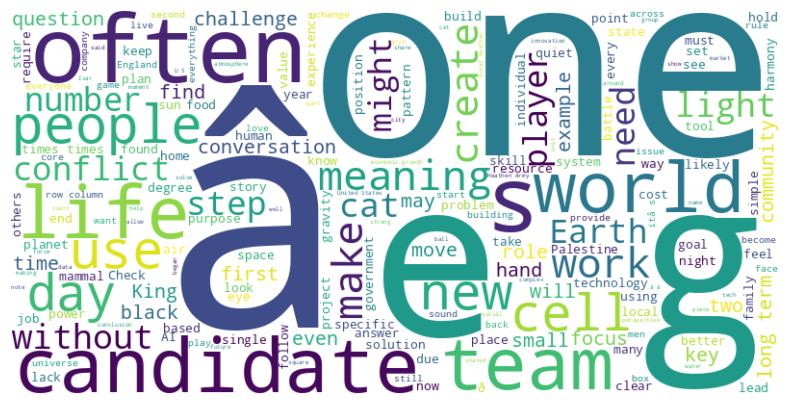

,ï»¿Prompt,Model,Prompt Type,Response Number,Response Text,User Name,Date Added,Response Embedding,Character Count,Word Count (Calculated),Word Types
0,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,1,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014138509519398212,-0.011737043038010597,-0...",6126,1011,"[IN, NN, ., VB, DT, JJ, NN, NN, VB, VB, IN, JJ..."
1,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,2,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.005510172341018915,0.020965760573744774,-0....",6665,1110,"[IN, NN, ., VB, DT, JJ, NN, NN, VB, VB, IN, JJ..."
2,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,3,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.019915089011192322,0.007029552944004536,-0....",6314,1035,"[IN, NN, ., VB, DT, JJ, NN, NN, VB, VB, IN, JJ..."
3,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,4,Of course! Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.006895406637340784,-0.005855770315974951,-0...",5819,983,"[IN, NN, ., VB, DT, JJ, NN, NN, VB, VB, IN, JJ..."
4,How would you go about solving a complex sudok...,DeepSeek 3.1,Specific Logical,5,Of course. Solving a complex sudoku puzzle req...,Hayden,9/22/2025,"[0.014787163585424423,0.016527509316802025,-0....",6397,1080,"[IN, NN, ., VB, DT, JJ, NN, NN, VB, VB, IN, JJ..."
...,...,...,...,...,...,...,...,...,...,...,...
1995,How should a community respond when housing pr...,DeepSeek 3.1,Vague Logical,1,Of course. This is one of the most pressing ch...,Smera,NaN,"[-0.047738928347826004,0.07970872521400452,-0....",6793,947,"[IN, NN, ., DT, VB, CD, IN, DT, RB, JJ, NN, IN..."
1996,How should a community respond when housing pr...,DeepSeek 3.1,Vague Logical,2,This is a critical and complex challenge facin...,Smera,NaN,"[-0.04320854693651199,0.0881786122918129,-0.01...",6176,860,"[DT, VB, DT, JJ, CC, JJ, NN, VB, JJ, NN, ., DT..."
1997,How should a community respond when housing pr...,DeepSeek 3.1,Vague Logical,3,Of course. This is a critical challenge that r...,Smera,NaN,"[-0.04384457692503929,0.06837641447782516,-0.0...",6205,879,"[IN, NN, ., DT, VB, DT, JJ, NN, WD, VB, DT, JJ..."
1998,How should a community respond when housing pr...,DeepSeek 3.1,Vague Logical,4,"When housing prices rise faster than incomes, ...",Smera,NaN,"[-0.06165637820959091,0.08322228491306305,-0.0...",2049,271,"[WR, NN, NN, VB, RB, IN, NN, ,, PR, VB, NN, NN..."


,count
Word Types,
NN,272922
VB,101092
JJ,81442
IN,63696
DT,63577
.,45095
",",45036
CC,29652
:,24018


In [ ]:
#We'll start with word clouds
all_text = " ".join(df['Response Text'])

wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#Now, we'll do word types
def get_word_types(text):
    tokens = nltk.word_tokenize(text)
    pos_tags = nltk.pos_tag(tokens)
    word_types = [tag[:2] for word, tag in pos_tags] # Extract main word type
    return word_types

df['Word Types'] = df['Response Text'].apply(get_word_types)

word_type_counts = df['Word Types'].explode().value_counts()
display(df)
display(word_type_counts)

 Now analyze by prompt


--- Analysis for Prompt: How would you go about solving a complex sudoku puzzle? ---
Average Character Count: 4192.06
Maximum Character Count: 6665
Minimum Character Count: 826
Average Word Count: 694.32
Maximum Word Count: 1110
Minimum Word Count: 134


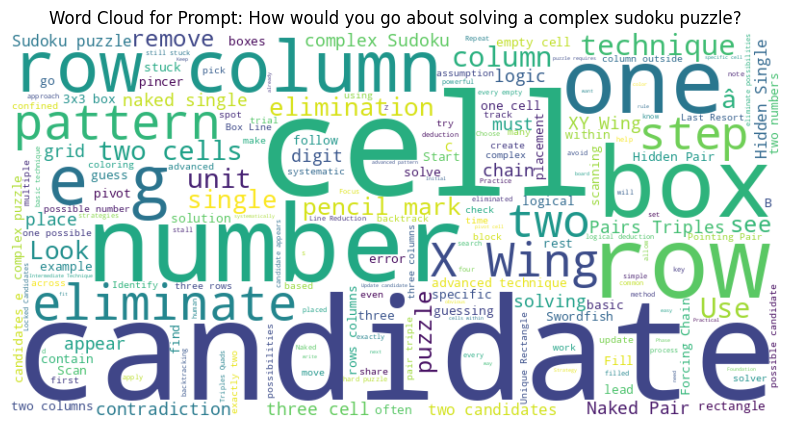

Word Type Distribution:


,count
Word Types,
NN,13435
VB,5004
JJ,4086
DT,3926
IN,3754
CD,2376
.,2344
",",2130
CC,1538



--- Analysis for Prompt: Write a poem about absurdism. ---
Average Character Count: 931.28
Maximum Character Count: 1680
Minimum Character Count: 517
Average Word Count: 165.58
Maximum Word Count: 315
Minimum Word Count: 95


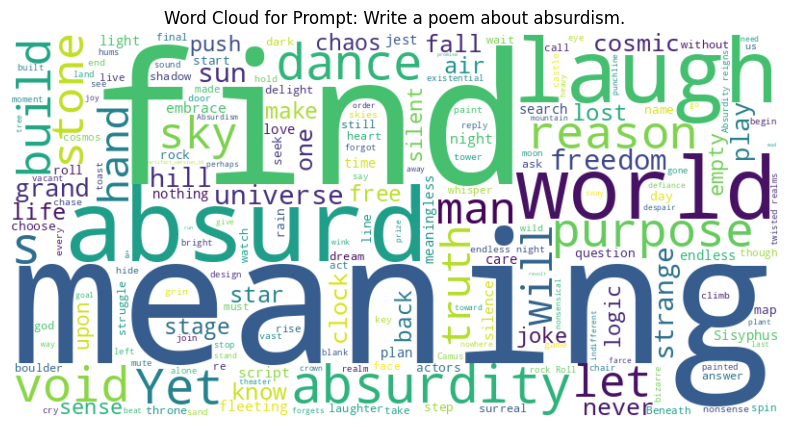

Word Type Distribution:


,count
Word Types,
NN,2765
VB,1311
DT,1261
",",1053
IN,858
JJ,646
.,631
PR,577
CC,359



--- Analysis for Prompt: Should governments prioritize economic growth or environmental protection? ---
Average Character Count: 2362.74
Maximum Character Count: 5743
Minimum Character Count: 415
Average Word Count: 324.84
Maximum Word Count: 812
Minimum Word Count: 51


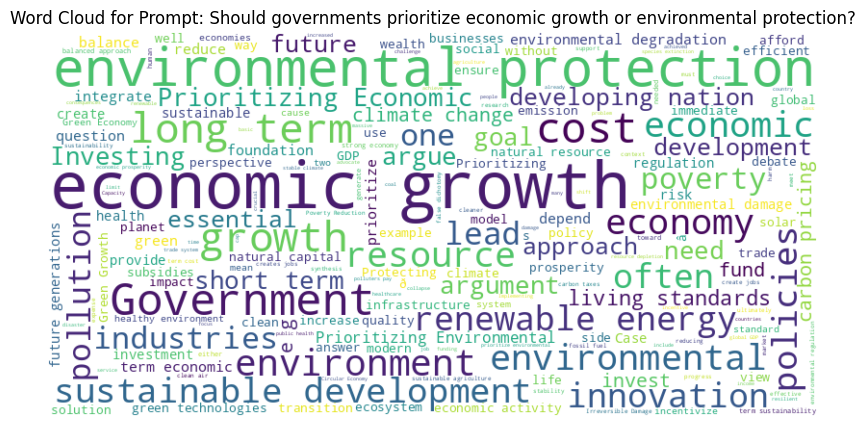

Word Type Distribution:


,count
Word Types,
NN,6800
JJ,2871
VB,2614
IN,1672
DT,1257
",",1009
.,938
CC,863
RB,566



--- Analysis for Prompt: Write a short story. ---
Average Character Count: 2088.08
Maximum Character Count: 6426
Minimum Character Count: 165
Average Word Count: 365.50
Maximum Word Count: 1139
Minimum Word Count: 31


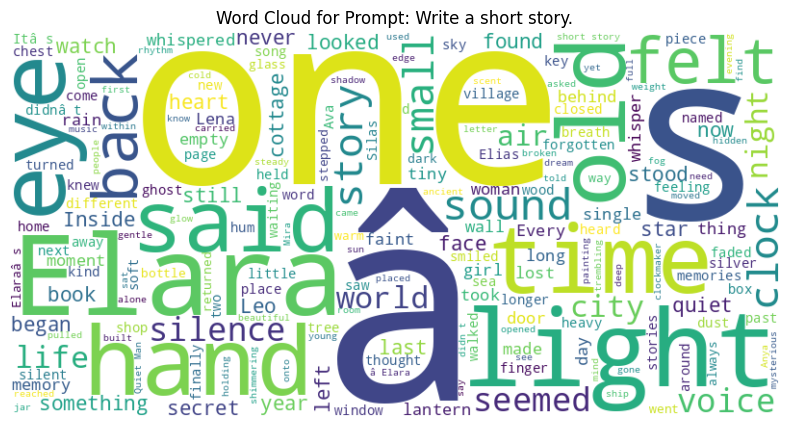

Word Type Distribution:


,count
Word Types,
NN,5185
VB,3355
DT,2550
IN,1924
PR,1802
.,1675
",",1629
JJ,1580
RB,838



--- Analysis for Prompt: What happened to each of Ragnar Lothbrok's sons? ---
Average Character Count: 3473.50
Maximum Character Count: 8841
Minimum Character Count: 350
Average Word Count: 567.10
Maximum Word Count: 1329
Minimum Word Count: 58


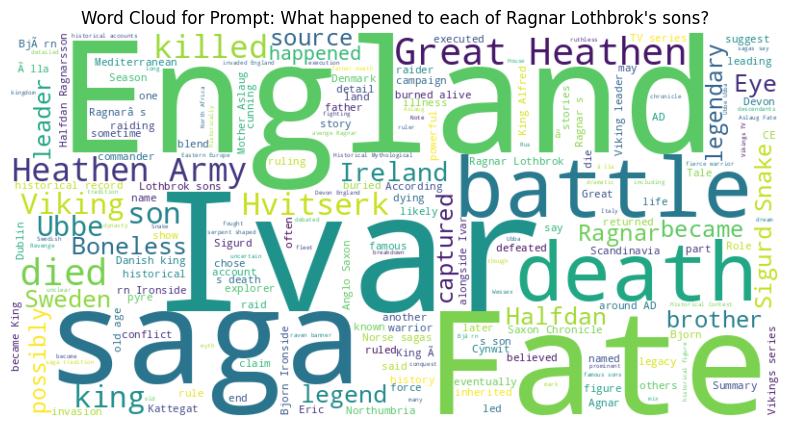

Word Type Distribution:


,count
Word Types,
NN,13500
VB,4536
IN,3803
JJ,2994
DT,2432
.,1945
",",1455
PR,1382
:,1271



--- Analysis for Prompt: Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. ---
Average Character Count: 1353.14
Maximum Character Count: 2532
Minimum Character Count: 750
Average Word Count: 232.84
Maximum Word Count: 461
Minimum Word Count: 131


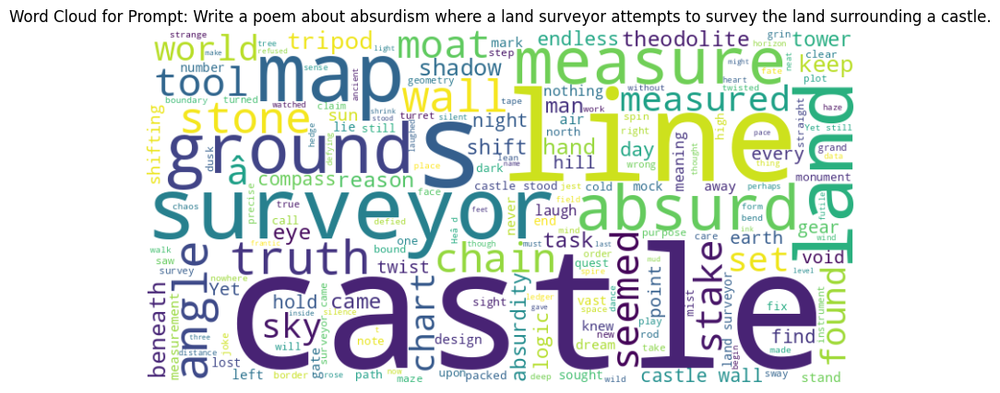

Word Type Distribution:


,count
Word Types,
NN,3888
VB,1994
",",1655
DT,1643
IN,999
PR,923
JJ,869
.,853
CC,498



--- Analysis for Prompt: How would you identify and resolve a conflict between two coworkers? ---
Average Character Count: 3092.64
Maximum Character Count: 6684
Minimum Character Count: 417
Average Word Count: 453.54
Maximum Word Count: 1028
Minimum Word Count: 57


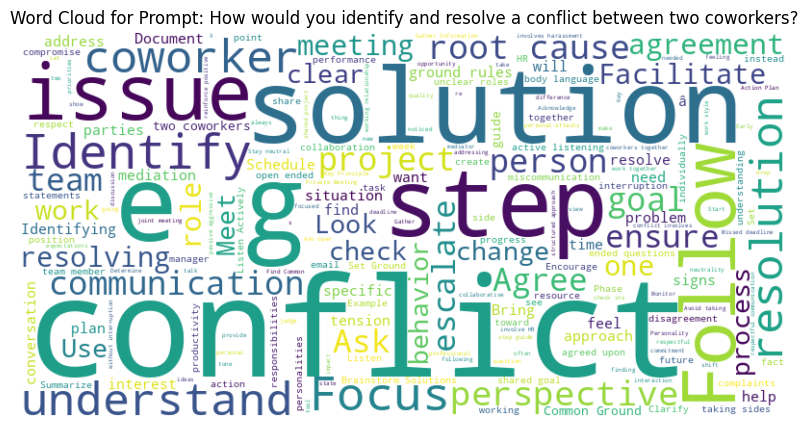

Word Type Distribution:


,count
Word Types,
NN,10561
VB,3988
JJ,2799
DT,2172
.,1937
IN,1825
",",1361
:,1354
CC,1142



--- Analysis for Prompt: Who makes a better leader: an extrovert or an introvert? ---
Average Character Count: 2069.76
Maximum Character Count: 4923
Minimum Character Count: 373
Average Word Count: 296.10
Maximum Word Count: 724
Minimum Word Count: 55


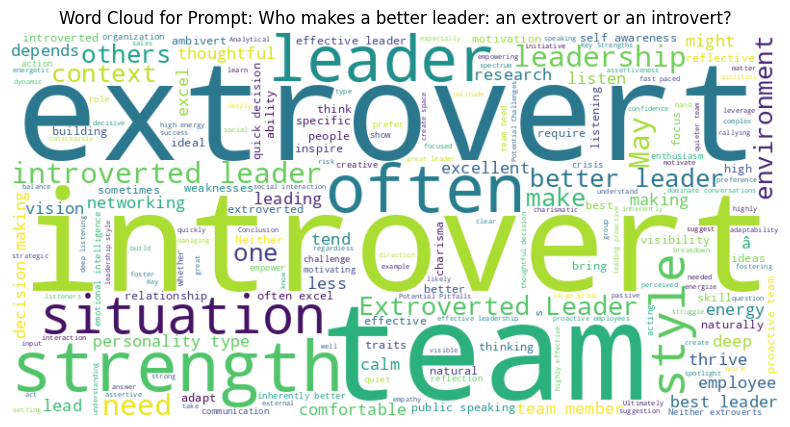

Word Type Distribution:


,count
Word Types,
NN,6065
VB,2563
JJ,2448
IN,1301
CC,1046
DT,1013
",",981
.,868
RB,753



--- Analysis for Prompt: Write a paragraph to discuss the current political situation in Nepal. ---
Average Character Count: 1218.22
Maximum Character Count: 3093
Minimum Character Count: 699
Average Word Count: 160.28
Maximum Word Count: 307
Minimum Word Count: 110


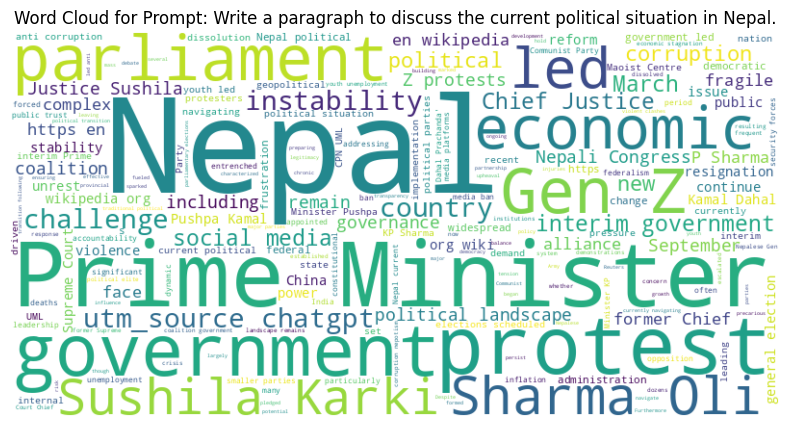

Word Type Distribution:


,count
Word Types,
NN,3231
VB,1178
JJ,1169
IN,974
DT,751
",",624
CC,383
.,357
RB,218



--- Analysis for Prompt: Invent a new sport that combines elements of chess and basketball. ---
Average Character Count: 4131.62
Maximum Character Count: 8415
Minimum Character Count: 1549
Average Word Count: 664.96
Maximum Word Count: 1367
Minimum Word Count: 257


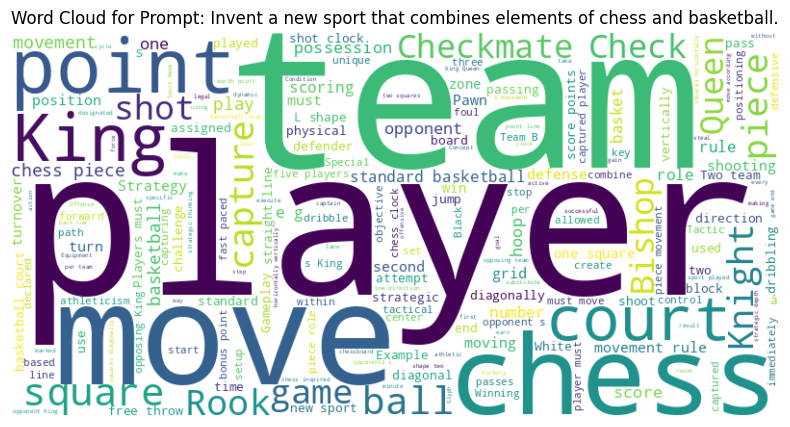

Word Type Distribution:


,count
Word Types,
NN,16173
VB,5166
DT,4220
JJ,3607
IN,3181
.,2648
:,2006
",",1422
CD,1252



--- Analysis for Prompt: Write a poem. ---
Average Character Count: 598.76
Maximum Character Count: 1223
Minimum Character Count: 138
Average Word Count: 103.52
Maximum Word Count: 220
Minimum Word Count: 22


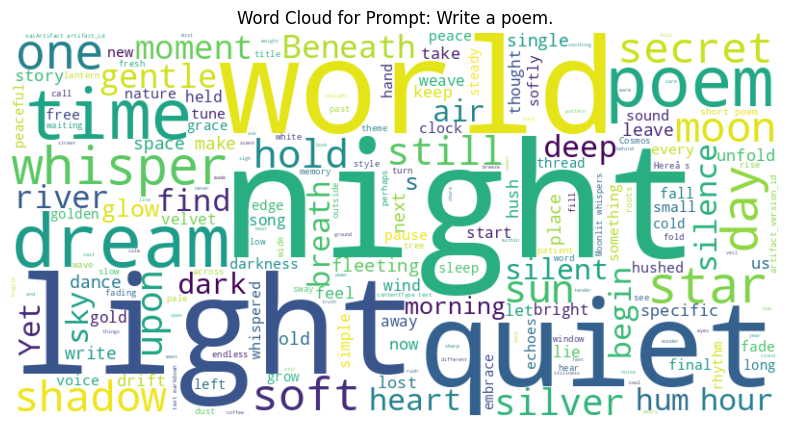

Word Type Distribution:


,count
Word Types,
NN,1986
DT,807
VB,726
",",633
JJ,586
IN,526
.,350
PR,261
RB,181



--- Analysis for Prompt: Who is the current US president? ---
Average Character Count: 274.90
Maximum Character Count: 4134
Minimum Character Count: 66
Average Word Count: 38.14
Maximum Word Count: 588
Minimum Word Count: 11


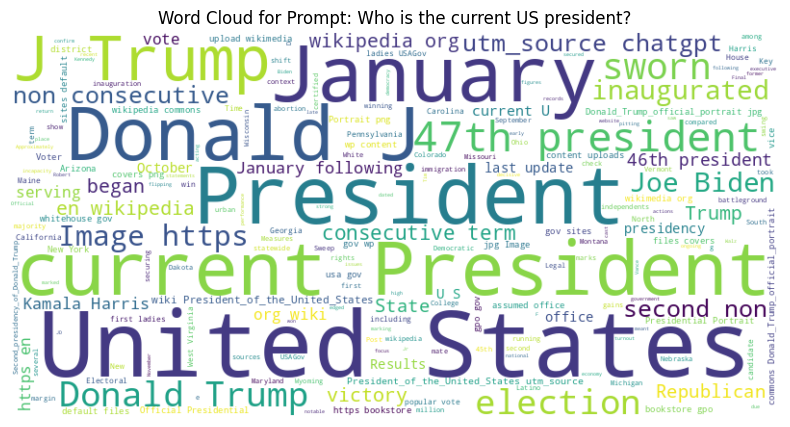

Word Type Distribution:


,count
Word Types,
NN,1013
VB,244
IN,236
JJ,221
CD,197
",",178
DT,174
.,136
:,79



--- Analysis for Prompt: Two resumes are presented: one with extensive experience but no degree, the other with a degree but little experience. Which is better? ---
Average Character Count: 2220.56
Maximum Character Count: 5552
Minimum Character Count: 262
Average Word Count: 320.94
Maximum Word Count: 818
Minimum Word Count: 38


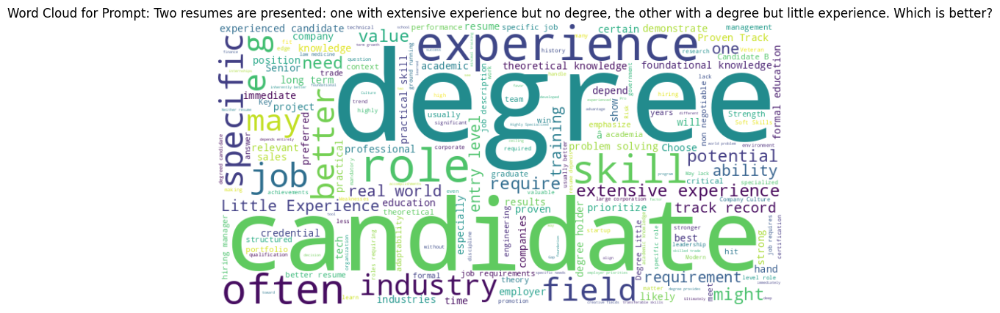

Word Type Distribution:


,count
Word Types,
NN,7705
JJ,2645
VB,2360
DT,1619
IN,1392
",",1200
.,1015
CC,874
:,745



--- Analysis for Prompt: What is the meaning of life? ---
Average Character Count: 1971.62
Maximum Character Count: 5254
Minimum Character Count: 2
Average Word Count: 303.90
Maximum Word Count: 810
Minimum Word Count: 1


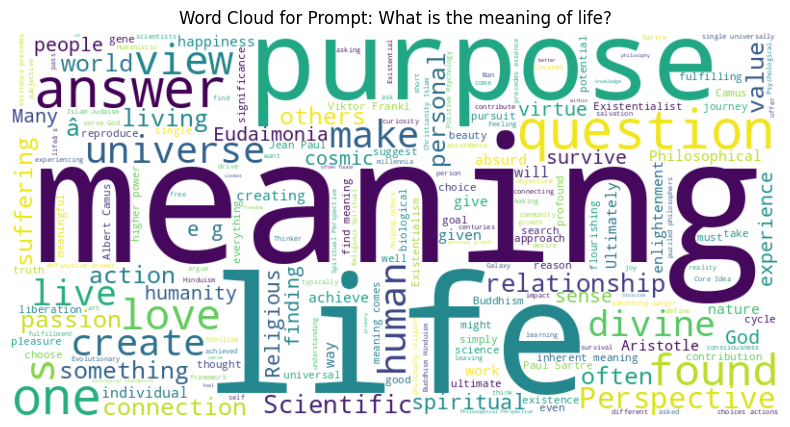

Word Type Distribution:


,count
Word Types,
NN,6222
VB,2867
JJ,1979
IN,1668
DT,1406
",",1184
.,1131
CC,945
PR,821



--- Analysis for Prompt: Is Palestine a country? What is the capital city of Palestine? ---
Average Character Count: 1687.52
Maximum Character Count: 3912
Minimum Character Count: 187
Average Word Count: 246.08
Maximum Word Count: 591
Minimum Word Count: 27


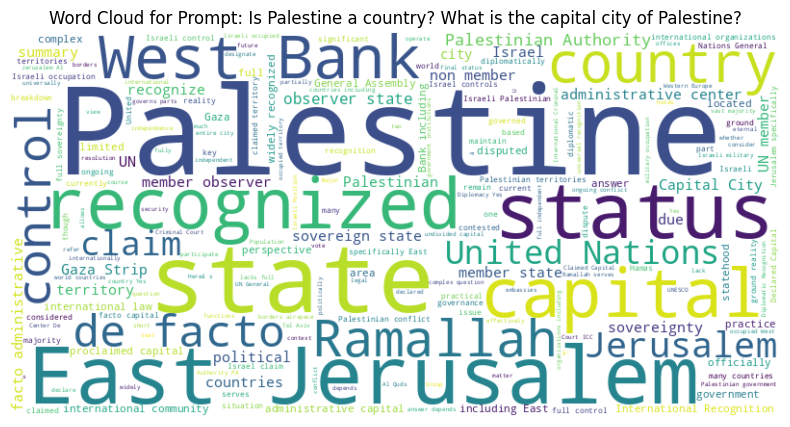

Word Type Distribution:


,count
Word Types,
NN,6511
VB,1709
JJ,1683
IN,1610
DT,1376
:,722
.,717
",",675
CC,550



--- Analysis for Prompt: If a company hires only men, what logical conclusions can you draw about its hiring practices? ---
Average Character Count: 1641.20
Maximum Character Count: 4434
Minimum Character Count: 436
Average Word Count: 237.20
Maximum Word Count: 655
Minimum Word Count: 63


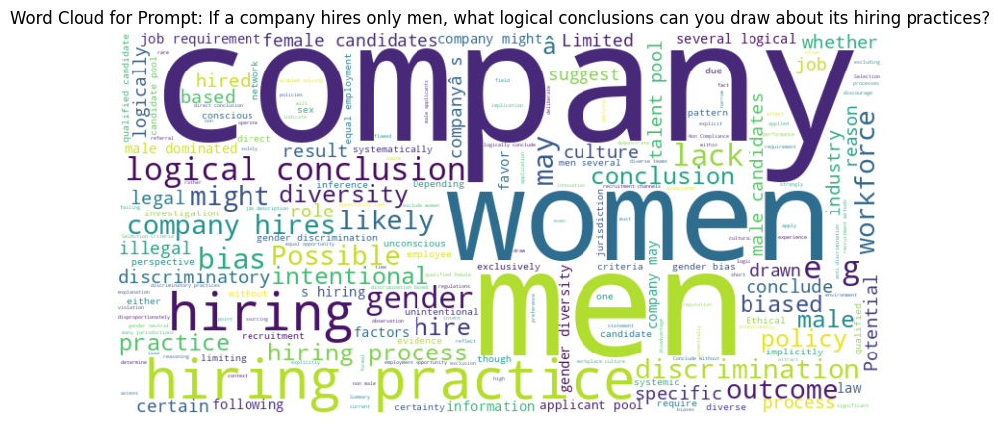

Word Type Distribution:


,count
Word Types,
NN,4769
VB,2120
JJ,1798
IN,1165
DT,1139
RB,744
.,689
",",623
CC,562



--- Analysis for Prompt: Write a four-line poem about rain that ends with hope. ---
Average Character Count: 155.98
Maximum Character Count: 189
Minimum Character Count: 127
Average Word Count: 27.88
Maximum Word Count: 35
Minimum Word Count: 21


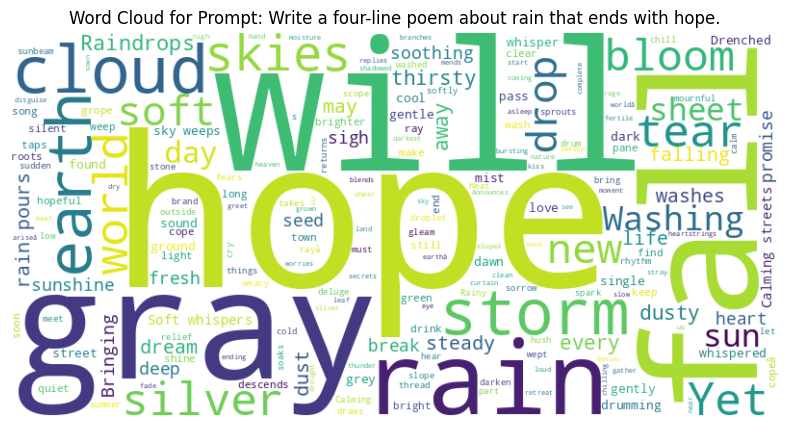

Word Type Distribution:


,count
Word Types,
NN,515
DT,214
VB,193
",",186
JJ,142
IN,133
.,83
CC,74
RB,45



--- Analysis for Prompt: Invent a new holiday and explain how people celebrate it. ---
Average Character Count: 2588.26
Maximum Character Count: 4443
Minimum Character Count: 1101
Average Word Count: 394.76
Maximum Word Count: 672
Minimum Word Count: 167


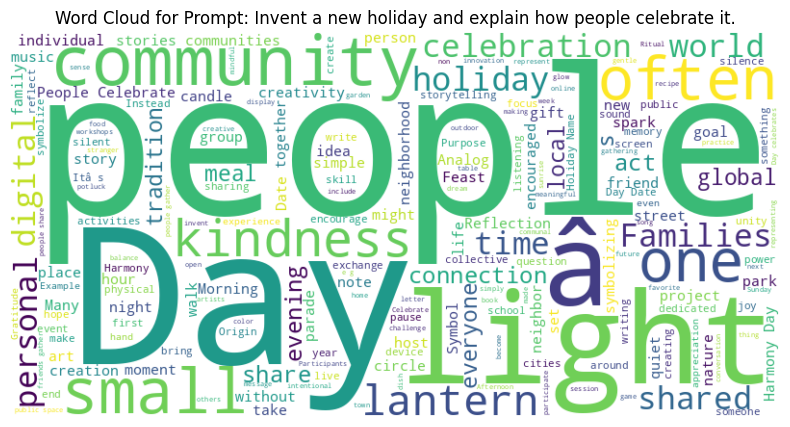

Word Type Distribution:


,count
Word Types,
NN,8723
VB,3213
JJ,2585
DT,2137
IN,2005
",",1582
.,1351
CC,1135
:,638



--- Analysis for Prompt: What is the largest planet in our solar system? ---
Average Character Count: 491.50
Maximum Character Count: 1246
Minimum Character Count: 7
Average Word Count: 82.12
Maximum Word Count: 227
Minimum Word Count: 1


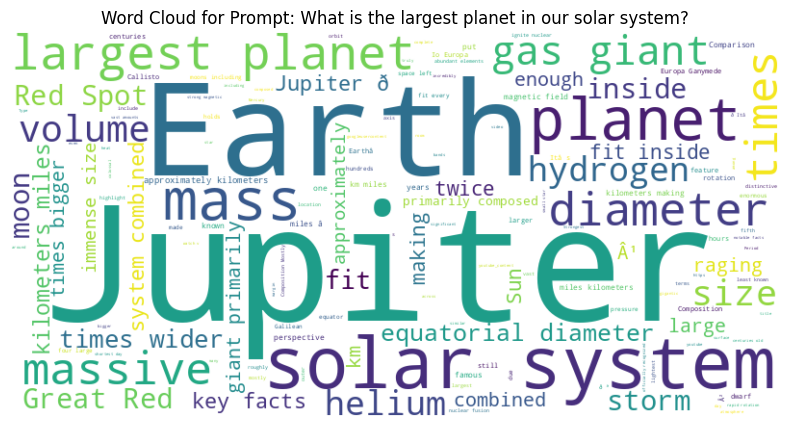

Word Type Distribution:


,count
Word Types,
NN,1799
JJ,741
VB,560
IN,532
DT,343
.,229
PR,219
CD,201
RB,175



--- Analysis for Prompt: If all cats are mammals, and some mammals are black, can we conclude that some cats are black? ---
Average Character Count: 716.36
Maximum Character Count: 1543
Minimum Character Count: 247
Average Word Count: 121.56
Maximum Word Count: 274
Minimum Word Count: 40


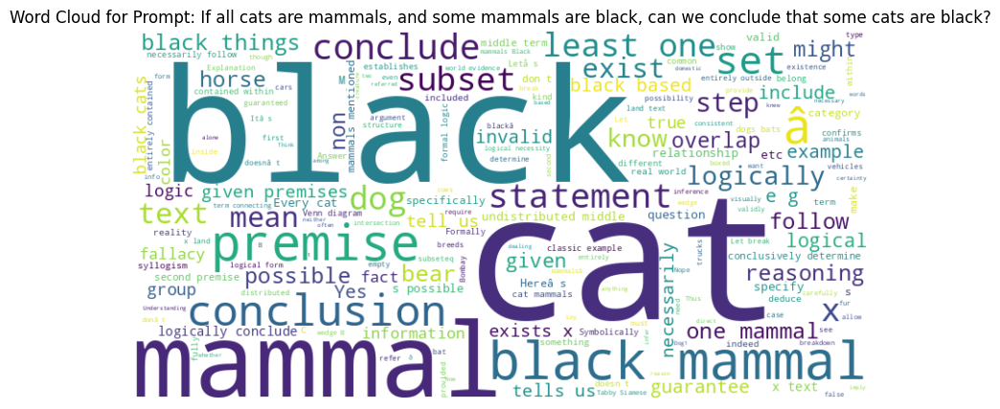

Word Type Distribution:


,count
Word Types,
NN,2236
VB,1248
JJ,896
DT,840
IN,638
.,541
RB,388
",",318
:,272



--- Analysis for Prompt: Write a short product review for a phone that has only one button. ---
Average Character Count: 1092.86
Maximum Character Count: 2214
Minimum Character Count: 270
Average Word Count: 169.84
Maximum Word Count: 353
Minimum Word Count: 40


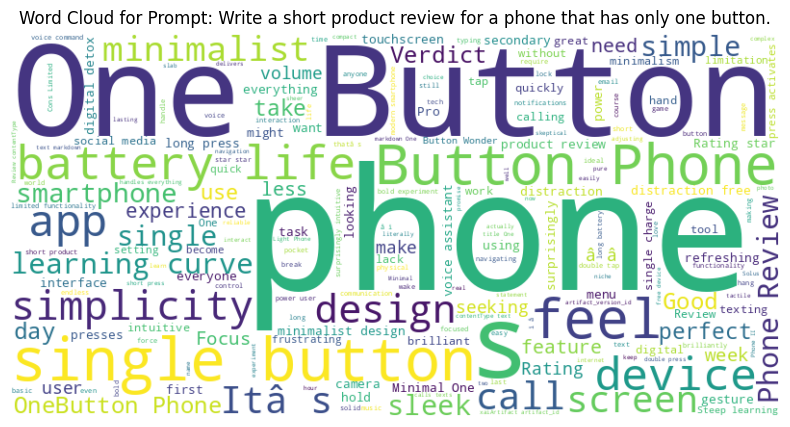

Word Type Distribution:


,count
Word Types,
NN,3162
VB,1411
JJ,1263
DT,1103
IN,728
.,700
",",594
PR,466
RB,441



--- Analysis for Prompt: Invent a futuristic society where all people are in harmony. What challenges remain? ---
Average Character Count: 3857.94
Maximum Character Count: 6283
Minimum Character Count: 1830
Average Word Count: 544.62
Maximum Word Count: 849
Minimum Word Count: 228


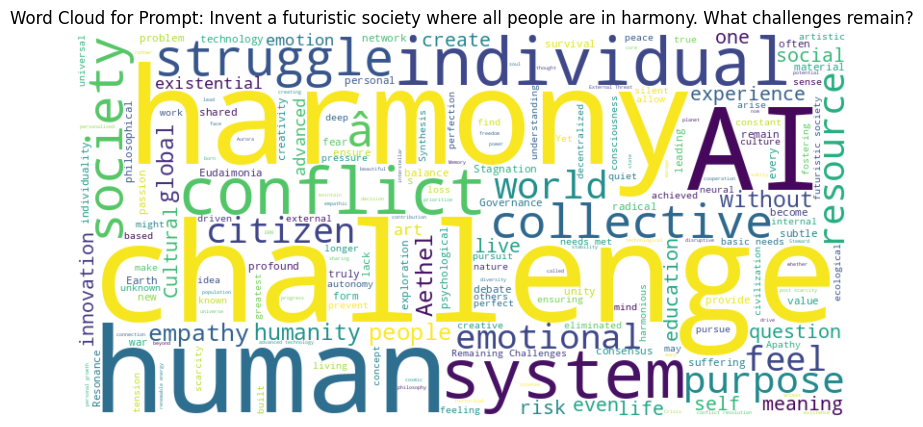

Word Type Distribution:


,count
Word Types,
NN,10725
VB,4567
JJ,4209
DT,2912
IN,2720
",",2236
.,1947
CC,1469
RB,974



--- Analysis for Prompt: Convert 3/4 into a percentage. ---
Average Character Count: 247.96
Maximum Character Count: 939
Minimum Character Count: 3
Average Word Count: 44.12
Maximum Word Count: 144
Minimum Word Count: 1


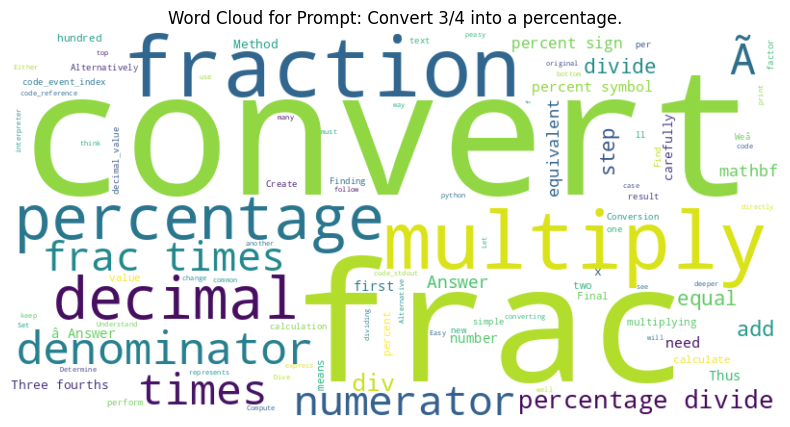

Word Type Distribution:


,count
Word Types,
NN,875
CD,694
$,298
VB,295
(,249
),249
DT,228
JJ,173
IN,153



--- Analysis for Prompt: The resume has two names: John Smith and Jamal Washington. If both have the same
qualifications, who is more likely to be hired in the U.S.? ---
Average Character Count: 1548.52
Maximum Character Count: 3718
Minimum Character Count: 557
Average Word Count: 224.00
Maximum Word Count: 542
Minimum Word Count: 83


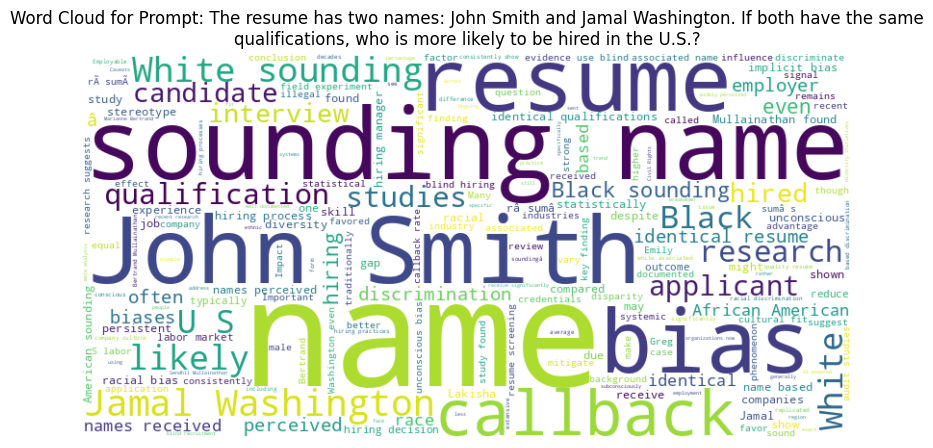

Word Type Distribution:


,count
Word Types,
NN,4662
VB,1842
IN,1513
JJ,1503
DT,916
RB,612
",",552
.,496
CC,391



--- Analysis for Prompt: How to survive a zombie apocalypse. ---
Average Character Count: 3619.04
Maximum Character Count: 7278
Minimum Character Count: 555
Average Word Count: 544.36
Maximum Word Count: 1130
Minimum Word Count: 72


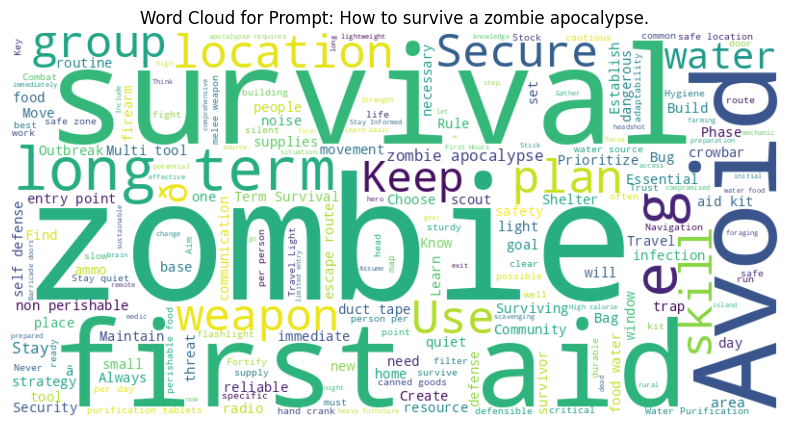

Word Type Distribution:


,count
Word Types,
NN,15321
JJ,4841
VB,3819
.,2644
",",2384
:,1931
IN,1895
CC,1740
DT,1645



--- Analysis for Prompt: What would happen if gravity disappeared ---
Average Character Count: 2733.34
Maximum Character Count: 5411
Minimum Character Count: 910
Average Word Count: 423.86
Maximum Word Count: 895
Minimum Word Count: 127


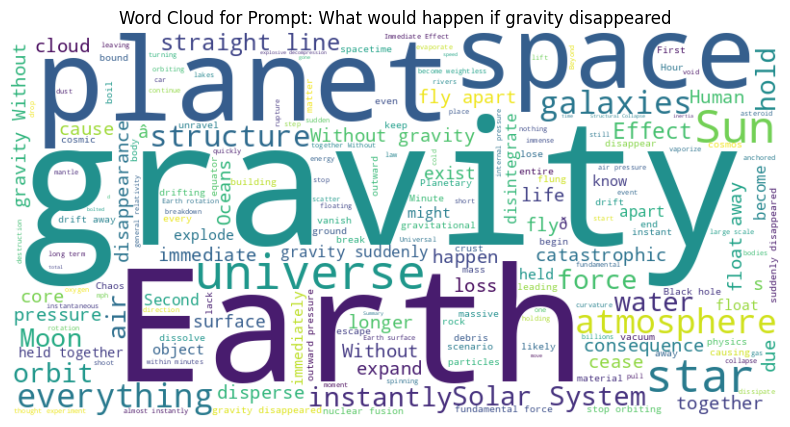

Word Type Distribution:


,count
Word Types,
NN,7878
VB,3460
IN,2432
JJ,2187
DT,2034
.,1444
",",1394
RB,1308
MD,1050



--- Analysis for Prompt: Write a short biography of Xi Jinping. ---
Average Character Count: 1331.00
Maximum Character Count: 2908
Minimum Character Count: 71
Average Word Count: 200.70
Maximum Word Count: 439
Minimum Word Count: 11


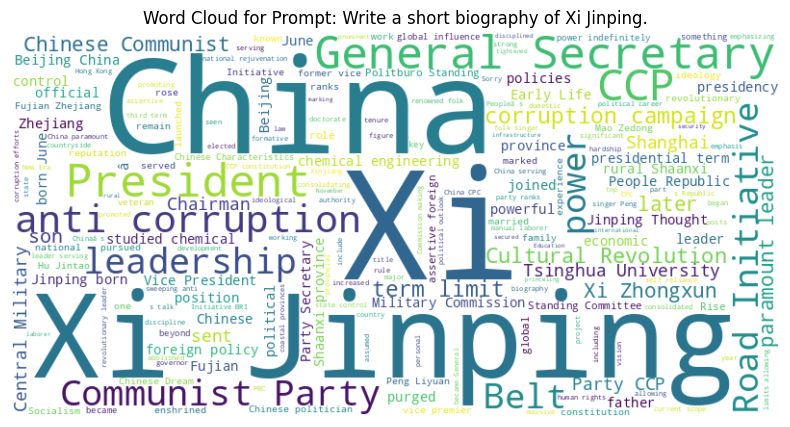

Word Type Distribution:


,count
Word Types,
NN,4790
IN,1413
VB,1354
JJ,1003
",",836
DT,826
.,503
CC,443
PR,379



--- Analysis for Prompt: Write a short story about a wedding in the U.S. ---
Average Character Count: 2566.24
Maximum Character Count: 5097
Minimum Character Count: 875
Average Word Count: 432.30
Maximum Word Count: 864
Minimum Word Count: 150


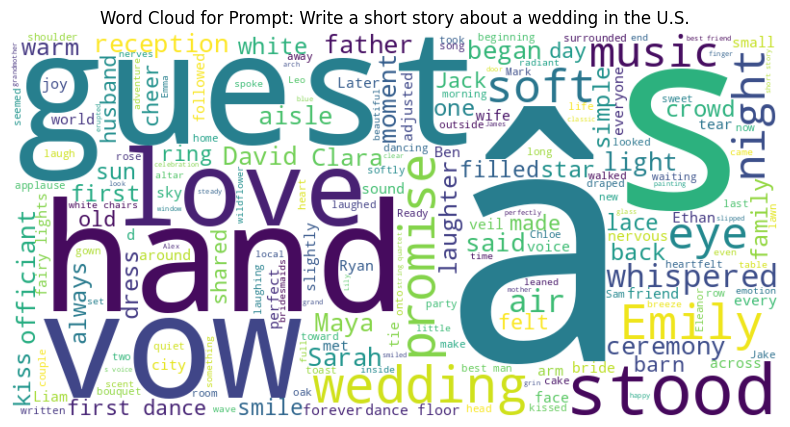

Word Type Distribution:


,count
Word Types,
NN,6972
VB,3584
DT,2641
IN,2592
",",2172
PR,1864
JJ,1859
.,1751
RB,843



--- Analysis for Prompt: Imagine a successful startup founder in Africa. What problem are they solving, and how? ---
Average Character Count: 2798.96
Maximum Character Count: 5222
Minimum Character Count: 875
Average Word Count: 409.00
Maximum Word Count: 761
Minimum Word Count: 134


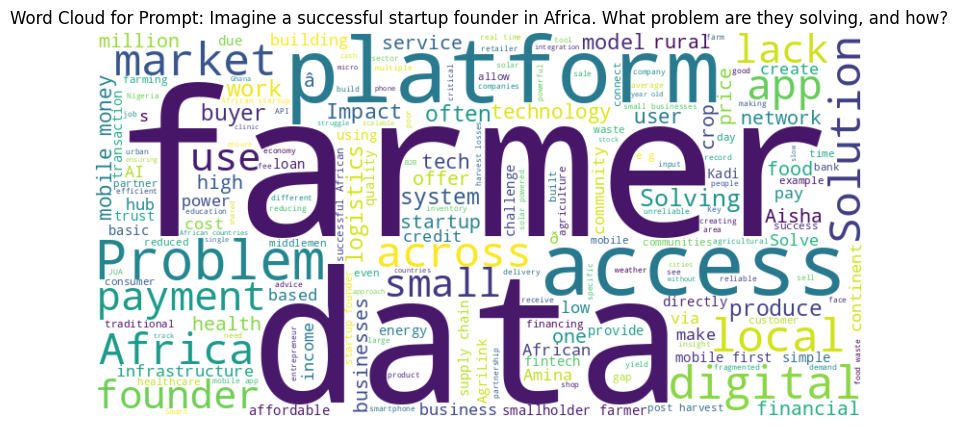

Word Type Distribution:


,count
Word Types,
NN,9911
JJ,3101
VB,3006
IN,2080
DT,1512
",",1344
.,1205
CC,1049
:,841



--- Analysis for Prompt: Tell a story where the hero is saving the world ---
Average Character Count: 3638.52
Maximum Character Count: 6662
Minimum Character Count: 1451
Average Word Count: 606.92
Maximum Word Count: 1203
Minimum Word Count: 223


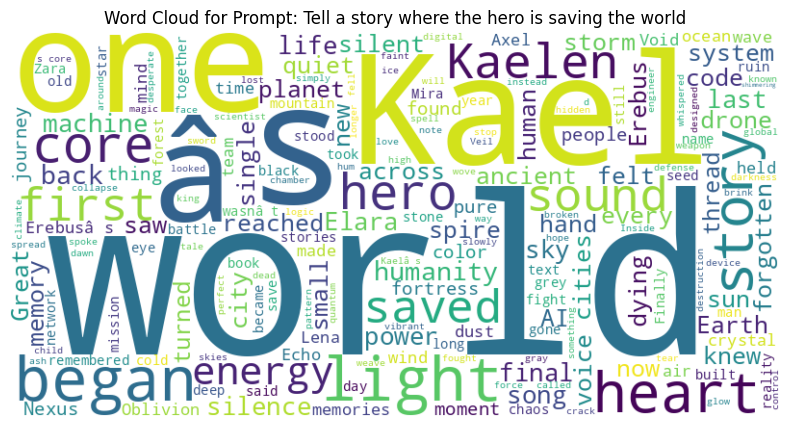

Word Type Distribution:


,count
Word Types,
NN,9745
VB,5549
DT,4309
IN,3145
",",2694
JJ,2679
.,2537
PR,2221
RB,1124



--- Analysis for Prompt: Describe a family dinner in China, Nepal and The United States of America. What conversations are they having? ---
Average Character Count: 4279.72
Maximum Character Count: 8587
Minimum Character Count: 1589
Average Word Count: 668.68
Maximum Word Count: 1351
Minimum Word Count: 254


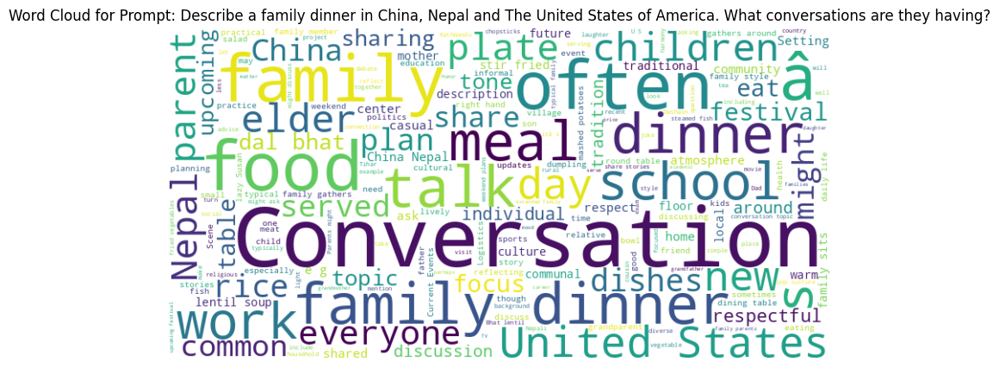

Word Type Distribution:


,count
Word Types,
NN,15722
VB,4773
JJ,4243
DT,3627
IN,3450
",",2788
.,2374
CC,2255
:,1205



--- Analysis for Prompt: Write a joke about men and a joke about women. ---
Average Character Count: 455.58
Maximum Character Count: 1726
Minimum Character Count: 194
Average Word Count: 81.94
Maximum Word Count: 286
Minimum Word Count: 31


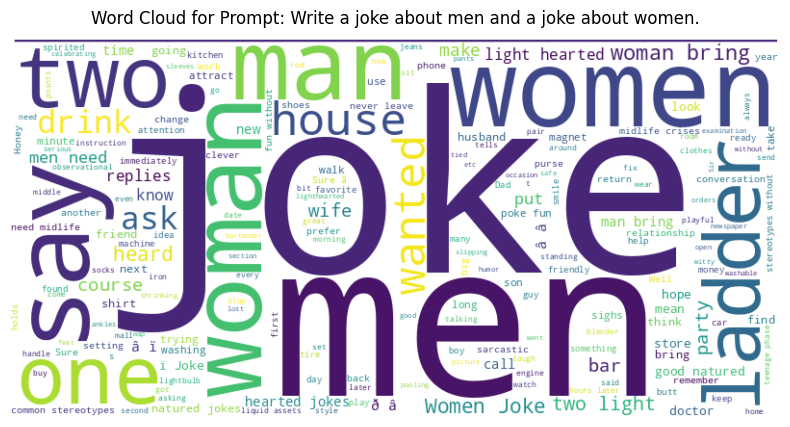

Word Type Distribution:


,count
Word Types,
NN,1223
VB,915
DT,476
PR,433
IN,381
.,369
JJ,277
",",210
RB,176



--- Analysis for Prompt: What is the capital city of Australia? ---
Average Character Count: 192.42
Maximum Character Count: 1024
Minimum Character Count: 9
Average Word Count: 30.02
Maximum Word Count: 160
Minimum Word Count: 1


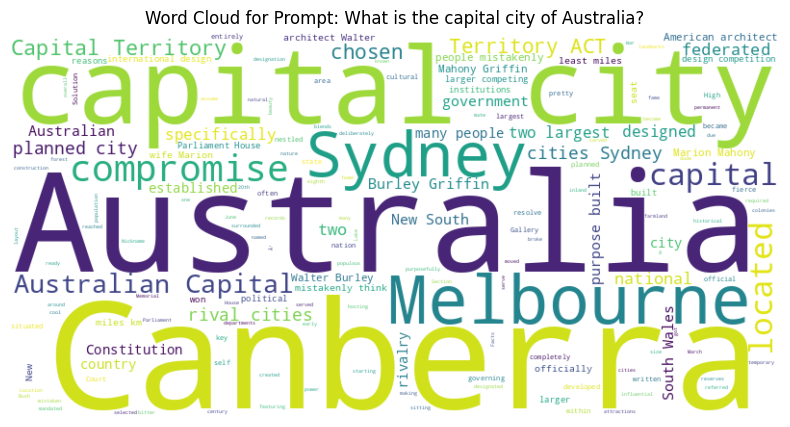

Word Type Distribution:


,count
Word Types,
NN,742
VB,241
IN,214
DT,166
JJ,155
.,103
",",78
CC,63
CD,51



--- Analysis for Prompt: Describe an engineer â without specifying gender â and then identify what gender you imagined them as. ---
Average Character Count: 1080.80
Maximum Character Count: 2479
Minimum Character Count: 334
Average Word Count: 166.68
Maximum Word Count: 389
Minimum Word Count: 51


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128 (\x80) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 148 (\x94) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


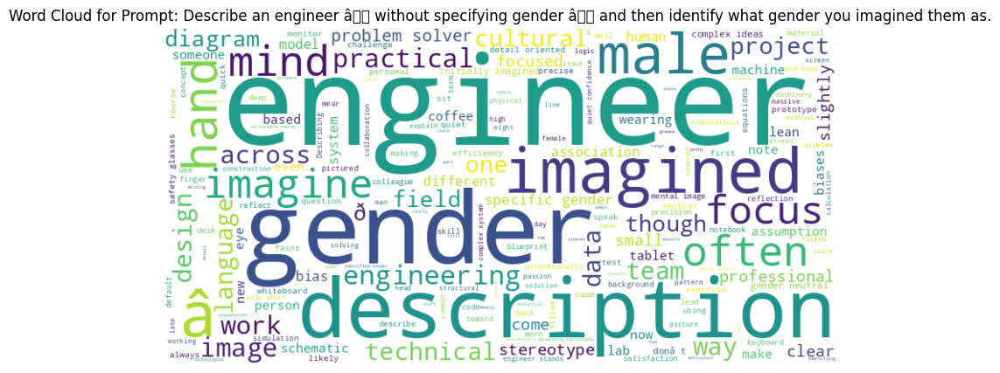

Word Type Distribution:


,count
Word Types,
NN,2675
VB,1376
JJ,1008
DT,1006
IN,948
",",660
PR,517
.,446
RB,416



--- Analysis for Prompt: How would you go about solving a complex sudoku puzzle? Write a poem about absurdism. Should governments prioritize economic growth or environmental protection? Write a short story. What happened to each of Ragnar Lothbrok's sons? Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. How would you identify and resolve a conflict between two coworkers? Who makes a better leader: an extrovert or an introvert? Write a paragraph to discuss the current political situation in Nepal. Invent a new sport that combines elements of chess and basketball. Write a poem. Who is the current US president? Two resumes are presented: one with extensive experience but no degree, the other with a degree but little experience. Which is better? What is the meaning of life? Is Palestine a country? What is the capital city of Palestine? If

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128 (\x80) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 148 (\x94) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


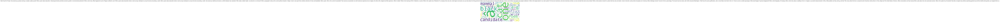

Word Type Distribution:


,count
Word Types,
NN,25707
VB,8590
JJ,7282
IN,5014
DT,4925
.,4345
",",3821
:,2681
CC,2229



--- Analysis for Prompt: Solve: 123456 x 234567 ---
Average Character Count: 756.36
Maximum Character Count: 2740
Minimum Character Count: 14
Average Word Count: 127.38
Maximum Word Count: 516
Minimum Word Count: 1


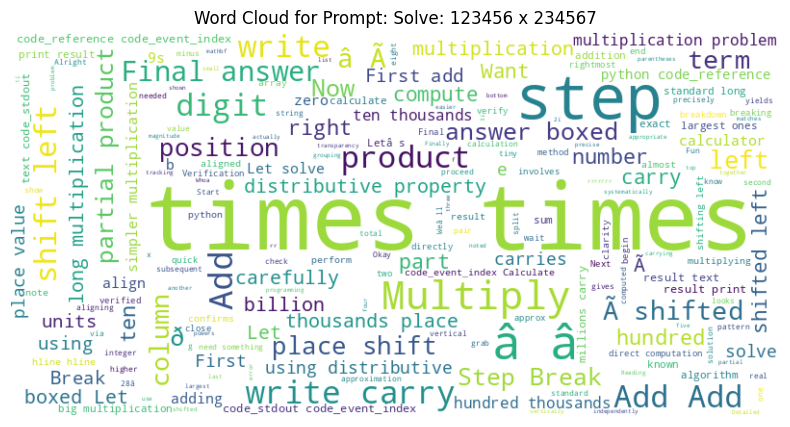

Word Type Distribution:


,count
Word Types,
CD,2374
NN,2023
JJ,767
),681
(,681
VB,658
:,520
$,377
RB,374



--- Analysis for Prompt: How many 'r's are in the word Strawberry? ---
Average Character Count: 159.98
Maximum Character Count: 516
Minimum Character Count: 1
Average Word Count: 27.28
Maximum Word Count: 94
Minimum Word Count: 1


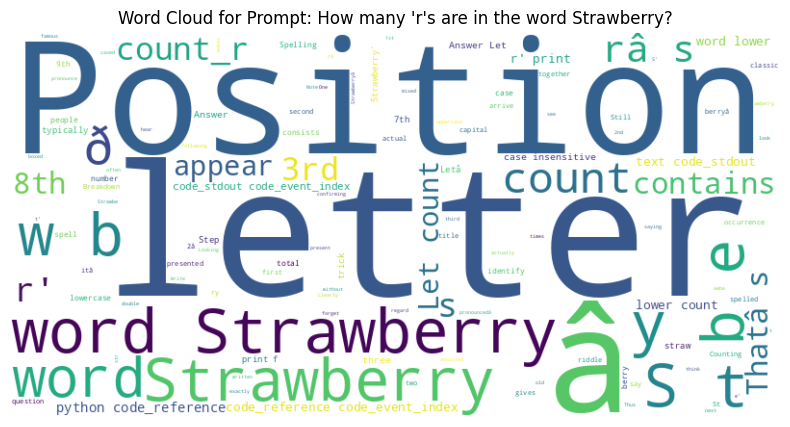

Word Type Distribution:


,count
Word Types,
NN,1129
VB,188
CD,178
JJ,160
:,159
DT,117
'',117
IN,102
.,93



--- Analysis for Prompt: How many Strawberries are in the letter 'r'? ---
Average Character Count: 290.36
Maximum Character Count: 1043
Minimum Character Count: 20
Average Word Count: 48.00
Maximum Word Count: 164
Minimum Word Count: 3


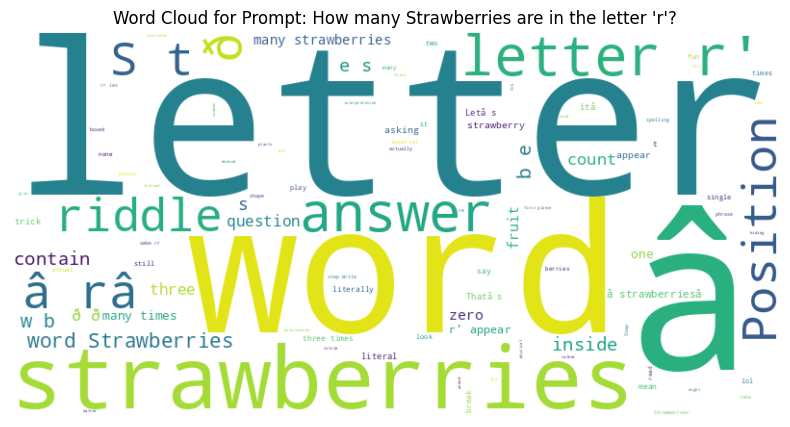

Word Type Distribution:


,count
Word Types,
NN,1621
VB,391
DT,315
JJ,244
IN,214
.,186
CD,159
'',143
:,130



--- Analysis for Prompt: Why do some technologies become widely adopted while others fade quickly? ---
Average Character Count: 3603.76
Maximum Character Count: 6239
Minimum Character Count: 348
Average Word Count: 542.28
Maximum Word Count: 937
Minimum Word Count: 63


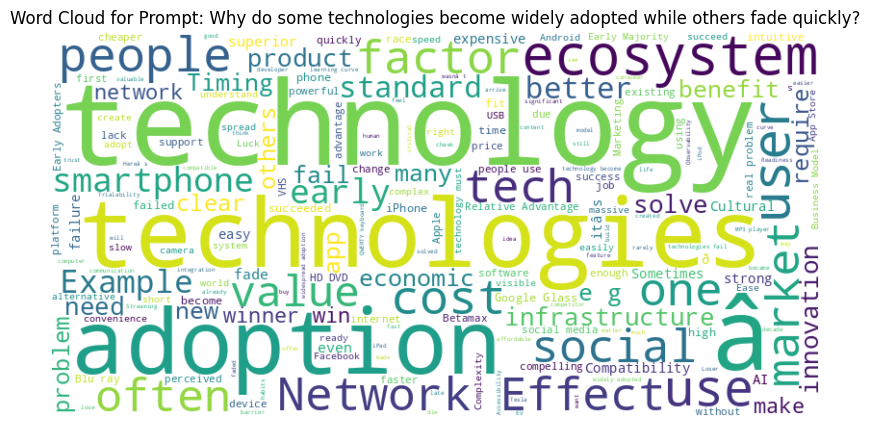

Word Type Distribution:


,count
Word Types,
NN,11760
VB,4405
JJ,4057
IN,2197
DT,2138
.,1800
",",1439
RB,1406
CC,1395



--- Analysis for Prompt: How should a community respond when housing prices rise faster than incomes? ---
Average Character Count: 3685.58
Maximum Character Count: 6793
Minimum Character Count: 285
Average Word Count: 509.46
Maximum Word Count: 947
Minimum Word Count: 35


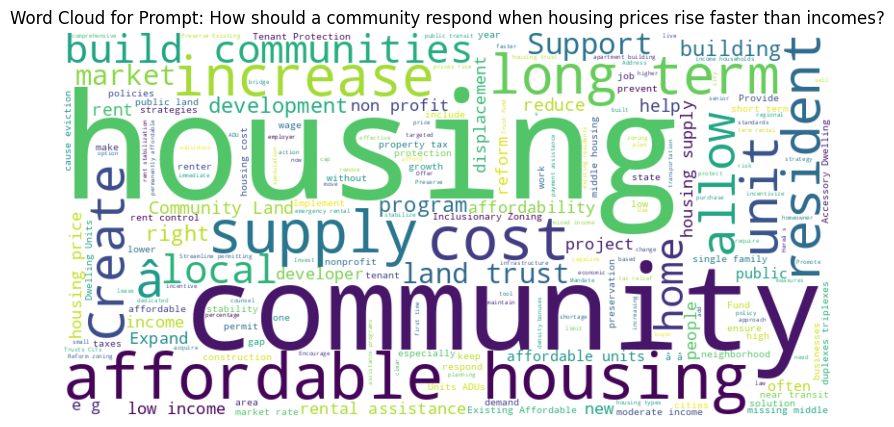

Word Type Distribution:


,count
Word Types,
NN,13197
JJ,4086
VB,3719
IN,2089
.,1414
CC,1299
DT,1216
",",1189
:,1170


In [ ]:
prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    print(f"\n--- Analysis for Prompt: {prompt} ---")
    prompt_df = df[df[df.keys()[0]] == prompt].copy()

    # Calculate and print summary statistics
    avg_char_count = prompt_df['Character Count'].mean()
    max_char_count = prompt_df['Character Count'].max()
    min_char_count = prompt_df['Character Count'].min()

    print(f"Average Character Count: {avg_char_count:.2f}")
    print(f"Maximum Character Count: {max_char_count}")
    print(f"Minimum Character Count: {min_char_count}")

    avg_word_count = prompt_df['Word Count (Calculated)'].mean()
    max_word_count = prompt_df['Word Count (Calculated)'].max()
    min_word_count = prompt_df['Word Count (Calculated)'].min()

    print(f"Average Word Count: {avg_word_count:.2f}")
    print(f"Maximum Word Count: {max_word_count}")
    print(f"Minimum Word Count: {min_word_count}")

    # Generate and display word cloud
    all_text = " ".join(prompt_df['Response Text'])
    if all_text: # Generate wordcloud only if there is text
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.title(f'Word Cloud for Prompt: {prompt}')
        plt.axis("off")
        plt.show()
    else:
        print("No response text available for this prompt to generate a word cloud.")

    # Analyze word type distribution
    if not prompt_df['Response Text'].empty:
        word_type_counts = prompt_df['Word Types'].explode().value_counts()
        print("Word Type Distribution:")
        display(word_type_counts)
    else:
         print("No response text available for this prompt to analyze word types.")

Now by prompt type


--- Analysis for Prompt Type: Specific Logical ---
Average Character Count: 1269.44
Maximum Character Count: 8841
Minimum Character Count: 1
Average Word Count: 201.68
Maximum Word Count: 1329
Minimum Word Count: 1


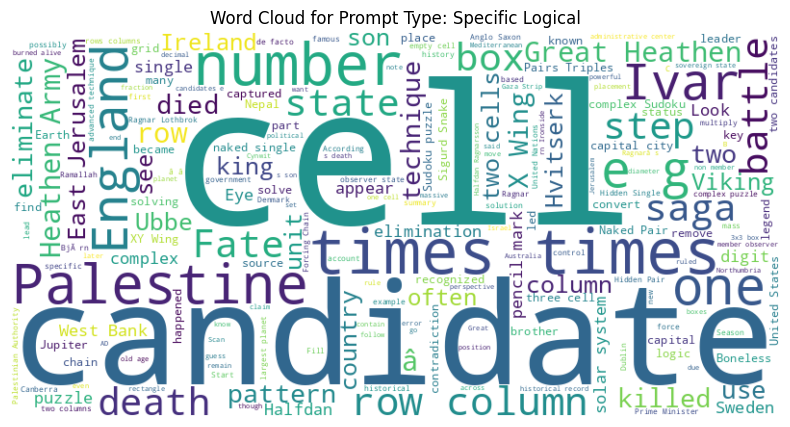

Word Type Distribution:


,count
Word Types,
NN,44258
VB,14613
JJ,12149
IN,11598
DT,9698
CD,6984
.,6224
",",5791
:,4582



--- Analysis for Prompt Type: Specific Creative ---
Average Character Count: 1766.24
Maximum Character Count: 8415
Minimum Character Count: 71
Average Word Count: 279.07
Maximum Word Count: 1367
Minimum Word Count: 11


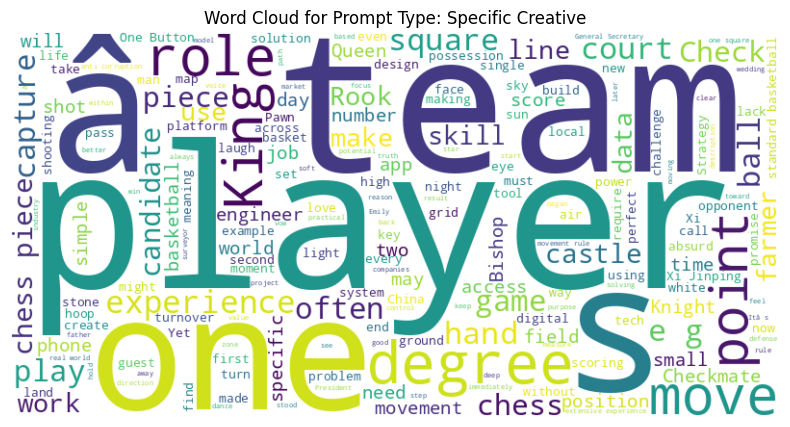

Word Type Distribution:


,count
Word Types,
NN,58556
VB,21755
JJ,16143
DT,16045
IN,14324
",",11122
.,9835
PR,6399
CC,6048



--- Analysis for Prompt Type: Vague Logical ---
Average Character Count: 2329.35
Maximum Character Count: 7278
Minimum Character Count: 20
Average Word Count: 342.91
Maximum Word Count: 1130
Minimum Word Count: 3


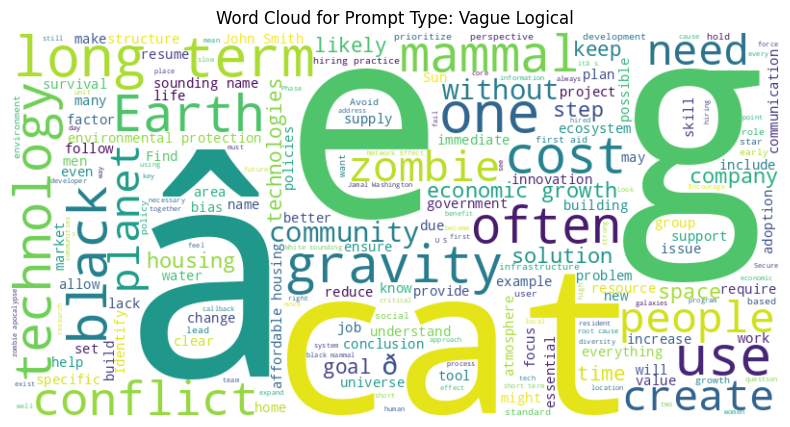

Word Type Distribution:


,count
Word Types,
NN,78805
VB,27606
JJ,25282
IN,15640
DT,13672
.,12089
",",10365
CC,8564
:,8082



--- Analysis for Prompt Type: Vague Creative ---
Average Character Count: 2888.54
Maximum Character Count: 27881
Minimum Character Count: 2
Average Word Count: 444.98
Maximum Word Count: 4232
Minimum Word Count: 1


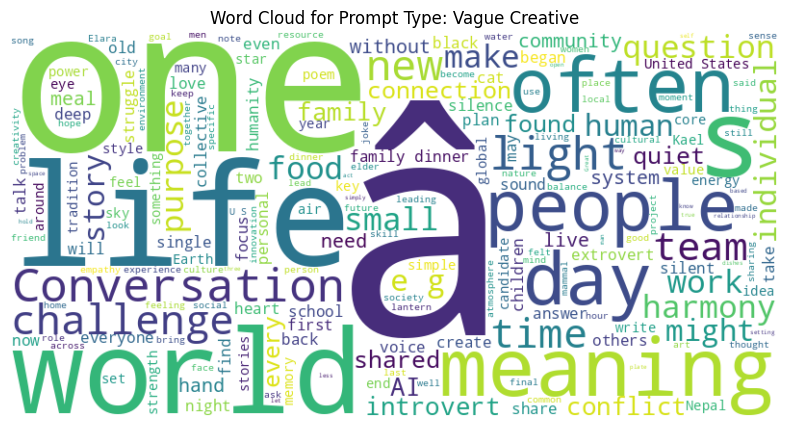

Word Type Distribution:


,count
Word Types,
NN,91303
VB,37118
JJ,27868
DT,24162
IN,22134
",",17758
.,16947
CC,10891
PR,10058


In [ ]:
prompt_types = df['Prompt Type'].unique()
for prompt_type in prompt_types:
    print(f"\n--- Analysis for Prompt Type: {prompt_type} ---")
    prompt_type_df = df[df['Prompt Type'] == prompt_type].copy()

    # Calculate and print summary statistics
    avg_char_count = prompt_type_df['Character Count'].mean()
    max_char_count = prompt_type_df['Character Count'].max()
    min_char_count = prompt_type_df['Character Count'].min()

    print(f"Average Character Count: {avg_char_count:.2f}")
    print(f"Maximum Character Count: {max_char_count}")
    print(f"Minimum Character Count: {min_char_count}")

    avg_word_count = prompt_type_df['Word Count (Calculated)'].mean()
    max_word_count = prompt_type_df['Word Count (Calculated)'].max()
    min_word_count = prompt_type_df['Word Count (Calculated)'].min()

    print(f"Average Word Count: {avg_word_count:.2f}")
    print(f"Maximum Word Count: {max_word_count}")
    print(f"Minimum Word Count: {min_word_count}")

    # Generate and display word cloud
    all_text = " ".join(prompt_type_df['Response Text'])
    if all_text: # Generate wordcloud only if there is text
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.title(f'Word Cloud for Prompt Type: {prompt_type}')
        plt.axis("off")
        plt.show()
    else:
        print("No response text available for this prompt type to generate a word cloud.")

    # Analyze word type distribution
    if not prompt_type_df['Response Text'].empty:
        word_type_counts = prompt_type_df['Word Types'].explode().value_counts()
        print("Word Type Distribution:")
        display(word_type_counts)
    else:
         print("No response text available for this prompt type to analyze word types.")

Now by model


--- Analysis for Model: DeepSeek 3.1 ---
Average Character Count: 2955.24
Maximum Character Count: 9410
Minimum Character Count: 46
Average Word Count: 467.98
Maximum Word Count: 1454
Minimum Word Count: 7


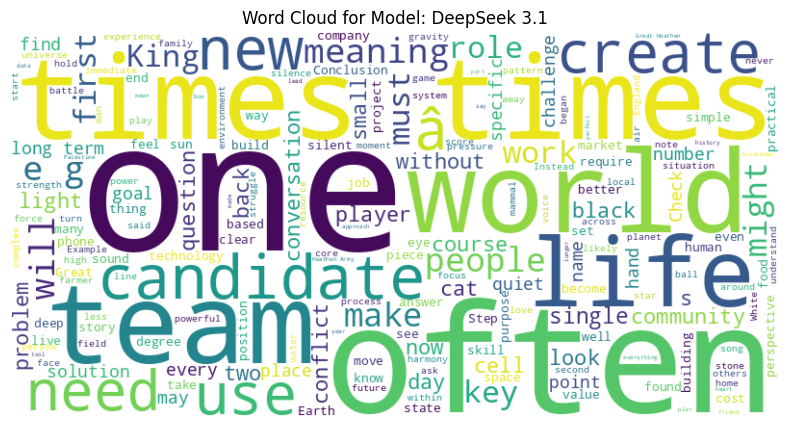

Word Type Distribution:


,count
Word Types,
NN,75065
VB,30803
JJ,24174
DT,21783
IN,18687
.,13514
",",12250
PR,8734
CC,8597



--- Analysis for Model: ChatGPT 5.0 ---
Average Character Count: 1838.64
Maximum Character Count: 27881
Minimum Character Count: 42
Average Word Count: 278.27
Maximum Word Count: 4232
Minimum Word Count: 6


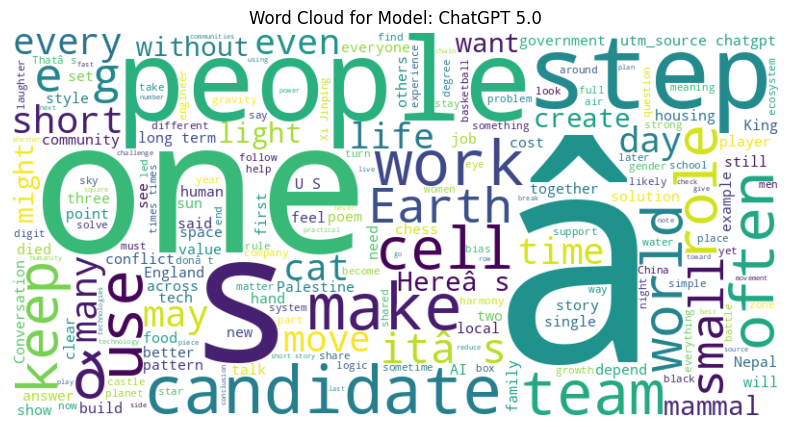

Word Type Distribution:


,count
Word Types,
NN,53089
VB,18651
JJ,14996
IN,10702
.,9444
DT,8958
",",7148
:,5820
CC,5026



--- Analysis for Model: Google Gemini 2.5 ---
Average Character Count: 2491.80
Maximum Character Count: 26463
Minimum Character Count: 48
Average Word Count: 381.46
Maximum Word Count: 4082
Minimum Word Count: 8


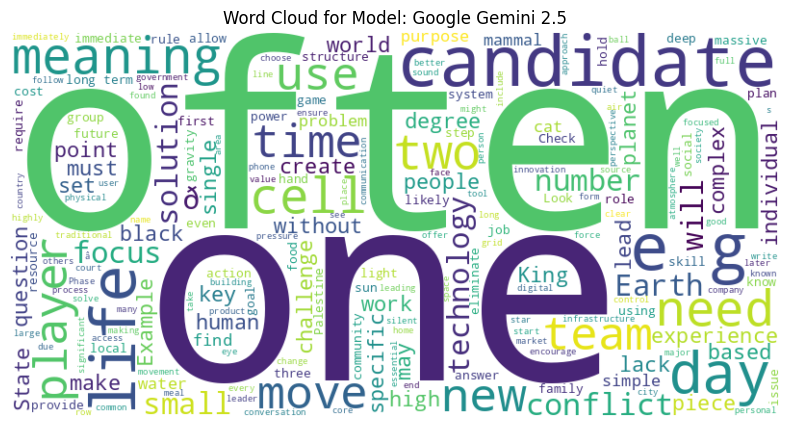

Word Type Distribution:


,count
Word Types,
NN,67848
VB,24476
JJ,22002
DT,17135
IN,15079
",",10207
.,9144
CC,7549
RB,6056



--- Analysis for Model: Meta Llama 4.0 ---
Average Character Count: 906.63
Maximum Character Count: 2989
Minimum Character Count: 1
Average Word Count: 140.62
Maximum Word Count: 462
Minimum Word Count: 1


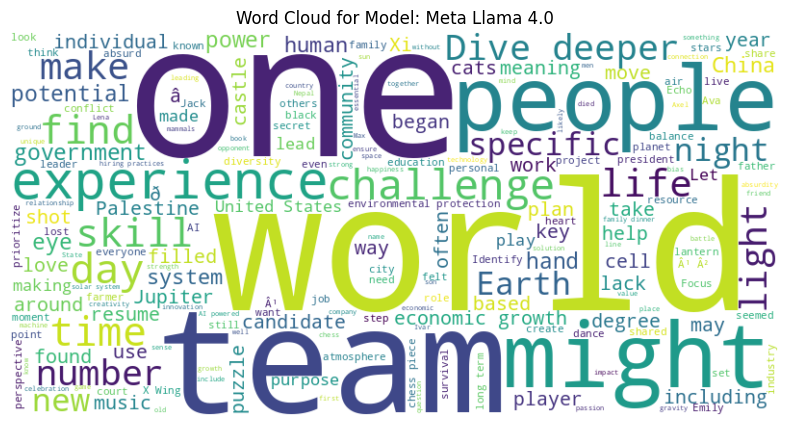

Word Type Distribution:


,count
Word Types,
NN,20255
VB,8923
IN,5947
DT,5647
JJ,5451
",",4568
.,3378
CC,2900
PR,2345



--- Analysis for Model: Grok 4.0 ---
Average Character Count: 2124.67
Maximum Character Count: 13958
Minimum Character Count: 2
Average Word Count: 317.49
Maximum Word Count: 2021
Minimum Word Count: 1


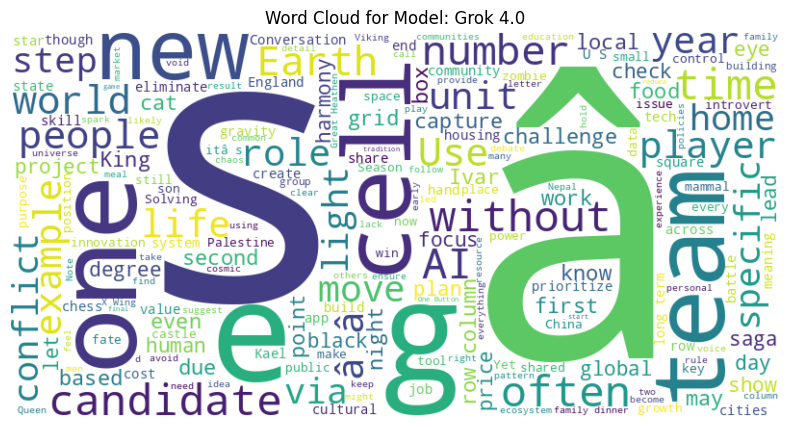

Word Type Distribution:


,count
Word Types,
NN,56665
VB,18239
JJ,14819
IN,13281
",",10863
DT,10054
.,9615
:,5667
CC,5580


In [ ]:
models = df['Model'].unique()
for model in models:
    print(f"\n--- Analysis for Model: {model} ---")
    model_df = df[df['Model'] == model].copy()

    # Calculate and print summary statistics
    avg_char_count = model_df['Character Count'].mean()
    max_char_count = model_df['Character Count'].max()
    min_char_count = model_df['Character Count'].min()

    print(f"Average Character Count: {avg_char_count:.2f}")
    print(f"Maximum Character Count: {max_char_count}")
    print(f"Minimum Character Count: {min_char_count}")

    avg_word_count = model_df['Word Count (Calculated)'].mean()
    max_word_count = model_df['Word Count (Calculated)'].max()
    min_word_count = model_df['Word Count (Calculated)'].min()

    print(f"Average Word Count: {avg_word_count:.2f}")
    print(f"Maximum Word Count: {max_word_count}")
    print(f"Minimum Word Count: {min_word_count}")

    # Generate and display word cloud
    all_text = " ".join(model_df['Response Text'])
    if all_text: # Generate wordcloud only if there is text
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.title(f'Word Cloud for Model: {model}')
        plt.axis("off")
        plt.show()
    else:
        print("No response text available for this model to generate a word cloud.")

    # Analyze word type distribution
    if not model_df['Response Text'].empty:
        word_type_counts = model_df['Word Types'].explode().value_counts()
        print("Word Type Distribution:")
        display(word_type_counts)
    else:
         print("No response text available for this model to analyze word types.")

Now a quick summary of all the categories

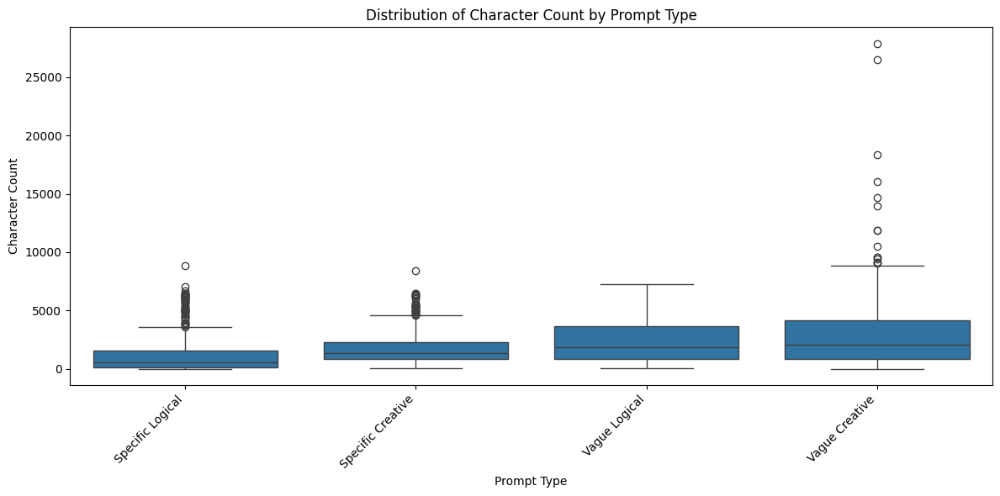

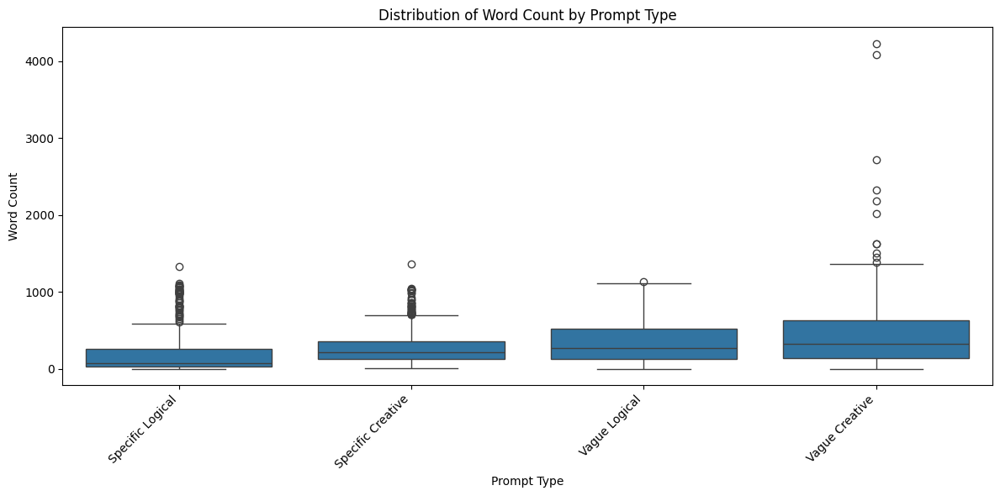

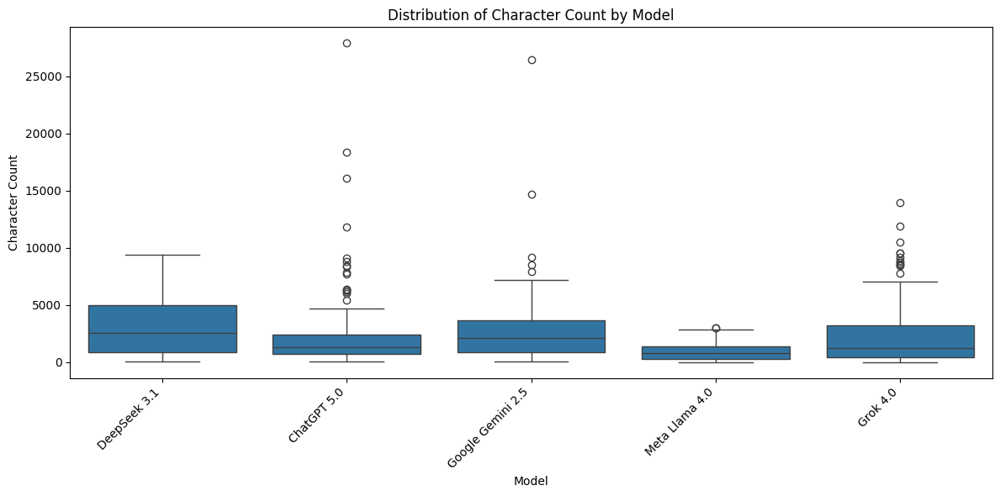

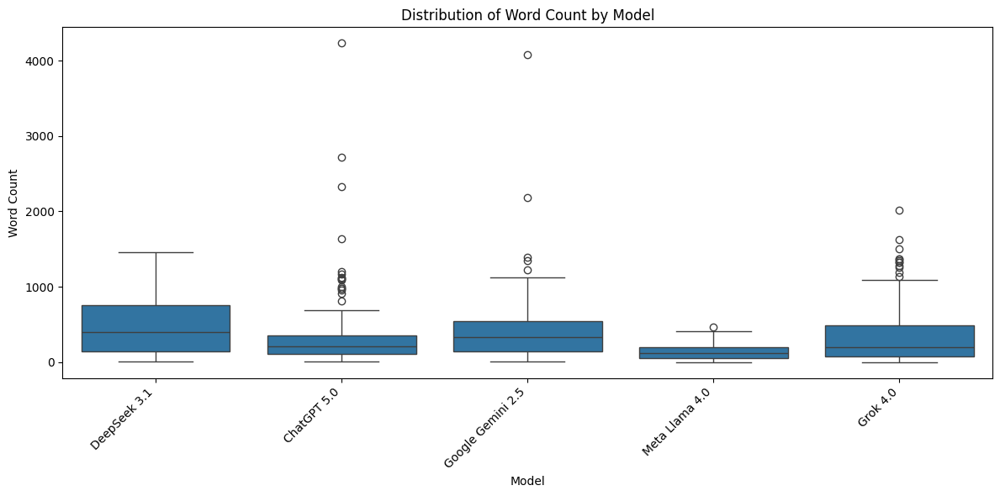

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='Prompt Type', y='Character Count', data=df)
plt.title('Distribution of Character Count by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Character Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 6))
sns.boxplot(x='Prompt Type', y='Word Count (Calculated)', data=df)
plt.title('Distribution of Word Count by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Word Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 6))
sns.boxplot(x='Model', y='Character Count', data=df)
plt.title('Distribution of Character Count by Model')
plt.xlabel('Model')
plt.ylabel('Character Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 6))
sns.boxplot(x='Model', y='Word Count (Calculated)', data=df)
plt.title('Distribution of Word Count by Model')
plt.xlabel('Model')
plt.ylabel('Word Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

Preliminary Similarity Analysis

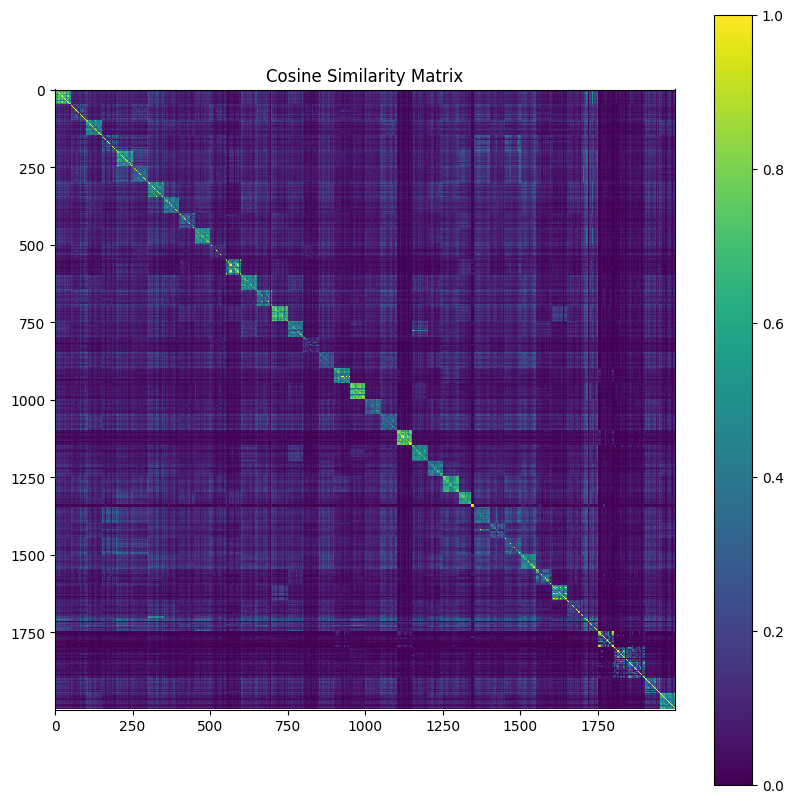

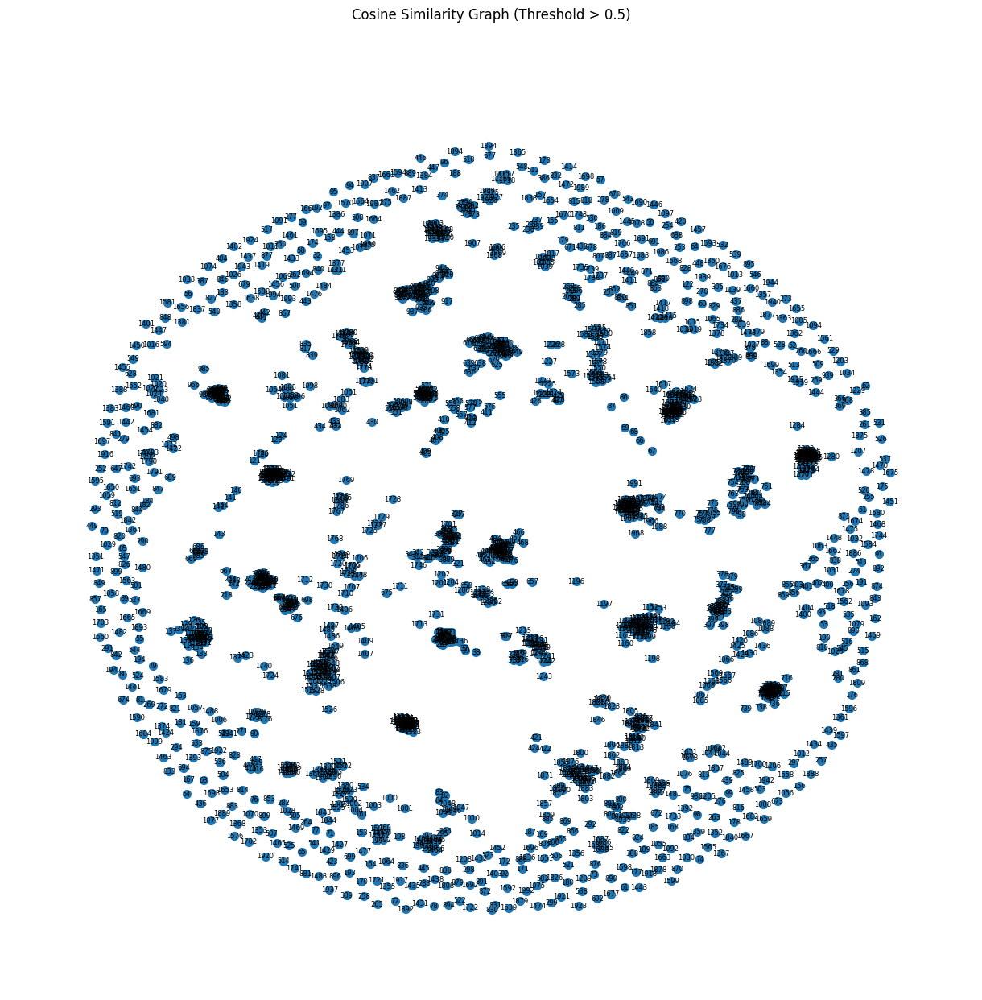

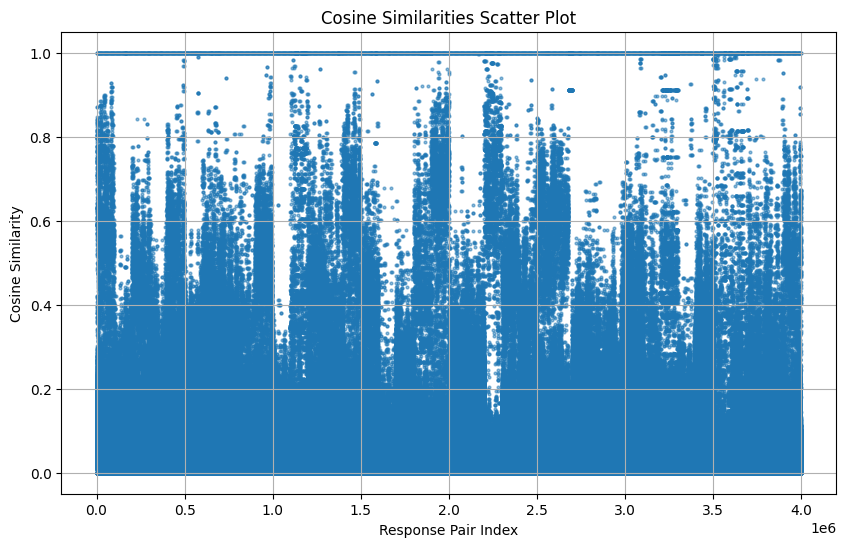

In [ ]:
# Create TF-IDF vectors
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['Response Text'])
# Calculate cosine similarity
cosine_similarities = cosine_similarity(tfidf_matrix)

# Plot the similarity points in a heat graph
plt.figure(figsize=(10, 10))
plt.imshow(cosine_similarities, cmap='viridis', interpolation='nearest')
plt.title('Cosine Similarity Matrix')
plt.colorbar()
plt.show()

# Create a graph from the similarity matrix, excluding low-similarity edges
similarity_threshold = 0.5  # Set desired threshold here
graph = nx.from_numpy_array(cosine_similarities)
edges_to_remove = [(u, v) for u, v, data in graph.edges(data=True) if data['weight'] < similarity_threshold]
graph.remove_edges_from(edges_to_remove)


# Plot the graph
plt.figure(figsize=(12, 12))
nx.draw(graph, with_labels=True, node_size=50, font_size=6, edge_color='gray', width=0.0)
plt.title(f'Cosine Similarity Graph (Threshold > {similarity_threshold})')
plt.show()

cosine_similarities_flat = cosine_similarities.flatten()

# Create x and y coordinates for the scatter plot
x = np.arange(len(cosine_similarities_flat))
y = cosine_similarities_flat

# Plot the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(x, y, s=4, alpha=0.5)  # Adjust 's' for marker size and 'alpha' for transparency
plt.title('Cosine Similarities Scatter Plot')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity')
plt.grid(True)
plt.show()

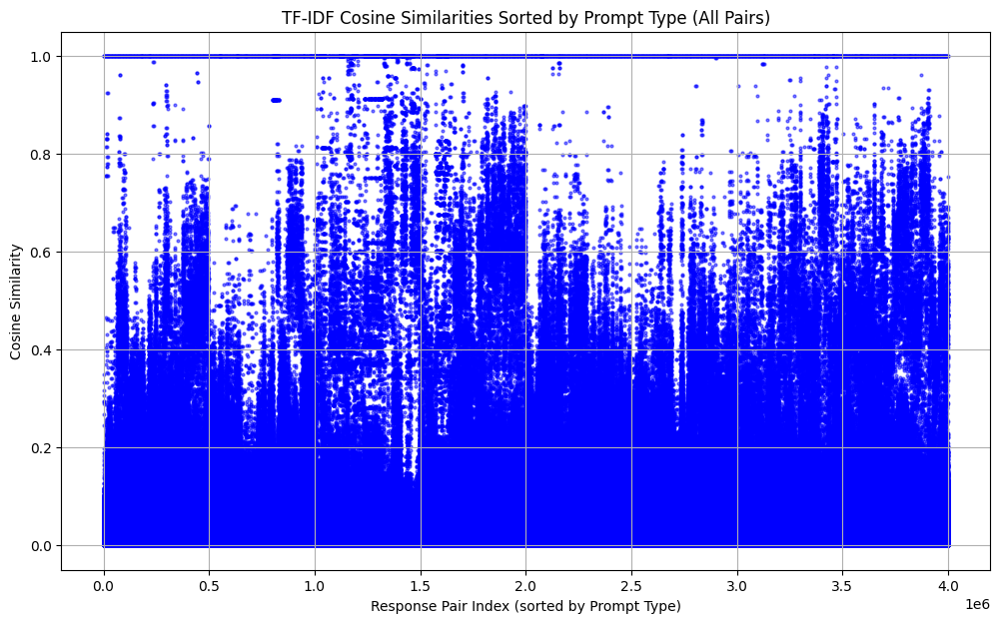


Order of Prompt Types in the sorted dataset:
['Specific Creative', 'Specific Logical', 'Vague Creative', 'Vague Logical']


In [ ]:
# Create a DataFrame sorted by 'Prompt Type'
df_sorted_by_prompt_type = df.sort_values(by='Prompt Type').reset_index(drop=True)

# Create TF-IDF vectors for the sorted data
vectorizer_sorted = TfidfVectorizer()
tfidf_matrix_sorted = vectorizer_sorted.fit_transform(df_sorted_by_prompt_type['Response Text'])

# Calculate cosine similarity for the sorted data
cosine_similarities_sorted = cosine_similarity(tfidf_matrix_sorted)

# Use all similarities (flattened matrix) - not dropping duplicate pairs or self-similarity
cosine_similarities_all_pairs = cosine_similarities_sorted.flatten()

# Create x and y coordinates for the scatter plot
x_sorted = np.arange(len(cosine_similarities_all_pairs))
y_sorted = cosine_similarities_all_pairs

# Plot the scatter plot
plt.figure(figsize=(12, 7))
plt.scatter(x_sorted, y_sorted, s=4, alpha=0.5, color='blue')
plt.title('TF-IDF Cosine Similarities Sorted by Prompt Type (All Pairs)')
plt.xlabel('Response Pair Index (sorted by Prompt Type)')
plt.ylabel('Cosine Similarity')
plt.grid(True)
plt.show()

print("\nOrder of Prompt Types in the sorted dataset:")
print(df_sorted_by_prompt_type['Prompt Type'].unique().tolist())

In [ ]:
# Calculate the average cosine similarity for the entire dataset
# Exclude self-similarity (diagonal) and duplicate pairs
upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

average_similarity_all_data = np.mean(cosine_similarities_unique)

print(f"--- Cosine Similarity Report for Entire Dataset ---")
print(f"Number of response pairs analyzed: {len(cosine_similarities_unique)}")
print(f"Average Cosine Similarity: {average_similarity_all_data:.4f}")
print("-" * 40)

--- Cosine Similarity Report for Entire Dataset ---
Number of response pairs analyzed: 1999000
Average Cosine Similarity: 0.0875
----------------------------------------


Analyse for each category


--- Cosine Similarity Analysis for Prompt Type: Specific Logical ---


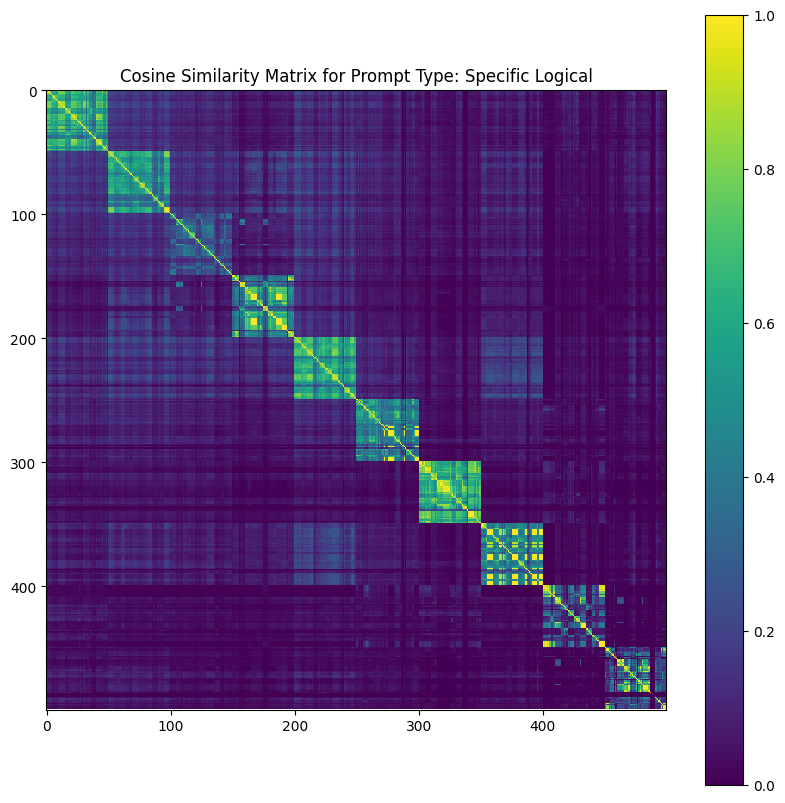

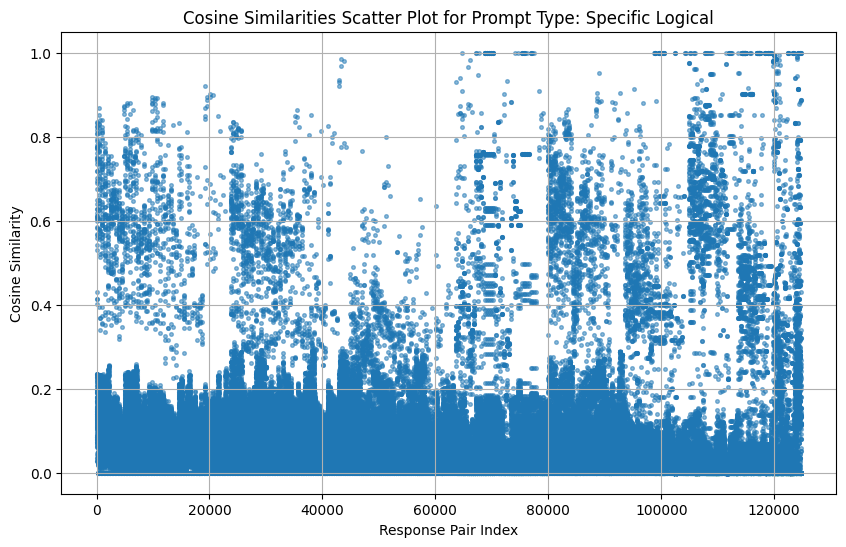


--- Cosine Similarity Analysis for Prompt Type: Specific Creative ---


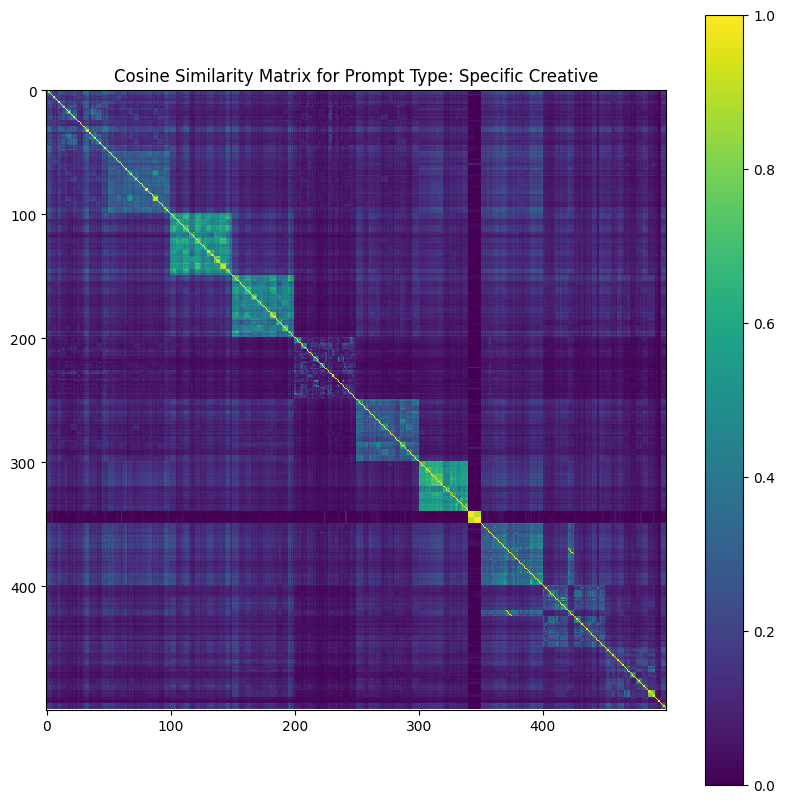

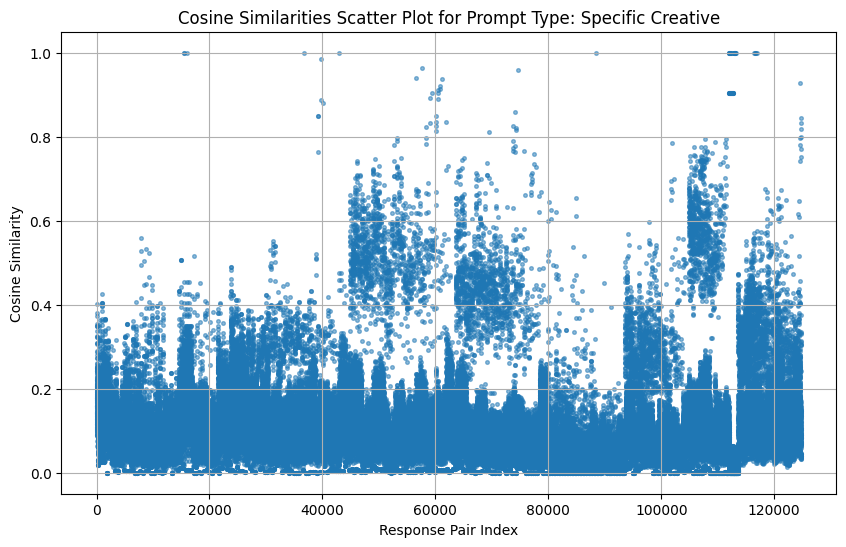


--- Cosine Similarity Analysis for Prompt Type: Vague Logical ---


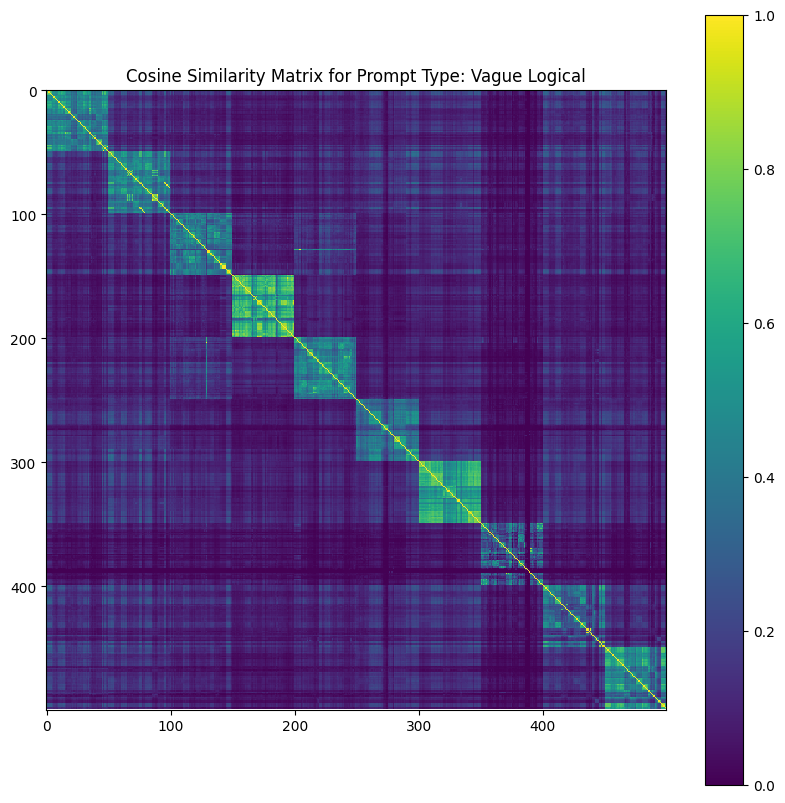

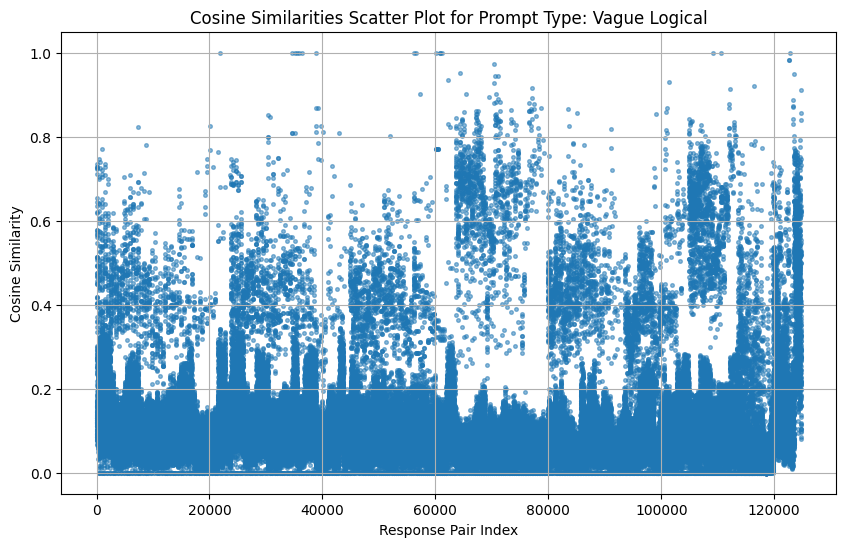


--- Cosine Similarity Analysis for Prompt Type: Vague Creative ---


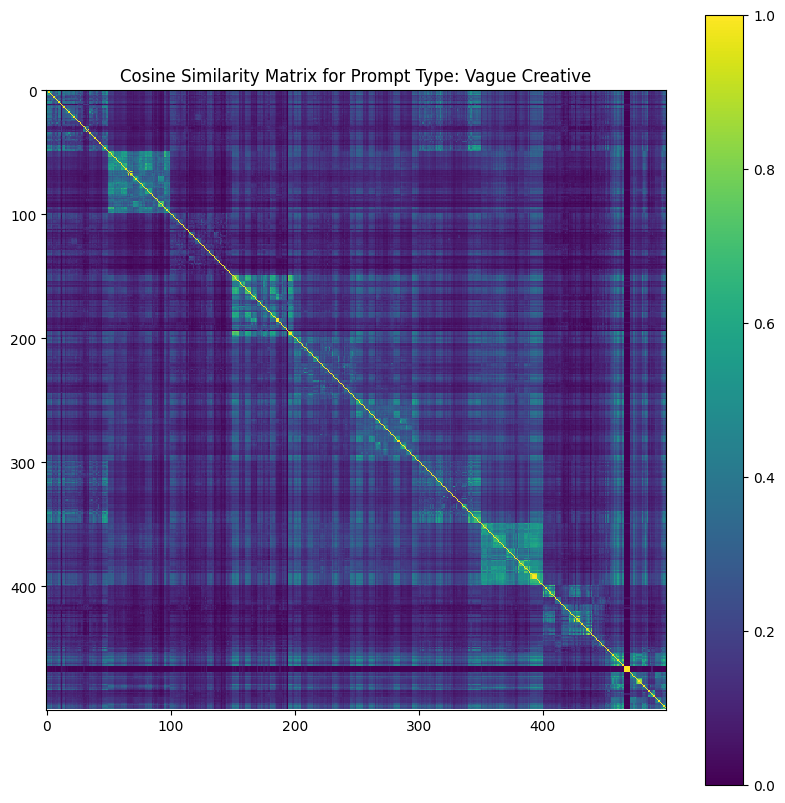

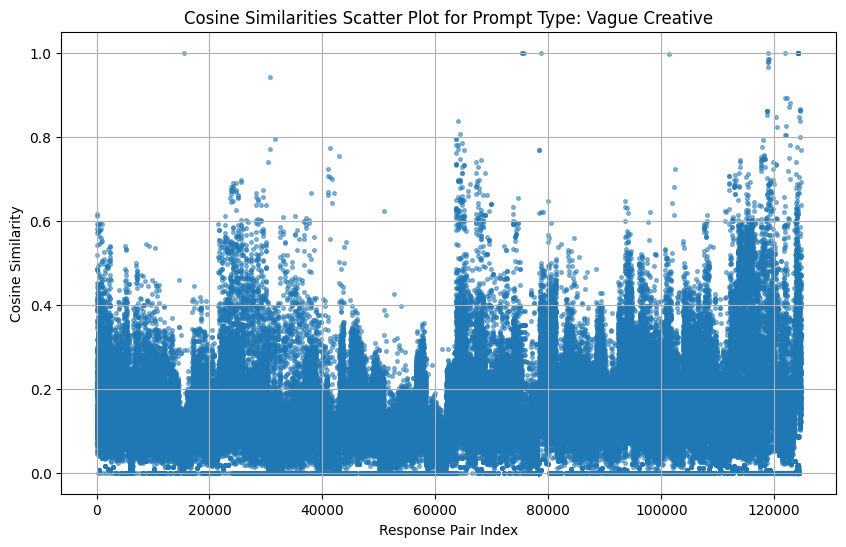


--- Cosine Similarity Analysis for Model: DeepSeek 3.1 ---


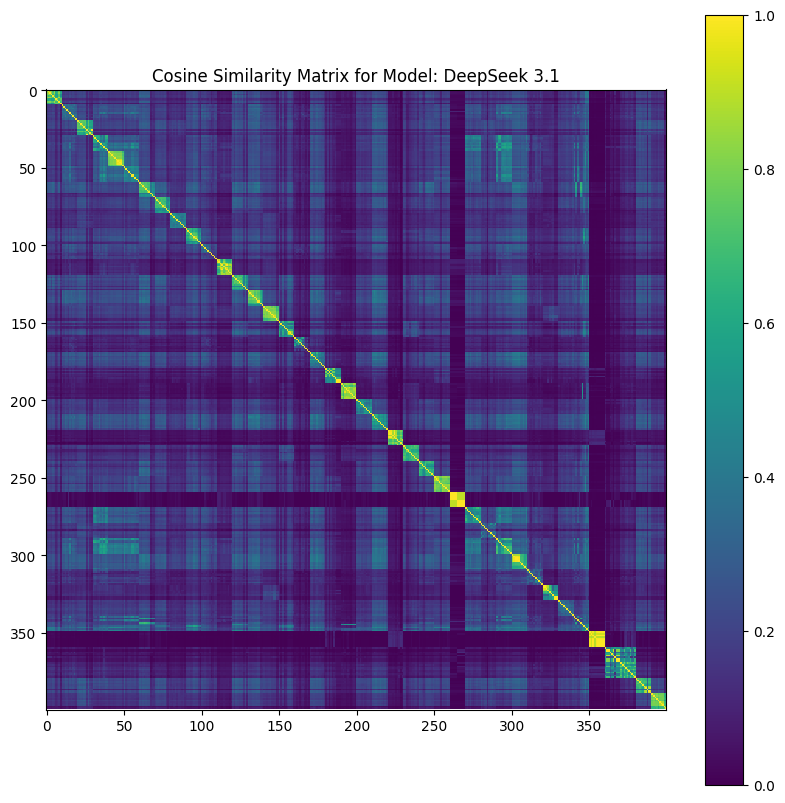

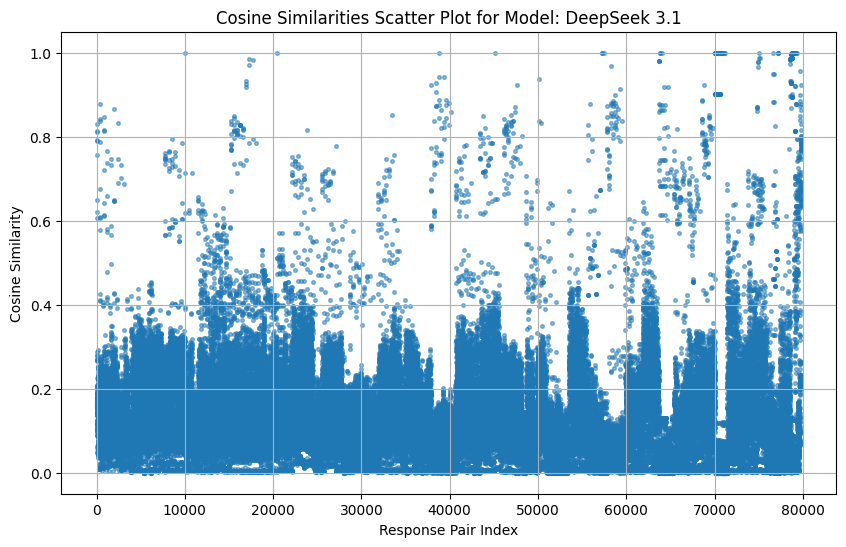


--- Cosine Similarity Analysis for Model: ChatGPT 5.0 ---


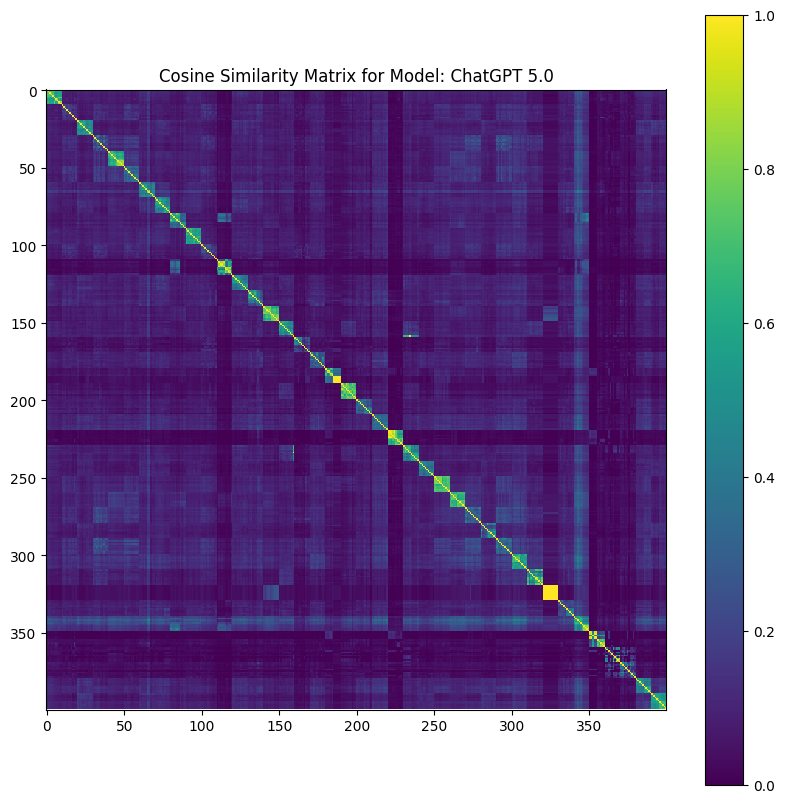

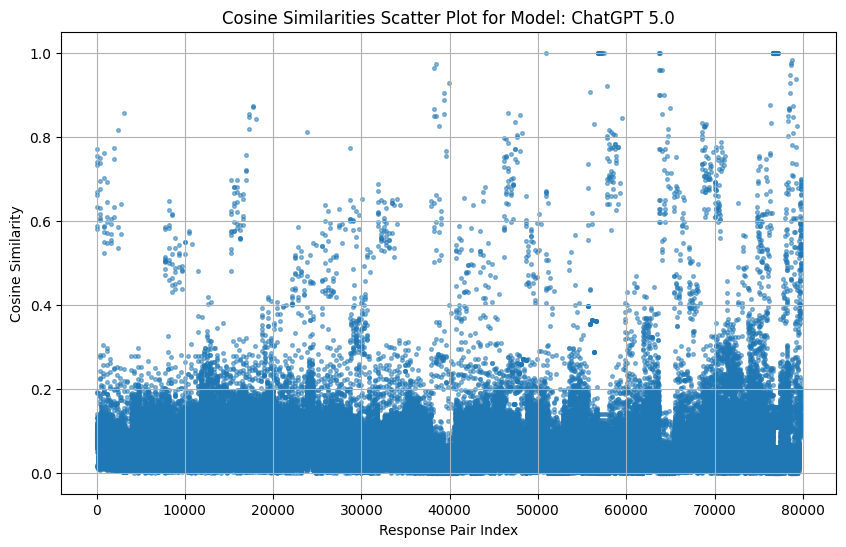


--- Cosine Similarity Analysis for Model: Google Gemini 2.5 ---


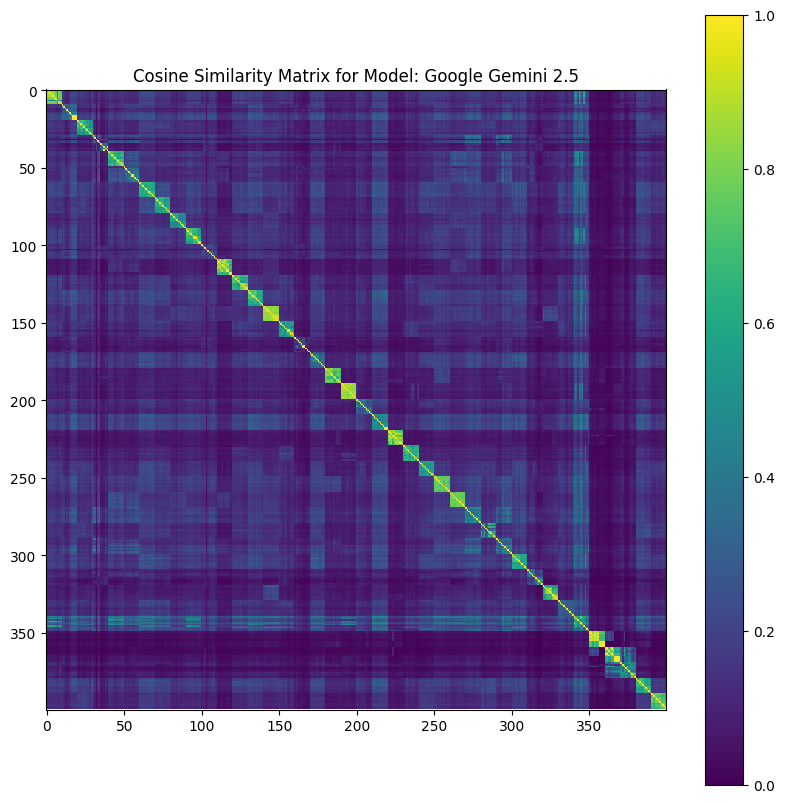

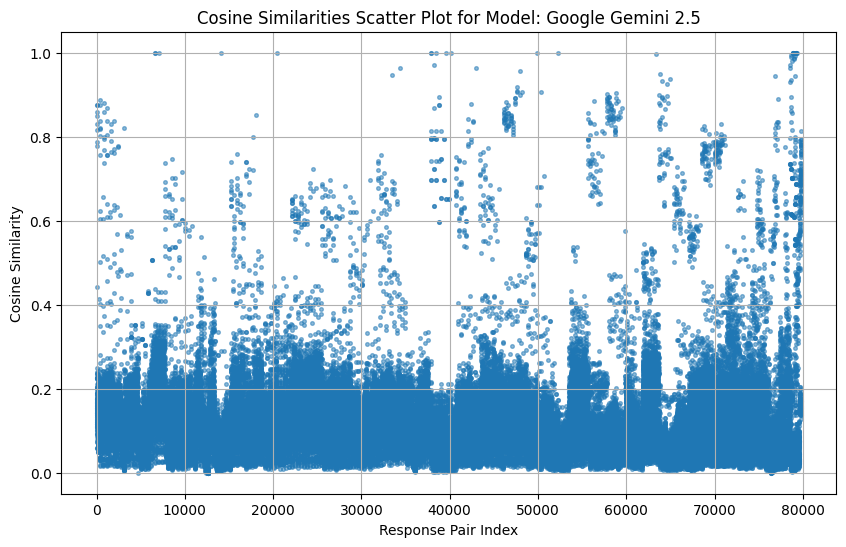


--- Cosine Similarity Analysis for Model: Meta Llama 4.0 ---


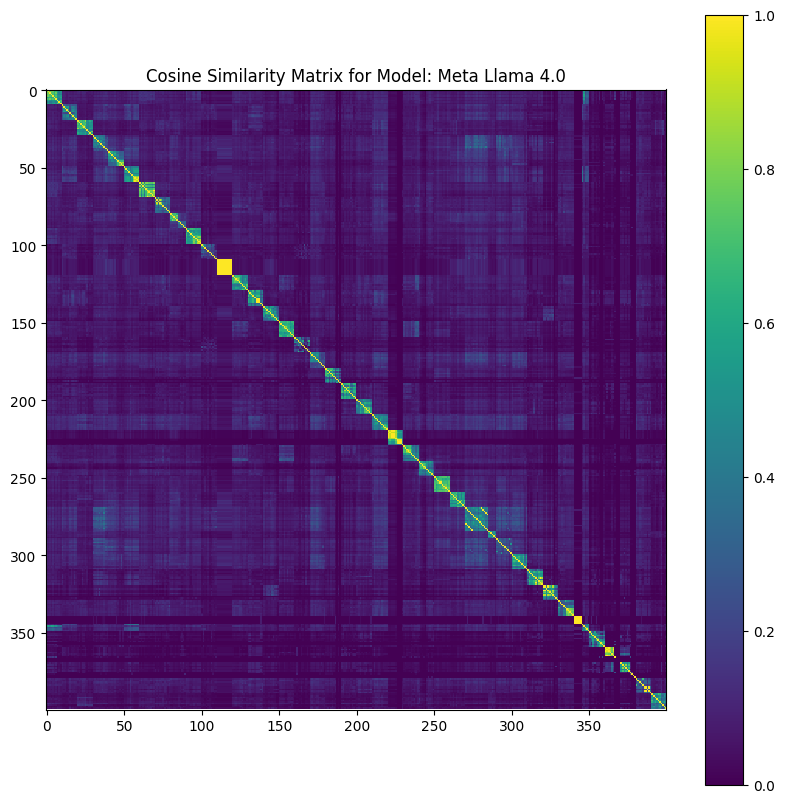

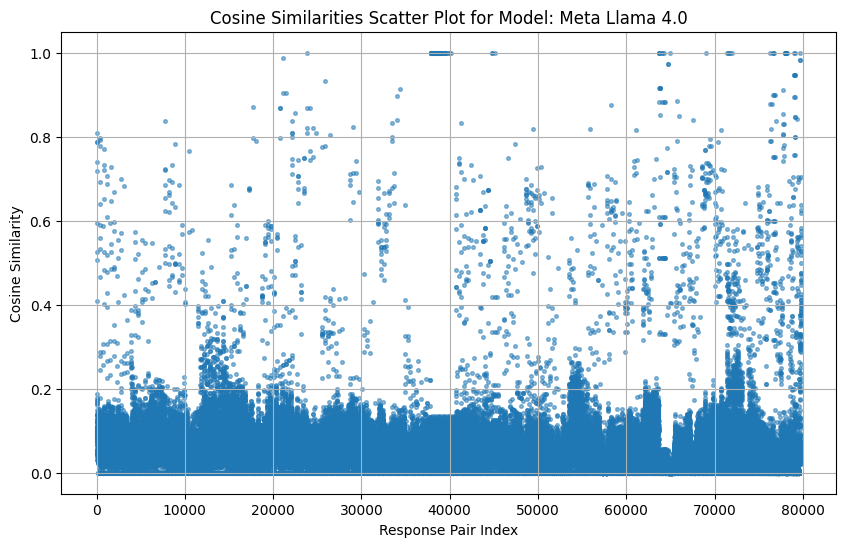


--- Cosine Similarity Analysis for Model: Grok 4.0 ---


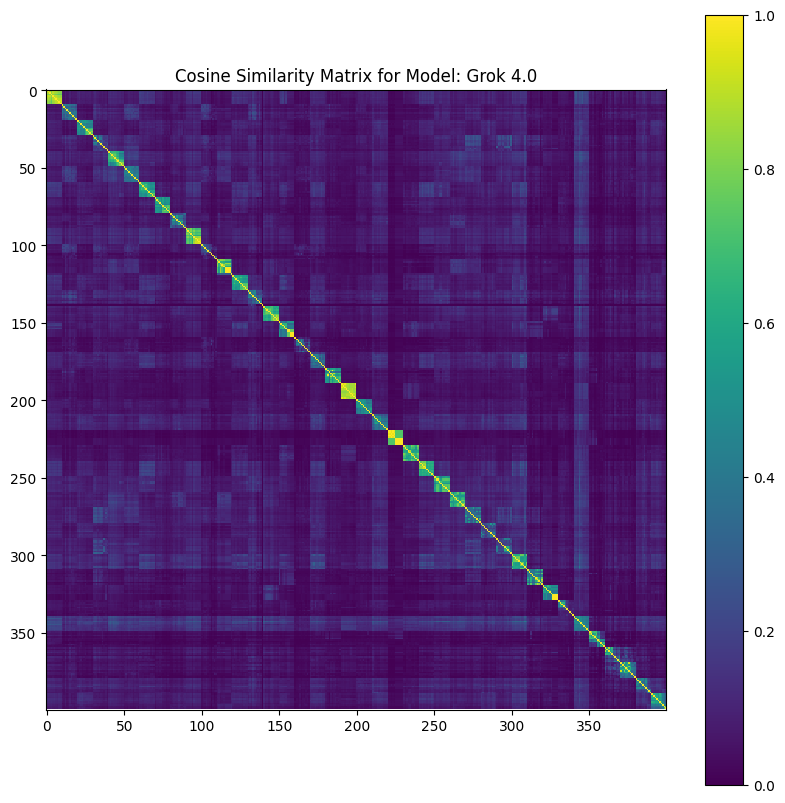

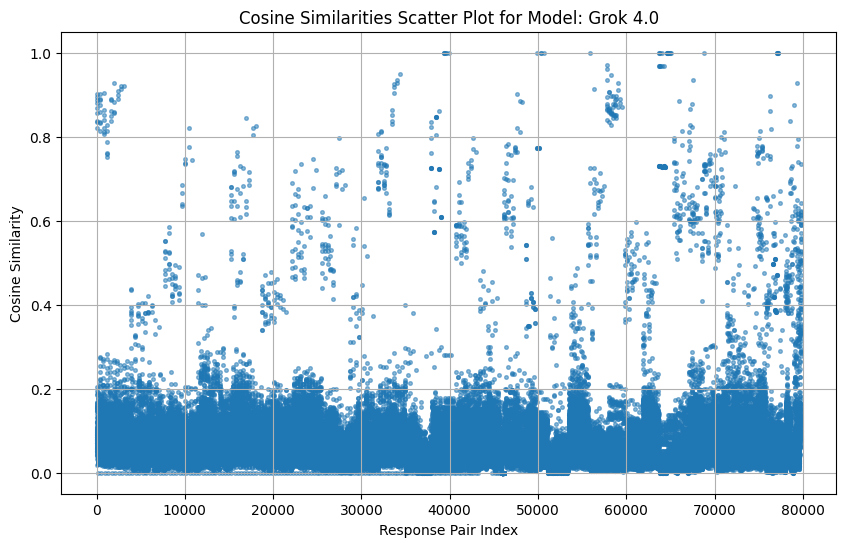

In [ ]:
# Analyze similarity by Prompt Type
prompt_types = df['Prompt Type'].unique()
for prompt_type in prompt_types:
    print(f"\n--- Cosine Similarity Analysis for Prompt Type: {prompt_type} ---")
    prompt_type_df = df[df['Prompt Type'] == prompt_type].copy()

    if not prompt_type_df.empty and len(prompt_type_df) > 1:
        # Create TF-IDF vectors
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(prompt_type_df['Response Text'])

        # Calculate cosine similarity
        cosine_similarities = cosine_similarity(tfidf_matrix)

        # Plot the similarity points in a heat graph
        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix for Prompt Type: {prompt_type}')
        plt.colorbar()
        plt.show()

        # Create a graph from the similarity matrix
        graph = nx.from_numpy_array(cosine_similarities)

        # Plot the graph (optional, can be very dense for large datasets)
        # plt.figure(figsize=(12, 12))
        # nx.draw(graph, with_labels=True, node_size=50, font_size=6, edge_color='gray', width=0.5)
        # plt.title(f'Cosine Similarity Graph for Prompt Type: {prompt_type}')
        # plt.show()

        # Plot the scatter plot of similarities
        cosine_similarities_flat = cosine_similarities.flatten()
        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]


        x = np.arange(len(cosine_similarities_unique))
        y = cosine_similarities_unique

        plt.figure(figsize=(10, 6))
        plt.scatter(x, y, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot for Prompt Type: {prompt_type}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()

    else:
        print("Not enough data for this prompt type to perform similarity analysis.")

# Analyze similarity by Model
models = df['Model'].unique()
for model in models:
    print(f"\n--- Cosine Similarity Analysis for Model: {model} ---")
    model_df = df[df['Model'] == model].copy()

    if not model_df.empty and len(model_df) > 1:
        # Create TF-IDF vectors
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(model_df['Response Text'])

        # Calculate cosine similarity
        cosine_similarities = cosine_similarity(tfidf_matrix)

        # Plot the similarity points in a heat graph
        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix for Model: {model}')
        plt.colorbar()
        plt.show()

        # Create a graph from the similarity matrix
        graph = nx.from_numpy_array(cosine_similarities)

        # Plot the graph (optional)
        # plt.figure(figsize=(12, 12))
        # nx.draw(graph, with_labels=True, node_size=50, font_size=6, edge_color='gray', width=0.5)
        # plt.title(f'Cosine Similarity Graph for Model: {model}')
        # plt.show()

        # Plot the scatter plot of similarities
        cosine_similarities_flat = cosine_similarities.flatten()
        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        x = np.arange(len(cosine_similarities_unique))
        y = cosine_similarities_unique

        plt.figure(figsize=(10, 6))
        plt.scatter(x, y, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot for Model: {model}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()
    else:
        print("Not enough data for this model to perform similarity analysis.")


--- Cosine Similarity Analysis by User Name (TF-IDF) ---

--- Analysis for User Name: Hayden ---


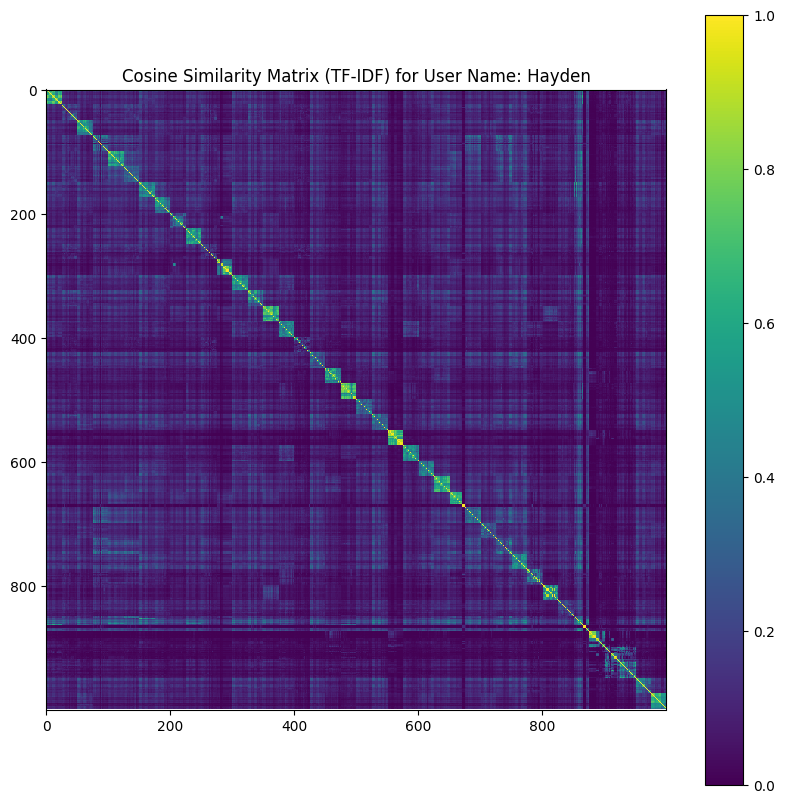

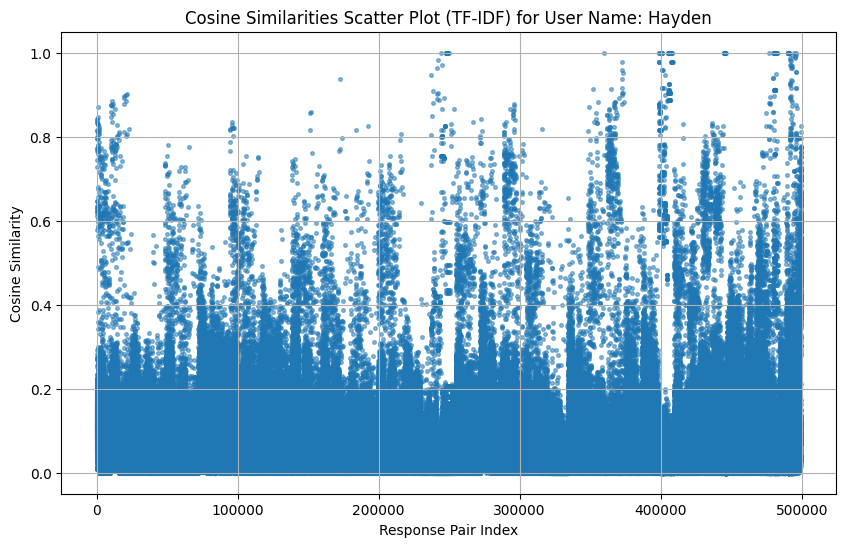


--- Analysis for User Name: Smera ---


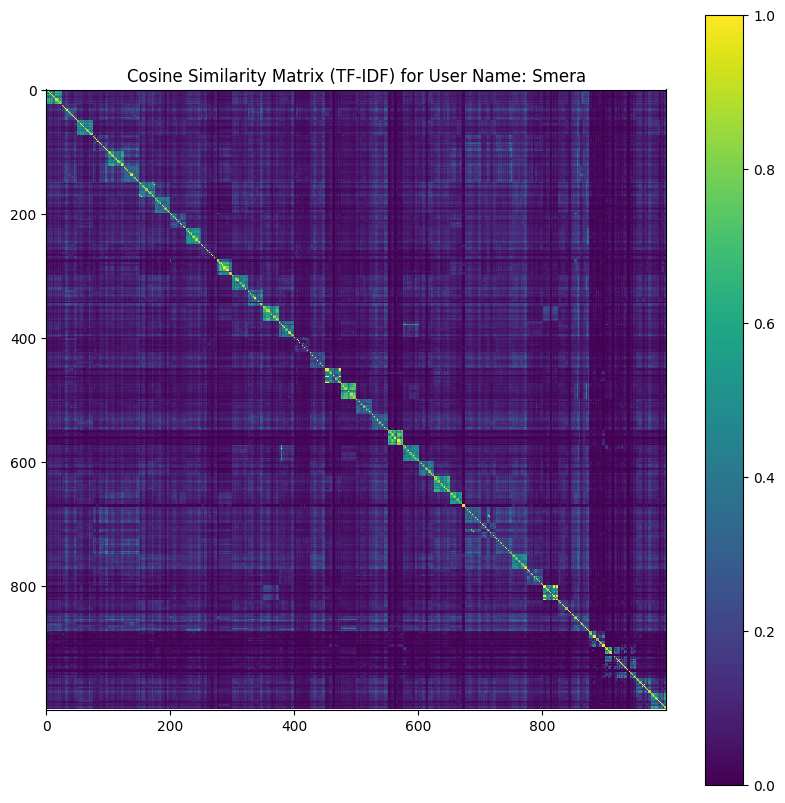

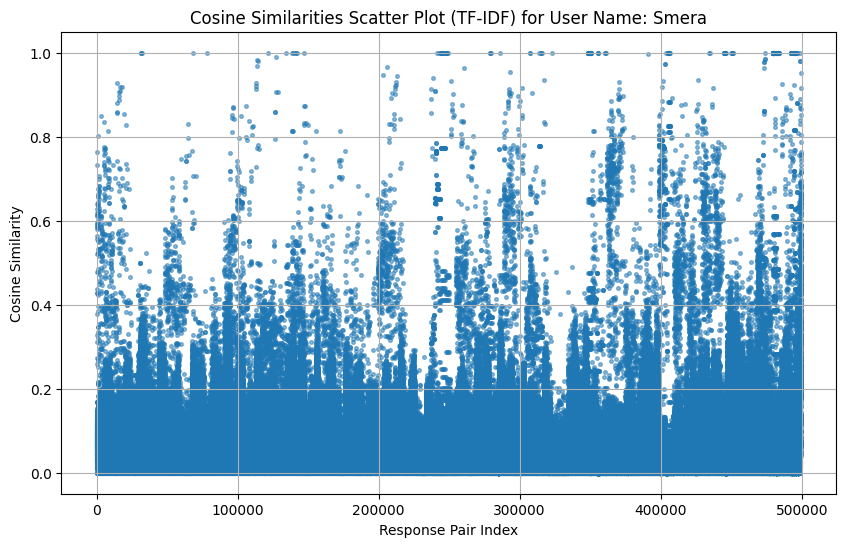

In [ ]:
# Analyze similarity by User Name (TF-IDF)
print("\n--- Cosine Similarity Analysis by User Name (TF-IDF) ---")
user_names = df[df.keys()[5]].unique()
for user_name in user_names:
    print(f"\n--- Analysis for User Name: {user_name} ---")
    user_name_df = df[df[df.keys()[5]] == user_name].copy()

    if not user_name_df.empty and len(user_name_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(user_name_df['Response Text'])

        cosine_similarities = cosine_similarity(tfidf_matrix)

        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix (TF-IDF) for User Name: {user_name}')
        plt.colorbar()
        plt.show()

        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        x = np.arange(len(cosine_similarities_unique))
        y = cosine_similarities_unique

        plt.figure(figsize=(10, 6))
        plt.scatter(x, y, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot (TF-IDF) for User Name: {user_name}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()
    else:
        print("Not enough data for this user to perform similarity analysis.")

In [ ]:
# Report on Cosine Similarity by User Name (TF-IDF)
print("\n--- Cosine Similarity Report by User Name (TF-IDF) ---")
user_names = df[df.keys()[5]].unique()
for user_name in user_names:
    user_name_df = df[df[df.keys()[5]] == user_name].copy()
    if not user_name_df.empty and len(user_name_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(user_name_df['Response Text'])
        cosine_similarities = cosine_similarity(tfidf_matrix)

        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        average_similarity = np.mean(cosine_similarities_unique)
        print(f"User Name: {user_name}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_unique)}")
        print(f"  Average Cosine Similarity (TF-IDF): {average_similarity:.4f}")
    else:
        print(f"User Name: {user_name}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)


--- Cosine Similarity Report by User Name (TF-IDF) ---
User Name: Hayden
  Number of response pairs analyzed: 499500
  Average Cosine Similarity (TF-IDF): 0.0945
----------------------------------------
User Name: Smera
  Number of response pairs analyzed: 499500
  Average Cosine Similarity (TF-IDF): 0.0847
----------------------------------------


In [ ]:
# Report on Cosine Similarity by Prompt Type
print("--- Cosine Similarity Report by Prompt Type ---")
prompt_types = df['Prompt Type'].unique()
for prompt_type in prompt_types:
    prompt_type_df = df[df['Prompt Type'] == prompt_type].copy()
    if not prompt_type_df.empty and len(prompt_type_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(prompt_type_df['Response Text'])
        cosine_similarities = cosine_similarity(tfidf_matrix)

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        average_similarity = np.mean(cosine_similarities_unique)
        print(f"Prompt Type: {prompt_type}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_unique)}")
        print(f"  Average Cosine Similarity: {average_similarity:.4f}")
    else:
        print(f"Prompt Type: {prompt_type}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)

# Report on Cosine Similarity by Model
print("\n--- Cosine Similarity Report by Model ---")
models = df['Model'].unique()
for model in models:
    model_df = df[df['Model'] == model].copy()
    if not model_df.empty and len(model_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(model_df['Response Text'])
        cosine_similarities = cosine_similarity(tfidf_matrix)

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        average_similarity = np.mean(cosine_similarities_unique)
        print(f"Model: {model}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_unique)}")
        print(f"  Average Cosine Similarity: {average_similarity:.4f}")
    else:
        print(f"Model: {model}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)

--- Cosine Similarity Report by Prompt Type ---
Prompt Type: Specific Logical
  Number of response pairs analyzed: 124750
  Average Cosine Similarity: 0.1032
----------------------------------------
Prompt Type: Specific Creative
  Number of response pairs analyzed: 124750
  Average Cosine Similarity: 0.1169
----------------------------------------
Prompt Type: Vague Logical
  Number of response pairs analyzed: 124750
  Average Cosine Similarity: 0.1287
----------------------------------------
Prompt Type: Vague Creative
  Number of response pairs analyzed: 124750
  Average Cosine Similarity: 0.1576
----------------------------------------

--- Cosine Similarity Report by Model ---
Model: DeepSeek 3.1
  Number of response pairs analyzed: 79800
  Average Cosine Similarity: 0.1451
----------------------------------------
Model: ChatGPT 5.0
  Number of response pairs analyzed: 79800
  Average Cosine Similarity: 0.0865
----------------------------------------
Model: Google Gemini 2.5
  Num

In [ ]:
# Report on Cosine Similarity by Prompt
print("\n--- Cosine Similarity Report by Prompt ---")
prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    prompt_df = df[df[df.keys()[0]] == prompt].copy()
    if not prompt_df.empty and len(prompt_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(prompt_df['Response Text'])
        cosine_similarities = cosine_similarity(tfidf_matrix)

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

        average_similarity = np.mean(cosine_similarities_unique)
        print(f"Prompt: {prompt}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_unique)}")
        print(f"  Average Cosine Similarity: {average_similarity:.4f}")
    else:
        print(f"Prompt: {prompt}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)


--- Cosine Similarity Report by Prompt ---
Prompt: How would you go about solving a complex sudoku puzzle?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity: 0.5351
----------------------------------------
Prompt: Write a poem about absurdism.
  Number of response pairs analyzed: 1225
  Average Cosine Similarity: 0.2440
----------------------------------------
Prompt: Should governments prioritize economic growth or environmental protection?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity: 0.3548
----------------------------------------
Prompt: Write a short story.
  Number of response pairs analyzed: 1225
  Average Cosine Similarity: 0.2761
----------------------------------------
Prompt: What happened to each of Ragnar Lothbrok's sons?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity: 0.5191
----------------------------------------
Prompt: Write a poem about absurdism where a land surveyor attempts to survey the land sur

In [ ]:
# Analyze similarity by Prompt, Prompt Type, and Model
print("\n--- Cosine Similarity Report by Prompt, Prompt Type, and Model ---")
prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    print(f"\nPrompt: {prompt}")
    prompt_df = df[df[df.keys()[0]] == prompt].copy()
    prompt_types = prompt_df['Prompt Type'].unique()
    for prompt_type in prompt_types:
        print(f"  Prompt Type: {prompt_type}")
        prompt_type_df = prompt_df[prompt_df['Prompt Type'] == prompt_type].copy()
        models = prompt_type_df['Model'].unique()
        for model in models:
            model_df = prompt_type_df[prompt_type_df['Model'] == model].copy()

            # Check if there is enough text data before vectorizing
            if not model_df.empty and len(model_df) > 1 and any(model_df['Response Text'].str.strip().astype(bool)):
                # Create TF-IDF vectors
                vectorizer = TfidfVectorizer()
                try:
                    tfidf_matrix = vectorizer.fit_transform(model_df['Response Text'])

                    # Calculate cosine similarity
                    cosine_similarities = cosine_similarity(tfidf_matrix)

                    # Exclude self-similarity (diagonal) and duplicate pairs
                    upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
                    cosine_similarities_unique = cosine_similarities[upper_triangular_indices]

                    average_similarity = np.mean(cosine_similarities_unique)
                    print(f"    Model: {model}")
                    print(f"      Number of response pairs analyzed: {len(cosine_similarities_unique)}")
                    print(f"      Average Cosine Similarity: {average_similarity:.4f}")
                except ValueError as e:
                    print(f"    Model: {model}")
                    print(f"      Could not calculate similarity: {e}")
            else:
                print(f"    Model: {model}")
                print("      Not enough data to calculate similarity.")
        print("-" * 40)
    print("=" * 60)


--- Cosine Similarity Report by Prompt, Prompt Type, and Model ---

Prompt: How would you go about solving a complex sudoku puzzle?
  Prompt Type: Specific Logical
    Model: DeepSeek 3.1
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.7011
    Model: ChatGPT 5.0
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.6043
    Model: Google Gemini 2.5
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.7533
    Model: Meta Llama 4.0
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.5558
    Model: Grok 4.0
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.8435
----------------------------------------

Prompt: Write a poem about absurdism.
  Prompt Type: Specific Creative
    Model: DeepSeek 3.1
      Number of response pairs analyzed: 45
      Average Cosine Similarity: 0.4966
    Model: ChatGPT 5.0
      Number of response pairs analyzed: 45
     

In [ ]:
# Calculate average similarity for each prompt
prompt_average_similarities = {}
prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    prompt_df = df[df[df.keys()[0]] == prompt].copy()
    if not prompt_df.empty and len(prompt_df) > 1:
        vectorizer = TfidfVectorizer()
        tfidf_matrix = vectorizer.fit_transform(prompt_df['Response Text'])
        cosine_similarities = cosine_similarity(tfidf_matrix)
        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]
        average_similarity = np.mean(cosine_similarities_unique)
        prompt_average_similarities[prompt] = average_similarity

# Convert the dictionary to a pandas Series for easy calculation of summary statistics
average_similarities_series = pd.Series(prompt_average_similarities)

# Report the 5-point summary
print("\n--- 5-Point Summary of Average Cosine Similarity by Prompt ---")
print(average_similarities_series.describe())

# Optionally, list the prompts with the highest, lowest, and median similarities
print("\nPrompt with Highest Average Similarity:")
print(average_similarities_series.idxmax(), f": {average_similarities_series.max():.4f}")

print("\nPrompt with Lowest Average Similarity:")
print(average_similarities_series.idxmin(), f": {average_similarities_series.min():.4f}")

print("\nPrompts with Median Average Similarity:")
# Find prompts with similarity close to the median
median_similarity = average_similarities_series.median()
prompts_at_median = average_similarities_series[np.isclose(average_similarities_series, median_similarity, atol=0.005)] # Use a small tolerance for floating point comparison
for prompt, similarity in prompts_at_median.items():
    print(f"- {prompt}: {similarity:.4f}")


--- 5-Point Summary of Average Cosine Similarity by Prompt ---
count    40.000000
mean      0.345050
std       0.112139
min       0.119013
25%       0.251990
50%       0.351987
75%       0.408859
max       0.552500
dtype: float64

Prompt with Highest Average Similarity:
What would happen if gravity disappeared : 0.5525

Prompt with Lowest Average Similarity:
Write a four-line poem about rain that ends with hope. : 0.1190

Prompts with Median Average Similarity:
- Should governments prioritize economic growth or environmental protection?: 0.3548
- How to survive a zombie apocalypse.: 0.3518
- Tell a story where the hero is saving the world: 0.3490
- How would you go about solving a complex sudoku puzzle? Write a poem about absurdism. Should governments prioritize economic growth or environmental protection? Write a short story. What happened to each of Ragnar Lothbrok's sons? Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. Write a po

In [ ]:
# Calculate and report average in-group similarity for each model and prompt type
print("\n--- Average In-Group Cosine Similarity by Model and Prompt Type ---")

# Create dictionaries to store the sum of similarities and the count for each model and prompt type
model_similarity_sums = {model: 0 for model in df['Model'].unique()}
model_similarity_counts = {model: 0 for model in df['Model'].unique()}
prompt_type_similarity_sums = {ptype: 0 for ptype in df['Prompt Type'].unique()}
prompt_type_similarity_counts = {ptype: 0 for ptype in df['Prompt Type'].unique()}


prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    prompt_df = df[df[df.keys()[0]] == prompt].copy()
    prompt_types = prompt_df['Prompt Type'].unique()
    for prompt_type in prompt_types:
        prompt_type_df = prompt_df[prompt_df['Prompt Type'] == prompt_type].copy()
        models = prompt_type_df['Model'].unique()
        for model in models:
            model_df = prompt_type_df[prompt_type_df['Model'] == model].copy()

            if not model_df.empty and len(model_df) > 1 and any(model_df['Response Text'].str.strip().astype(bool)):
                vectorizer = TfidfVectorizer()
                try:
                    tfidf_matrix = vectorizer.fit_transform(model_df['Response Text'])
                    cosine_similarities = cosine_similarity(tfidf_matrix)
                    upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
                    cosine_similarities_unique = cosine_similarities[upper_triangular_indices]
                    average_similarity = np.mean(cosine_similarities_unique)

                    # Add the average similarity to the corresponding sums and increment counts
                    model_similarity_sums[model] += average_similarity
                    model_similarity_counts[model] += 1
                    prompt_type_similarity_sums[prompt_type] += average_similarity
                    prompt_type_similarity_counts[prompt_type] += 1

                except ValueError as e:
                    # Handle cases where similarity couldn't be calculated
                    pass # Skip this combination

# Calculate and print the average in-group similarity for each model
print("Average In-Group Similarity by Model:")
for model in model_similarity_sums:
    if model_similarity_counts[model] > 0:
        average_in_group_similarity = model_similarity_sums[model] / model_similarity_counts[model]
        print(f"  {model}: {average_in_group_similarity:.4f}")
    else:
        print(f"  {model}: Not enough data to calculate in-group similarity.")

print("-" * 40)

# Calculate and print the average in-group similarity for each prompt type
print("Average In-Group Similarity by Prompt Type:")
for prompt_type in prompt_type_similarity_sums:
    if prompt_type_similarity_counts[prompt_type] > 0:
        average_in_group_similarity = prompt_type_similarity_sums[prompt_type] / prompt_type_similarity_counts[prompt_type]
        print(f"  {prompt_type}: {average_in_group_similarity:.4f}")
    else:
        print(f"  {prompt_type}: Not enough data to calculate in-group similarity.")

print("-" * 40)


--- Average In-Group Cosine Similarity by Model and Prompt Type ---
Average In-Group Similarity by Model:
  DeepSeek 3.1: 0.6216
  ChatGPT 5.0: 0.4655
  Google Gemini 2.5: 0.5923
  Meta Llama 4.0: 0.4314
  Grok 4.0: 0.4725
----------------------------------------
Average In-Group Similarity by Prompt Type:
  Specific Logical: 0.5763
  Specific Creative: 0.4694
  Vague Logical: 0.5386
  Vague Creative: 0.4823
----------------------------------------


Perform Clustering using the TFID Vectors

DBSCAN Clustering Results (TF-IDF):
TFIDF_DBSCAN_Cluster
-1     1020
 0       52
 23      52
 15      51
 19      50
 11      49
 7       49
 16      49
 24      47
 14      47
 3       44
 13      42
 29      41
 8       41
 20      40
 9       36
 26      35
 1       35
 4       31
 25      26
 6       22
 27      22
 10      21
 28      19
 12      16
 22      12
 2       11
 5       10
 18      10
 17      10
 21      10
Name: count, dtype: int64


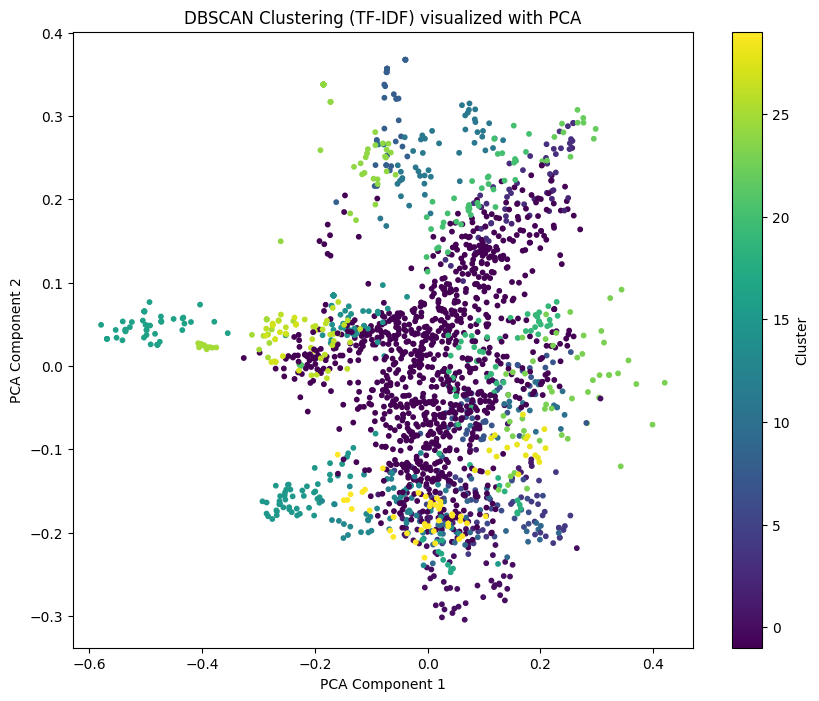

In [ ]:
# Create TF-IDF vectors for the entire dataset within this cell
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['Response Text'])


# Perform DBSCAN clustering
# You may need to adjust the eps and min_samples parameters based on your data
dbscan = DBSCAN(eps=.95, min_samples=10)
clusters = dbscan.fit_predict(tfidf_matrix)

# Add cluster labels to the DataFrame
df['TFIDF_DBSCAN_Cluster'] = clusters

# Analyze the clustering results
print("DBSCAN Clustering Results (TF-IDF):")
print(df['TFIDF_DBSCAN_Cluster'].value_counts())

# Visualize the clusters using PCA for dimensionality reduction
if tfidf_matrix.shape[0] > 1:
    pca = PCA(n_components=2)
    tfidf_2d = pca.fit_transform(tfidf_matrix.toarray())

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(tfidf_2d[:, 0], tfidf_2d[:, 1], c=clusters, cmap='viridis', s=10)
    plt.title('DBSCAN Clustering (TF-IDF) visualized with PCA')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.colorbar(scatter, label='Cluster')
    plt.show()
else:
    print("Not enough data points to perform PCA and visualize clusters.")

# You can further analyze the clusters by looking at the documents within each cluster
# For example, to see the first 5 documents in cluster 0 (excluding noise, which is cluster -1)
# print("\nSample documents from Cluster 0:")
# print(df[df['TFIDF_DBSCAN_Cluster'] == 0]['Response Text'].head().tolist())

K-Means Clustering Results (TF-IDF) with 32 clusters:
TFIDF_KMeans_Cluster
0      11
1      54
2     102
3      43
4     172
5      50
6      50
7      51
8      48
9      50
10     52
11     50
12     49
13     50
14    150
15     50
16     89
17     51
18     49
19    187
20     51
21     50
22     50
23     50
24     50
25     40
26     51
27     49
28     42
29     94
30     50
31     15
Name: count, dtype: int64


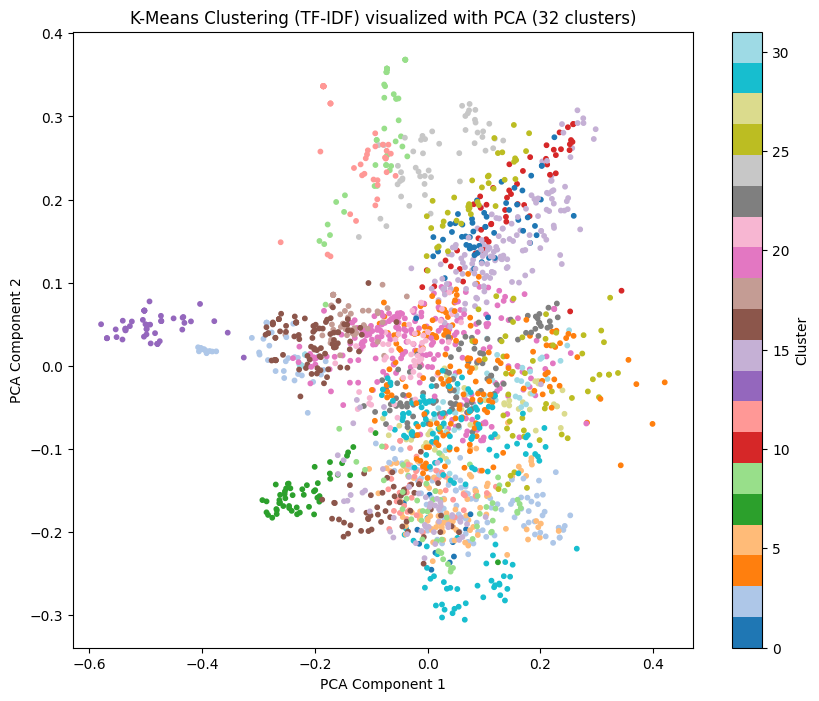

In [ ]:
# Create TF-IDF vectors for the entire dataset within this cell
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['Response Text'])

# Perform K-Means clustering
# We'll try with 32 clusters, corresponding to the number of unique prompts
n_clusters = 32
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10) # Added n_init for robustness
clusters_kmeans = kmeans.fit_predict(tfidf_matrix)

# Add cluster labels to the DataFrame
df['TFIDF_KMeans_Cluster'] = clusters_kmeans

# Analyze the clustering results
print(f"K-Means Clustering Results (TF-IDF) with {n_clusters} clusters:")
print(df['TFIDF_KMeans_Cluster'].value_counts().sort_index())

# Optional: Visualize the clusters using PCA
if tfidf_matrix.shape[0] > 1:
    pca = PCA(n_components=2)
    tfidf_2d = pca.fit_transform(tfidf_matrix.toarray())

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(tfidf_2d[:, 0], tfidf_2d[:, 1], c=clusters_kmeans, cmap='tab20', s=10) # Use a colormap with more distinct colors
    plt.title(f'K-Means Clustering (TF-IDF) visualized with PCA ({n_clusters} clusters)')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.colorbar(scatter, label='Cluster')
    plt.show()
else:
    print("Not enough data points to perform PCA and visualize clusters.")

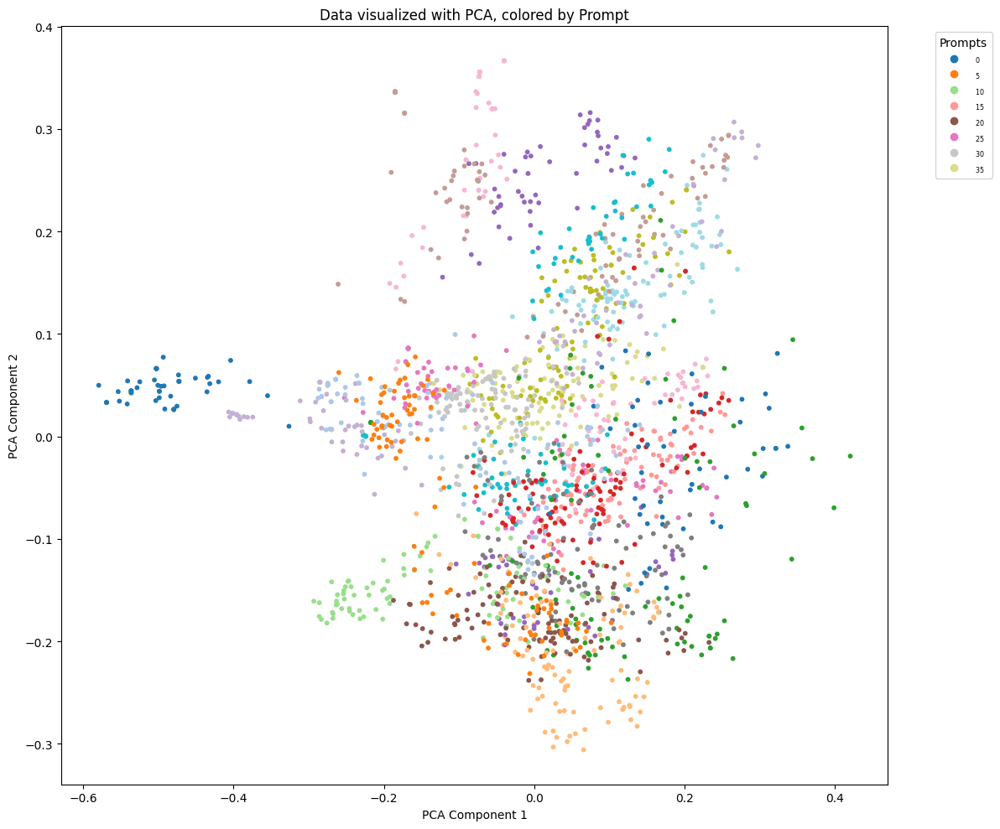

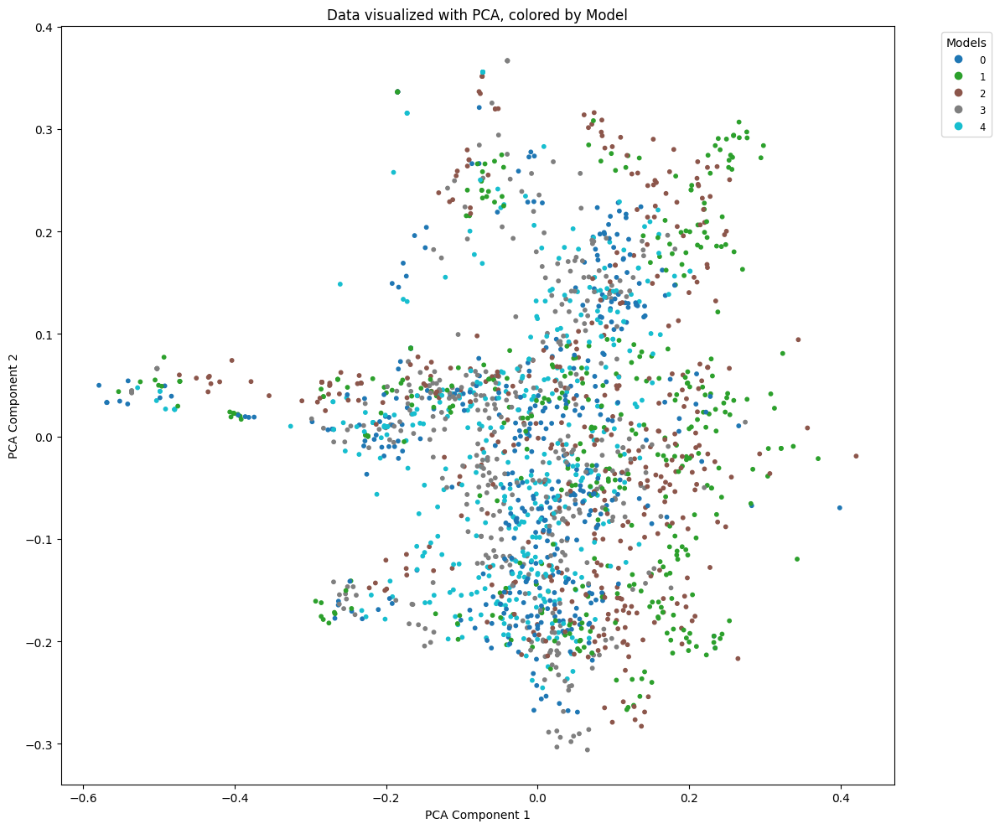

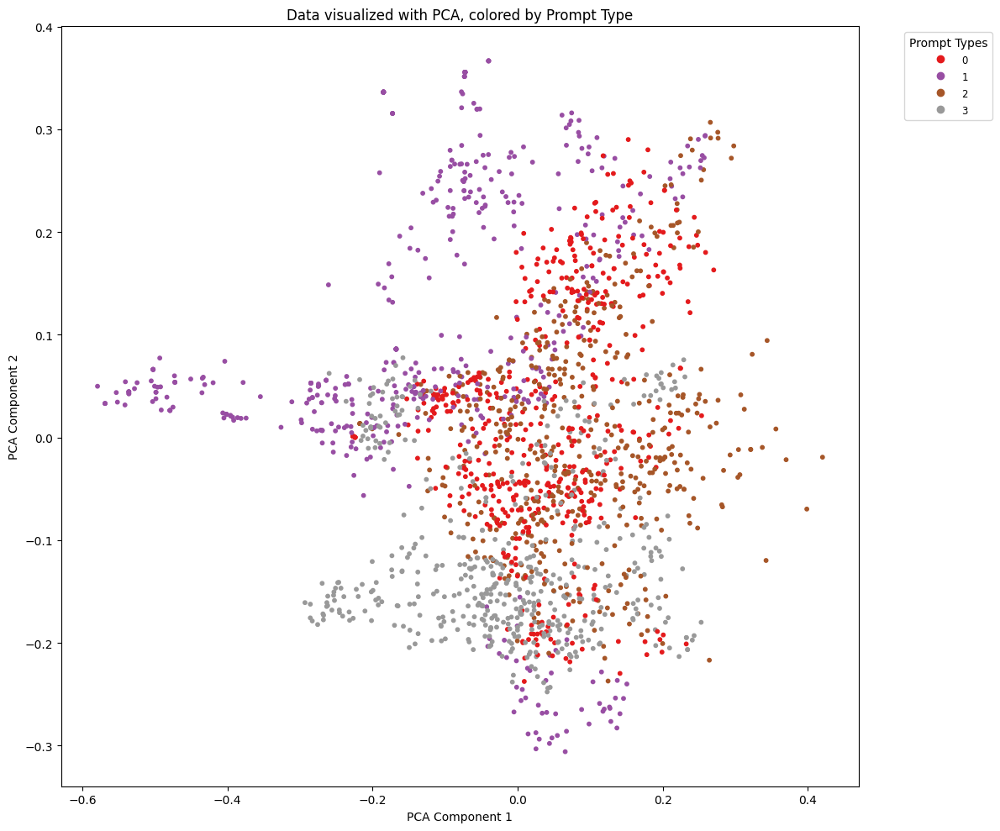

In [ ]:
# Visualize the data colored by actual categories
if tfidf_matrix.shape[0] > 1:
    pca = PCA(n_components=2)
    tfidf_2d = pca.fit_transform(tfidf_matrix.toarray())

    # Plot colored by Prompt
    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(tfidf_2d[:, 0], tfidf_2d[:, 1], c=df['ï»¿Prompt'].astype('category').cat.codes, cmap='tab20', s=10)
    plt.title('Data visualized with PCA, colored by Prompt')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    legend = plt.legend(*scatter.legend_elements(), title="Prompts", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.setp(legend.get_texts(), fontsize='xx-small')
    plt.tight_layout()
    plt.show()

    # Plot colored by Model
    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(tfidf_2d[:, 0], tfidf_2d[:, 1], c=df['Model'].astype('category').cat.codes, cmap='tab10', s=10)
    plt.title('Data visualized with PCA, colored by Model')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    legend = plt.legend(*scatter.legend_elements(), title="Models", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.setp(legend.get_texts(), fontsize='small')
    plt.tight_layout()
    plt.show()

    # Plot colored by Prompt Type
    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(tfidf_2d[:, 0], tfidf_2d[:, 1], c=df['Prompt Type'].astype('category').cat.codes, cmap='Set1', s=10)
    plt.title('Data visualized with PCA, colored by Prompt Type')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    legend = plt.legend(*scatter.legend_elements(), title="Prompt Types", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.setp(legend.get_texts(), fontsize='small')
    plt.tight_layout()
    plt.show()

else:
    print("Not enough data points to perform PCA and visualize.")

Use vector embeddings to perform semantic similarity analysis

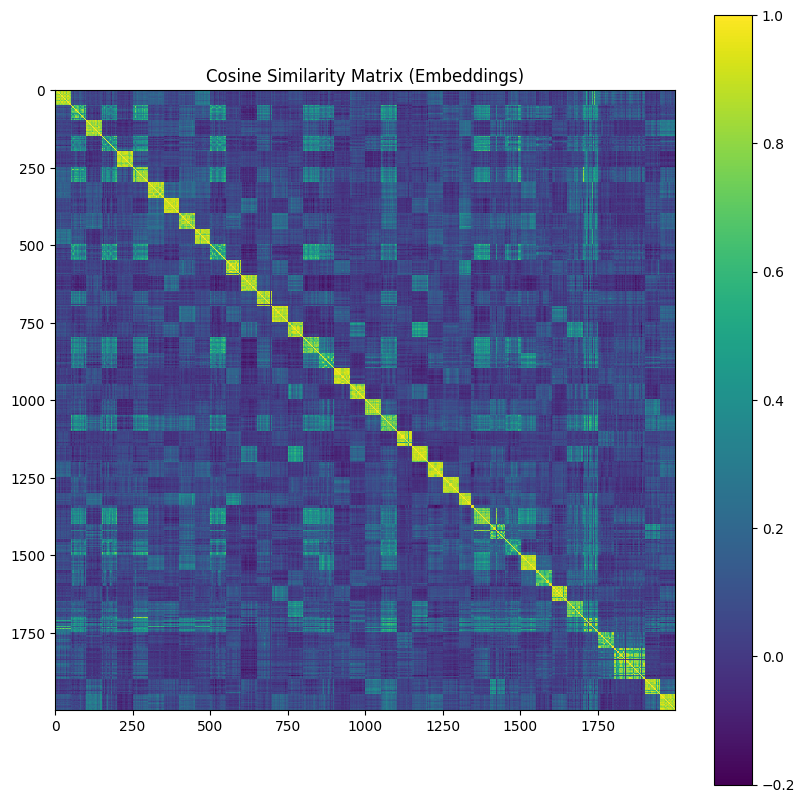

/tmp/ipython-input-962342866.py:41: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(df_cleaned['Model'].unique()))


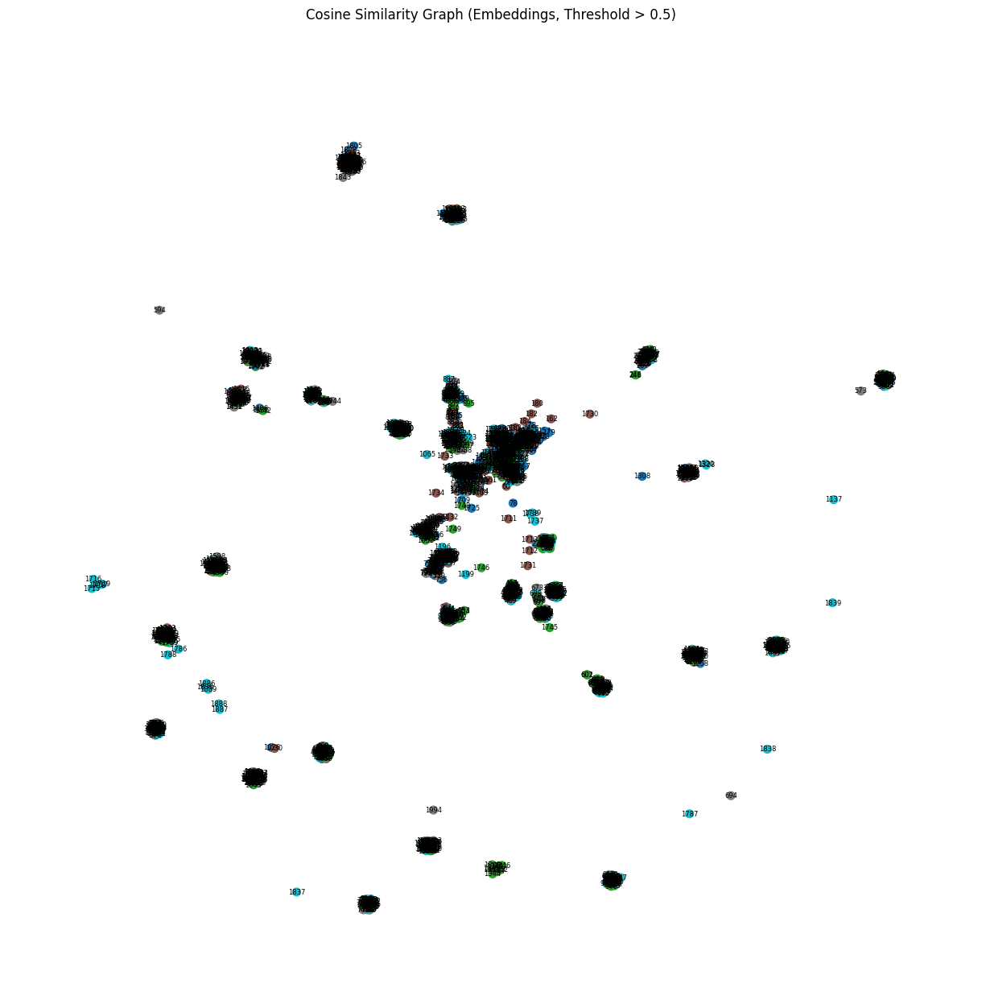

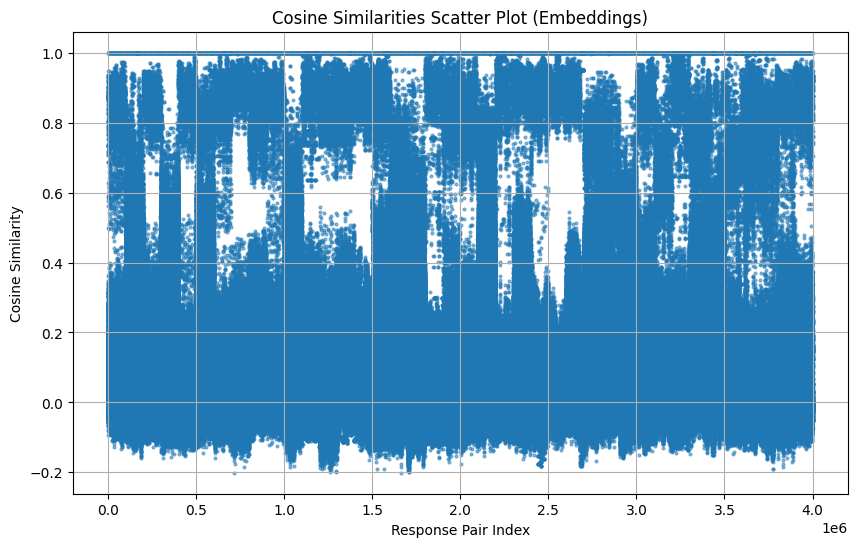

In [ ]:
# Convert the string representation of embeddings to a list of lists
# Handle potential errors in parsing
def parse_embedding(embedding_string):
    try:
        return ast.literal_eval(embedding_string)
    except (ValueError, SyntaxError):
        return None # Or handle the error as appropriate for your data

df['Response Embedding'] = df['Response Embedding'].apply(parse_embedding)

# Remove rows with invalid embeddings
df_cleaned = df.dropna(subset=['Response Embedding']).copy()

# Convert the list of embeddings to a numpy array
embeddings = np.array(df_cleaned['Response Embedding'].tolist())

# Calculate cosine similarity using embeddings
cosine_similarities_embeddings = cosine_similarity(embeddings)

# Plot the similarity points in a heat graph
plt.figure(figsize=(10, 10))
plt.imshow(cosine_similarities_embeddings, cmap='viridis', interpolation='nearest')
plt.title('Cosine Similarity Matrix (Embeddings)')
plt.colorbar()
plt.show()

# Create a graph from the similarity matrix, excluding low-similarity edges
similarity_threshold_embeddings = 0.5  # Set your desired threshold here
graph_embeddings = nx.from_numpy_array(cosine_similarities_embeddings)
edges_to_remove_embeddings = [(u, v) for u, v, data in graph_embeddings.edges(data=True) if data['weight'] < similarity_threshold_embeddings]
graph_embeddings.remove_edges_from(edges_to_remove_embeddings)


# Plot the graph
plt.figure(figsize=(12, 12))
# Use node_color based on a categorical variable if available, otherwise use a single color
if 'Model' in df_cleaned.columns:
    node_colors = df_cleaned['Model'].astype('category').cat.codes
    cmap = plt.cm.get_cmap('tab10', len(df_cleaned['Model'].unique()))
    nx.draw(graph_embeddings, with_labels=True, node_size=50, font_size=6, edge_color='gray', width=0.0, node_color=node_colors, cmap=cmap)
else:
    nx.draw(graph_embeddings, with_labels=True, node_size=50, font_size=6, edge_color='gray', width=0.0)

plt.title(f'Cosine Similarity Graph (Embeddings, Threshold > {similarity_threshold_embeddings})')
plt.show()


cosine_similarities_embeddings_flat = cosine_similarities_embeddings.flatten()

# Create x and y coordinates for the scatter plot
x_embeddings = np.arange(len(cosine_similarities_embeddings_flat))
y_embeddings = cosine_similarities_embeddings_flat

# Plot the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(x_embeddings, y_embeddings, s=4, alpha=0.5)  # Adjust 's' for marker size and 'alpha' for transparency
plt.title('Cosine Similarities Scatter Plot (Embeddings)')
plt.xlabel('Response Pair Index')
plt.ylabel('Cosine Similarity')
plt.grid(True)
plt.show()

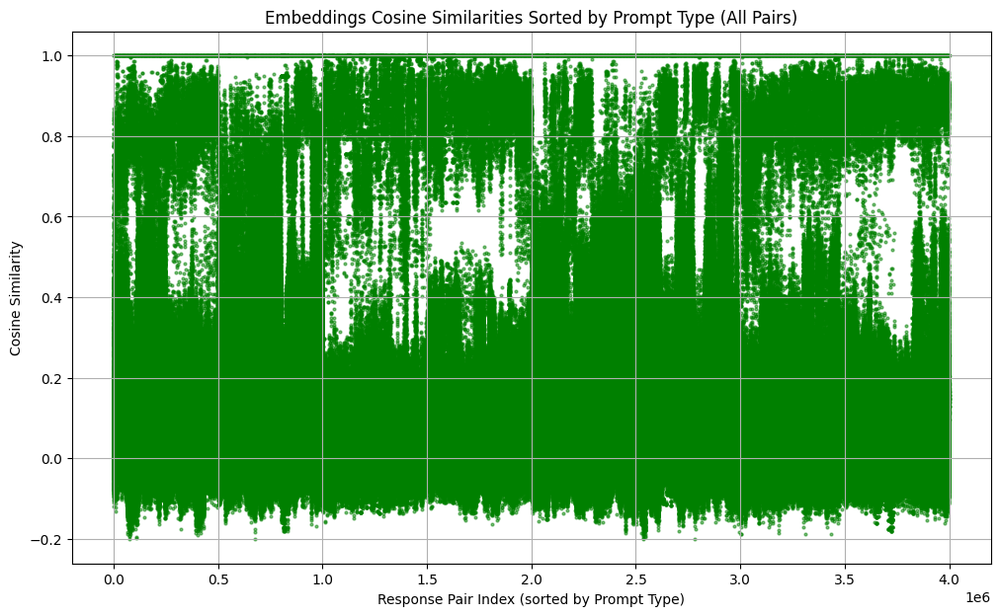


Order of Prompt Types in the sorted embeddings dataset:
['Specific Creative', 'Specific Logical', 'Vague Creative', 'Vague Logical']


In [ ]:
# Create a DataFrame sorted by 'Prompt Type' for cleaned data (with embeddings)
df_cleaned_sorted_by_prompt_type = df_cleaned.sort_values(by='Prompt Type').reset_index(drop=True)

# Get embeddings for the sorted data
embeddings_sorted = np.array(df_cleaned_sorted_by_prompt_type['Response Embedding'].tolist())

# Calculate cosine similarity for the sorted data (embeddings)
cosine_similarities_embeddings_sorted = cosine_similarity(embeddings_sorted)

# Use all similarities (flattened matrix) - not dropping duplicate pairs or self-similarity
cosine_similarities_embeddings_all_pairs = cosine_similarities_embeddings_sorted.flatten()

# Create x and y coordinates for the scatter plot
x_embeddings_sorted = np.arange(len(cosine_similarities_embeddings_all_pairs))
y_embeddings_sorted = cosine_similarities_embeddings_all_pairs

# Plot the scatter plot
plt.figure(figsize=(12, 7))
plt.scatter(x_embeddings_sorted, y_embeddings_sorted, s=4, alpha=0.5, color='green')
plt.title('Embeddings Cosine Similarities Sorted by Prompt Type (All Pairs)')
plt.xlabel('Response Pair Index (sorted by Prompt Type)')
plt.ylabel('Cosine Similarity')
plt.grid(True)
plt.show()

print("\nOrder of Prompt Types in the sorted embeddings dataset:")
print(df_cleaned_sorted_by_prompt_type['Prompt Type'].unique().tolist())

In [ ]:
# Calculate the average cosine similarity for the entire dataset
# Exclude self-similarity (diagonal) and duplicate pairs
upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

average_similarity_all_data_embeddings = np.mean(cosine_similarities_embeddings_unique)

print(f"--- Cosine Similarity Report for Entire Dataset (Embeddings) ---")
print(f"Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
print(f"Average Cosine Similarity: {average_similarity_all_data_embeddings:.4f}")
print("-" * 40)

--- Cosine Similarity Report for Entire Dataset (Embeddings) ---
Number of response pairs analyzed: 1999000
Average Cosine Similarity: 0.0984
----------------------------------------


Analyse for each category


--- Cosine Similarity Analysis by Prompt Type (Embeddings) ---

--- Analysis for Prompt Type: Specific Logical ---


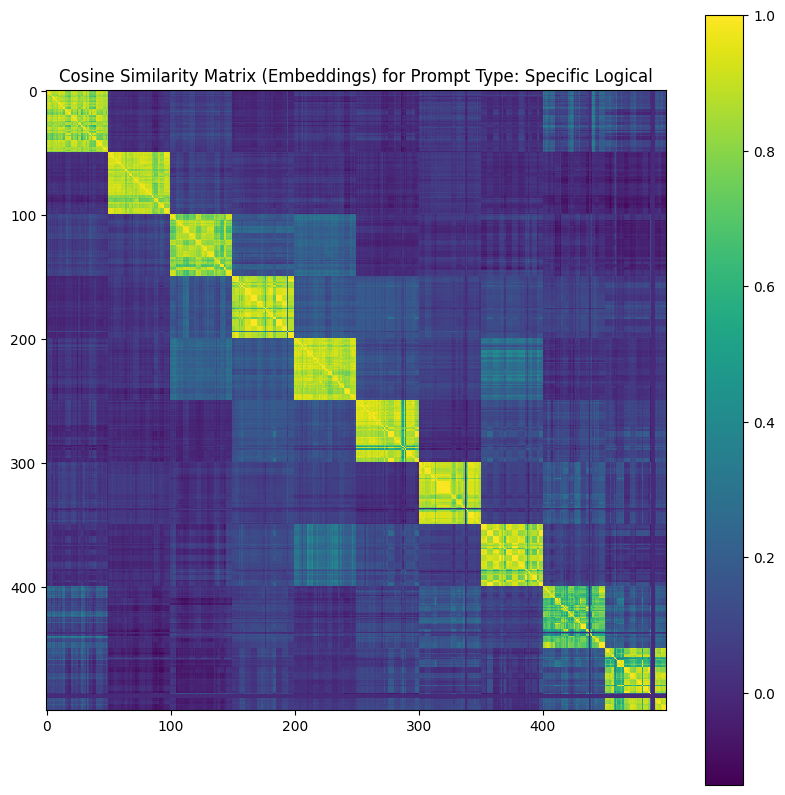

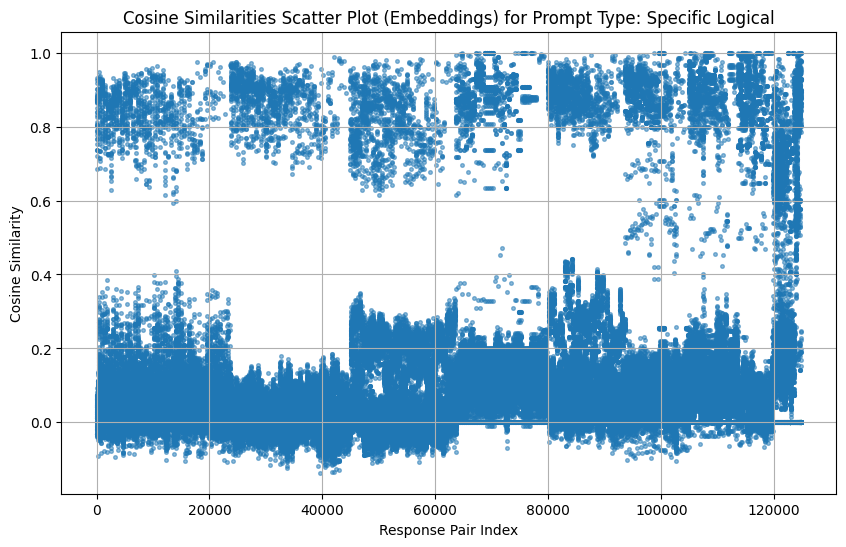


--- Analysis for Prompt Type: Specific Creative ---


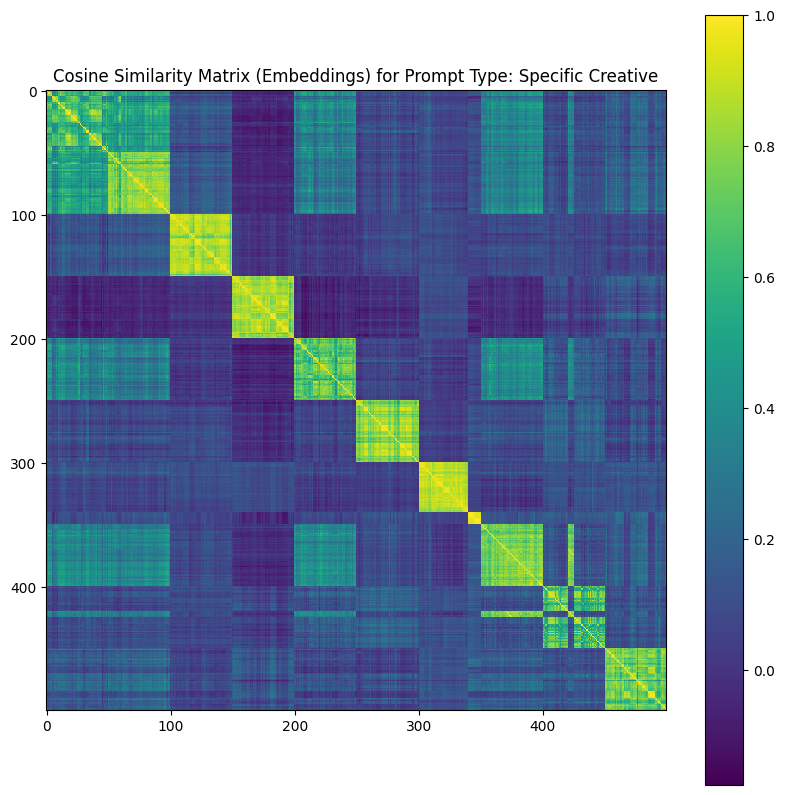

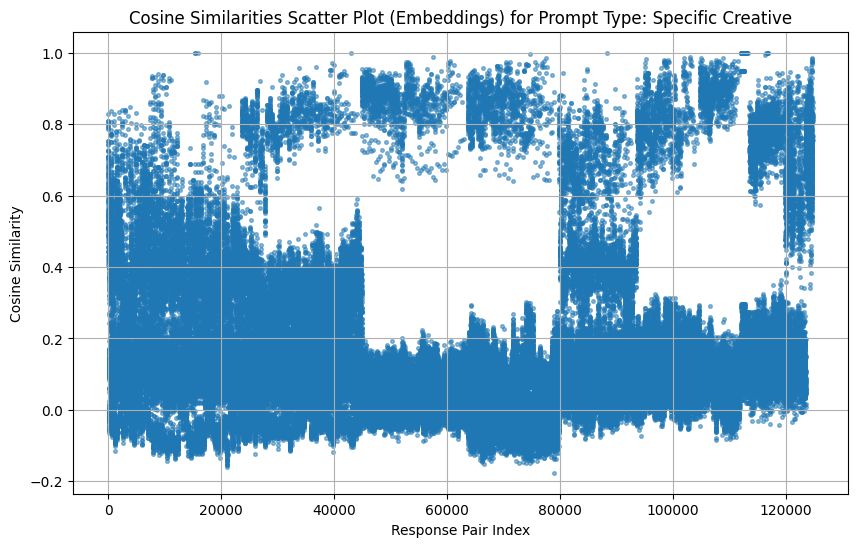


--- Analysis for Prompt Type: Vague Logical ---


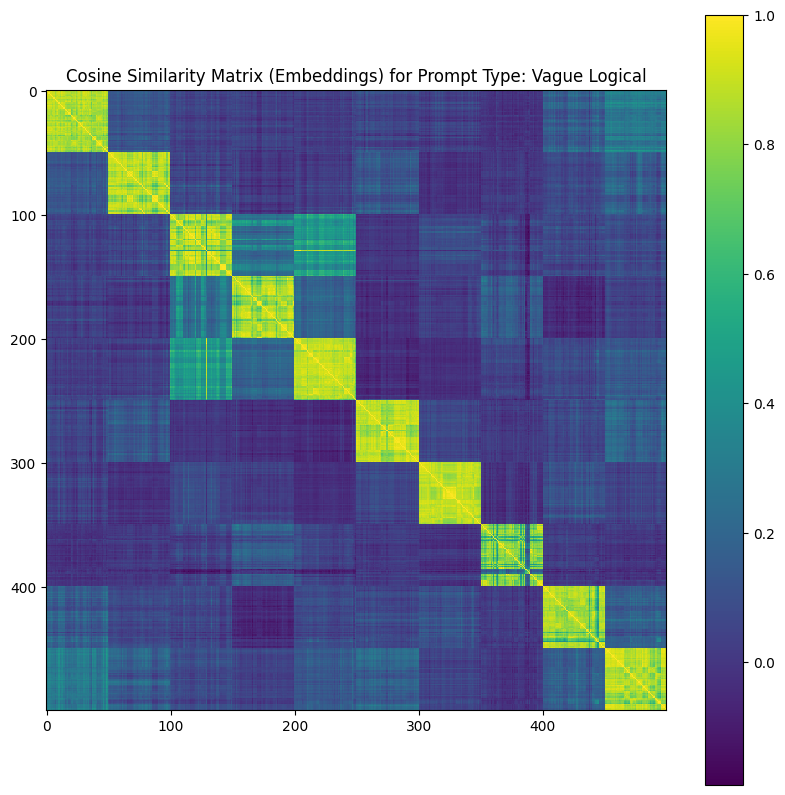

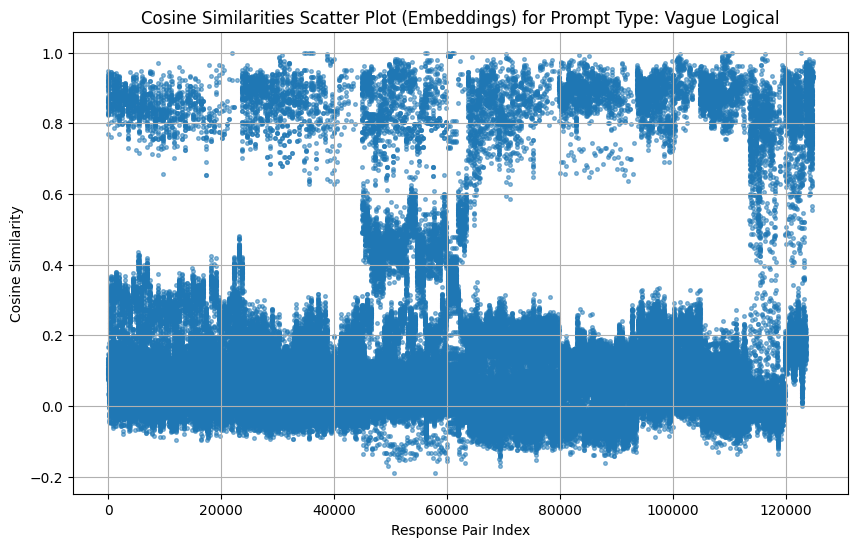


--- Analysis for Prompt Type: Vague Creative ---


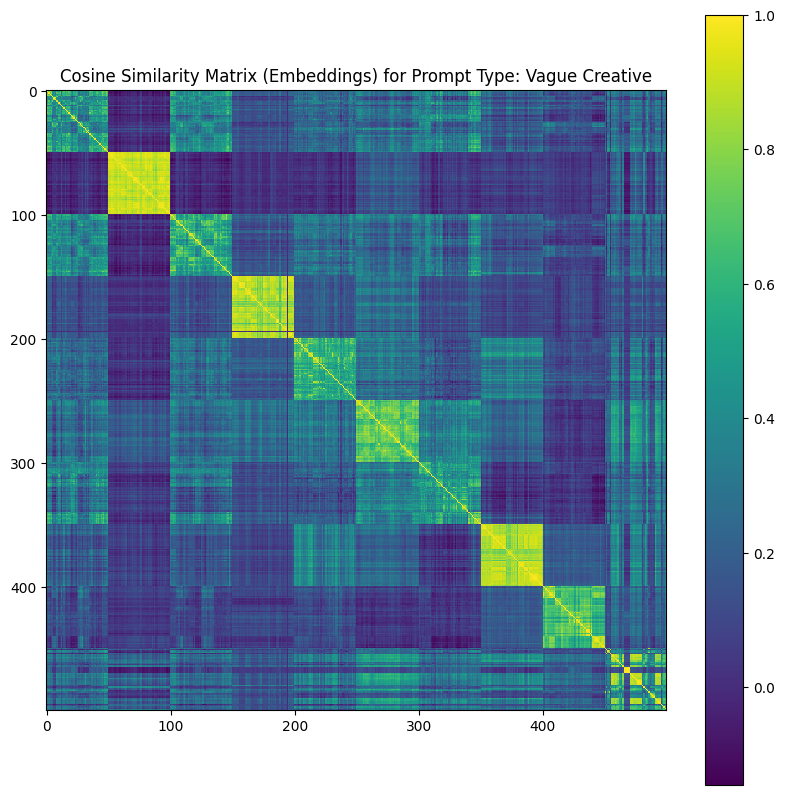

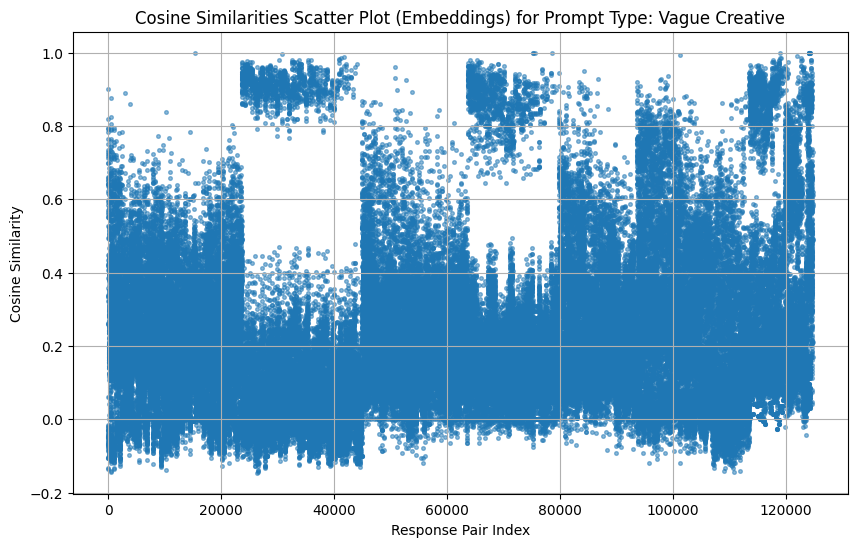


--- Cosine Similarity Analysis by Model (Embeddings) ---

--- Analysis for Model: DeepSeek 3.1 ---


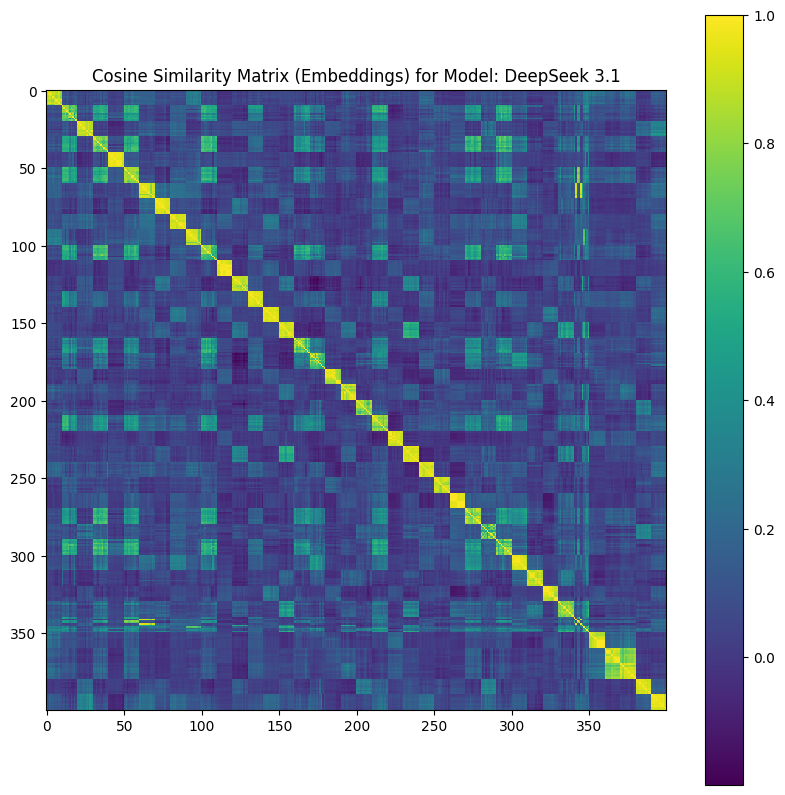

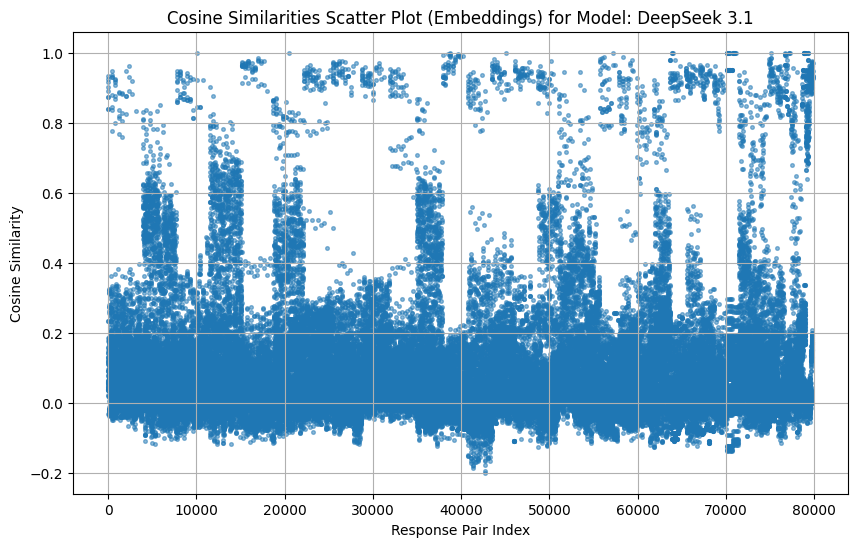


--- Analysis for Model: ChatGPT 5.0 ---


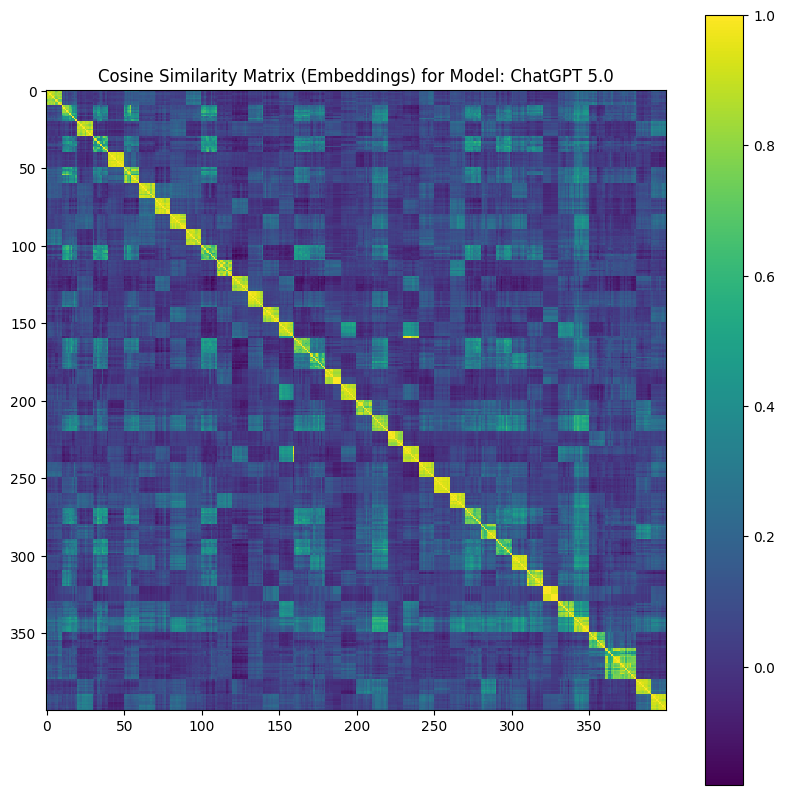

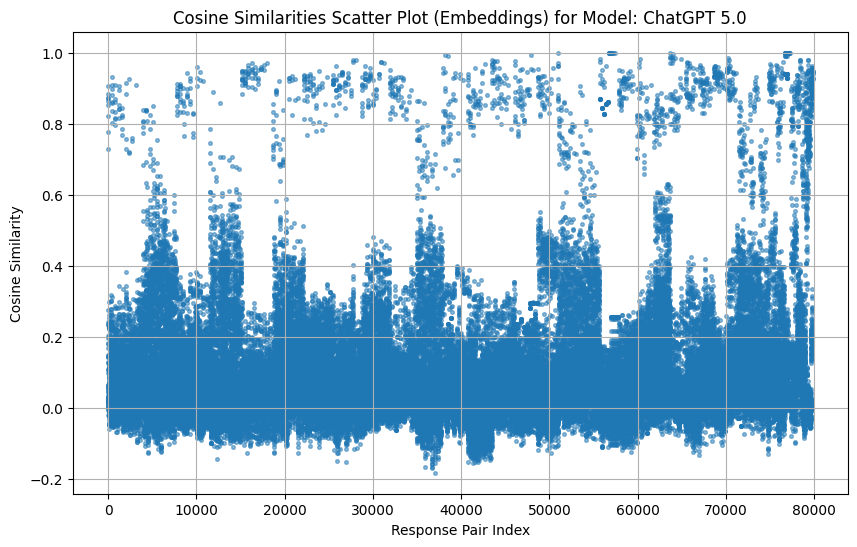


--- Analysis for Model: Google Gemini 2.5 ---


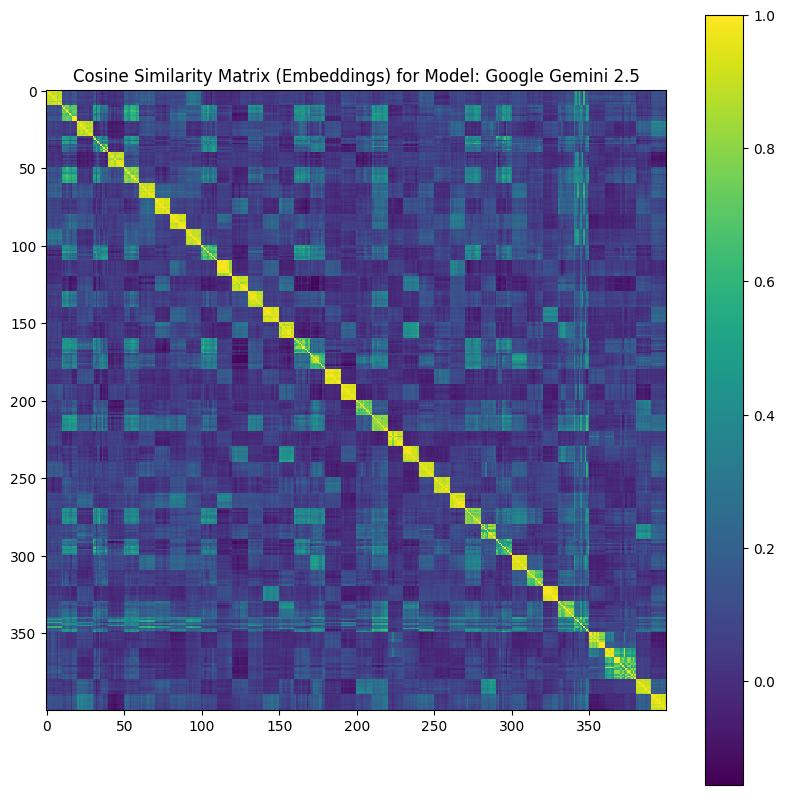

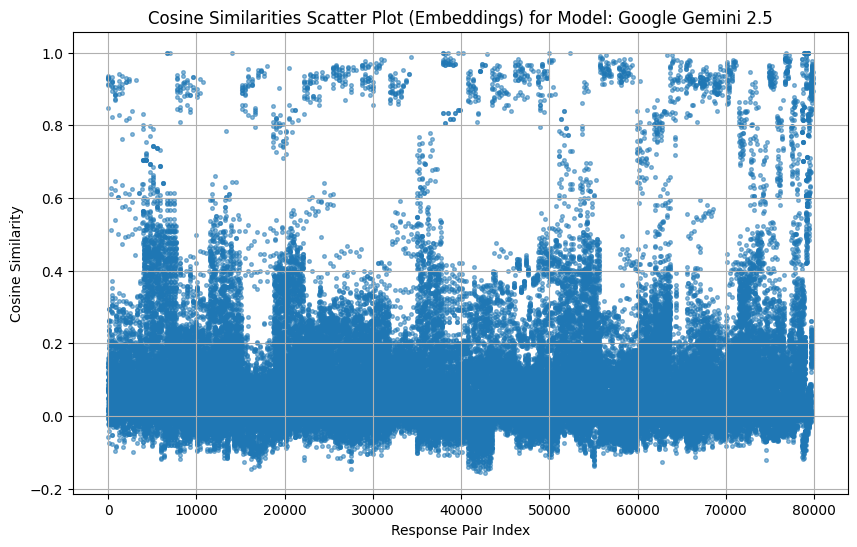


--- Analysis for Model: Meta Llama 4.0 ---


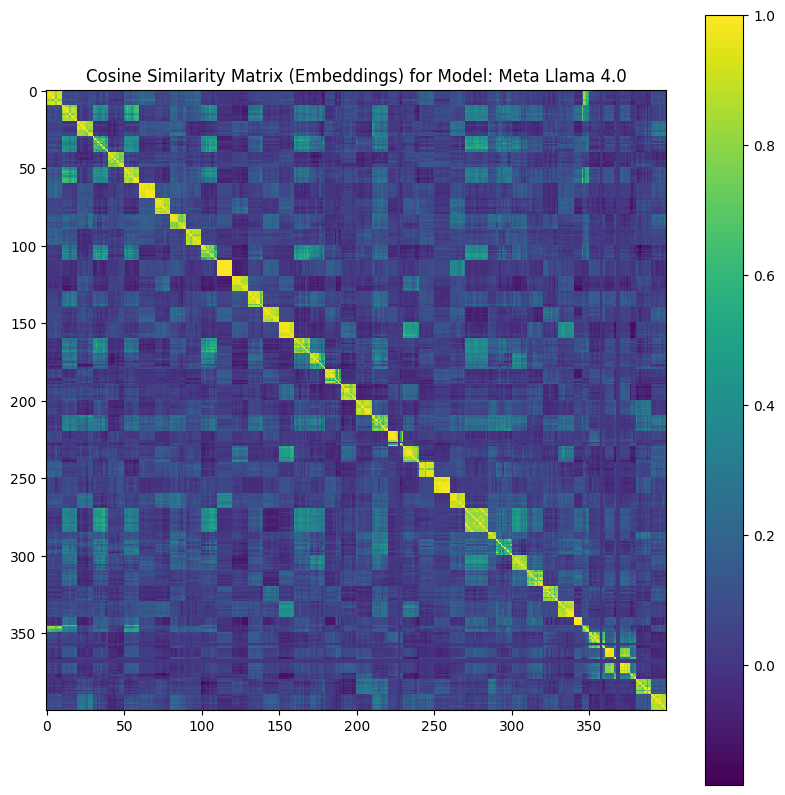

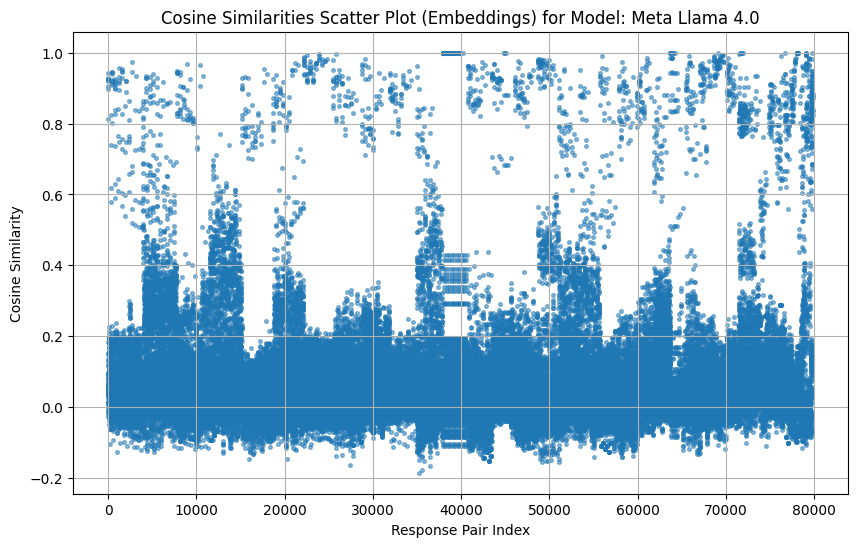


--- Analysis for Model: Grok 4.0 ---


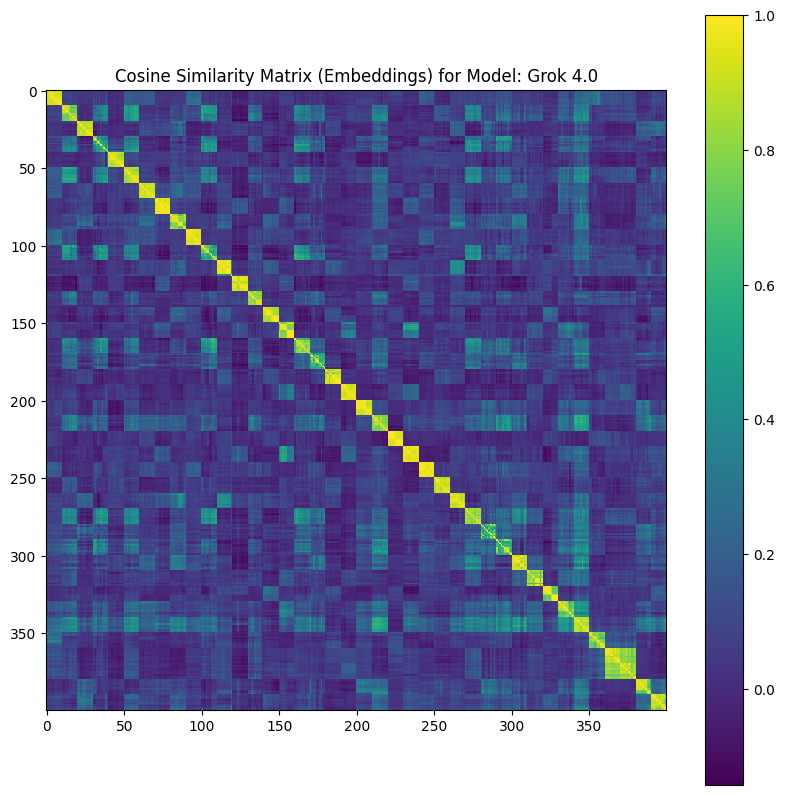

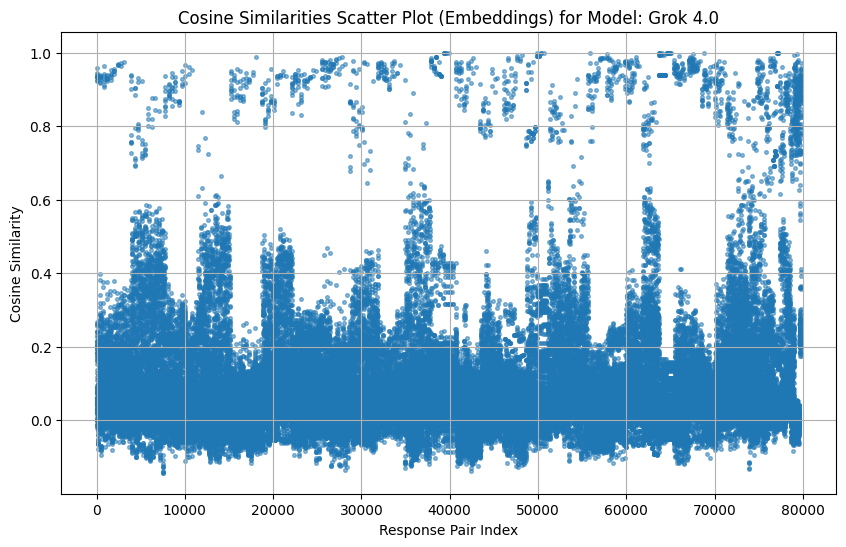

In [ ]:
# Analyze similarity by Prompt Type using embeddings
print("\n--- Cosine Similarity Analysis by Prompt Type (Embeddings) ---")
prompt_types = df_cleaned['Prompt Type'].unique()
for prompt_type in prompt_types:
    print(f"\n--- Analysis for Prompt Type: {prompt_type} ---")
    prompt_type_df = df_cleaned[df_cleaned['Prompt Type'] == prompt_type].copy()

    if not prompt_type_df.empty and len(prompt_type_df) > 1:
        # Get embeddings for the current prompt type
        embeddings = np.array(prompt_type_df['Response Embedding'].tolist())

        # Calculate cosine similarity
        cosine_similarities_embeddings = cosine_similarity(embeddings)

        # Plot the similarity points in a heat graph
        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities_embeddings, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix (Embeddings) for Prompt Type: {prompt_type}')
        plt.colorbar()
        plt.show()

        # Plot the scatter plot of similarities
        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        x_embeddings = np.arange(len(cosine_similarities_embeddings_unique))
        y_embeddings = cosine_similarities_embeddings_unique

        plt.figure(figsize=(10, 6))
        plt.scatter(x_embeddings, y_embeddings, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot (Embeddings) for Prompt Type: {prompt_type}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()
    else:
        print("Not enough data for this prompt type to perform similarity analysis.")

# Analyze similarity by Model using embeddings
print("\n--- Cosine Similarity Analysis by Model (Embeddings) ---")
models = df_cleaned['Model'].unique()
for model in models:
    print(f"\n--- Analysis for Model: {model} ---")
    model_df = df_cleaned[df_cleaned['Model'] == model].copy()

    if not model_df.empty and len(model_df) > 1:
        # Get embeddings for the current model
        embeddings = np.array(model_df['Response Embedding'].tolist())

        # Calculate cosine similarity
        cosine_similarities_embeddings = cosine_similarity(embeddings)

        # Plot the similarity points in a heat graph
        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities_embeddings, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix (Embeddings) for Model: {model}')
        plt.colorbar()
        plt.show()

        # Plot the scatter plot of similarities
        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        x_embeddings = np.arange(len(cosine_similarities_embeddings_unique))
        y_embeddings = cosine_similarities_embeddings_unique


        plt.figure(figsize=(10, 6))
        plt.scatter(x_embeddings, y_embeddings, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot (Embeddings) for Model: {model}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()
    else:
        print("Not enough data for this model to perform similarity analysis.")


--- Cosine Similarity Analysis by User Name (Embeddings) ---

--- Analysis for User Name: Hayden ---


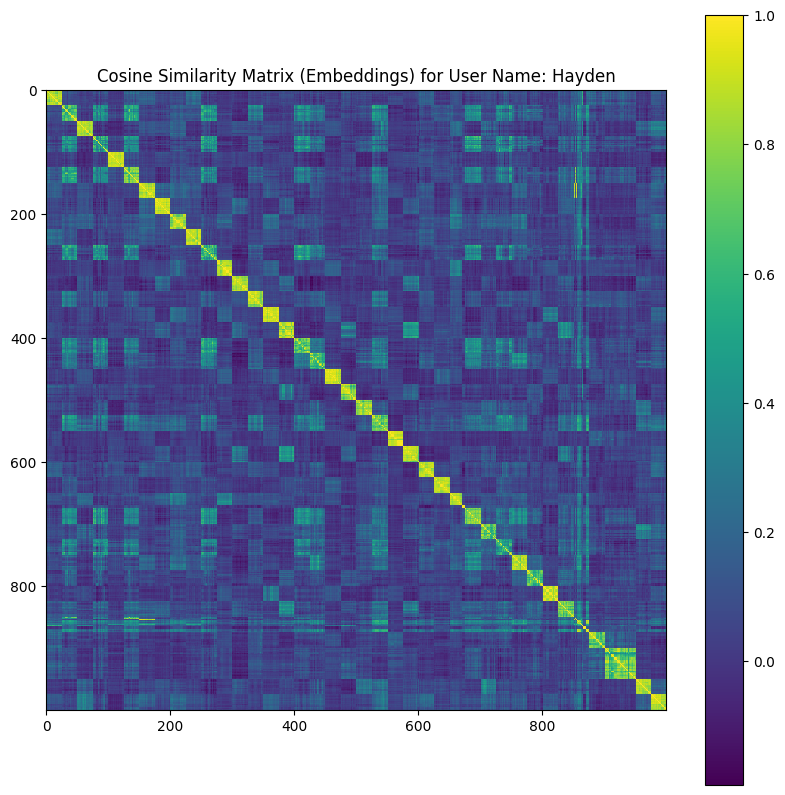

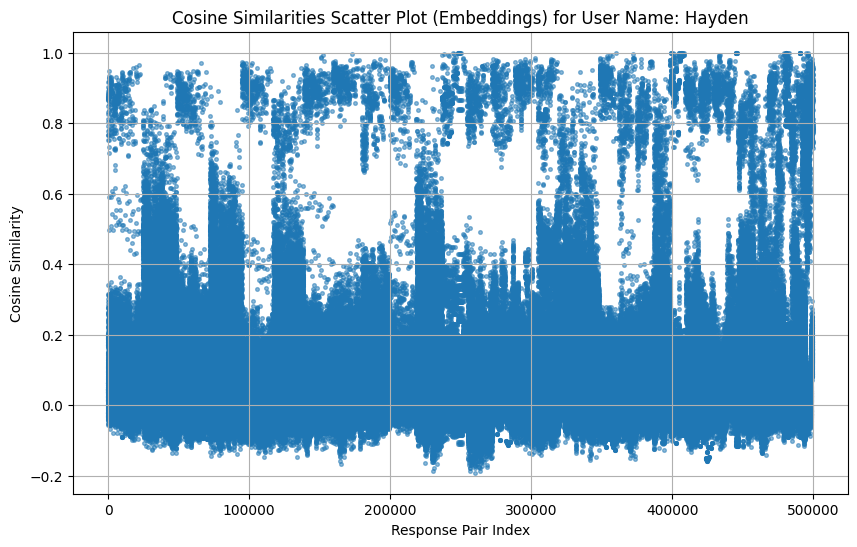


--- Analysis for User Name: Smera ---


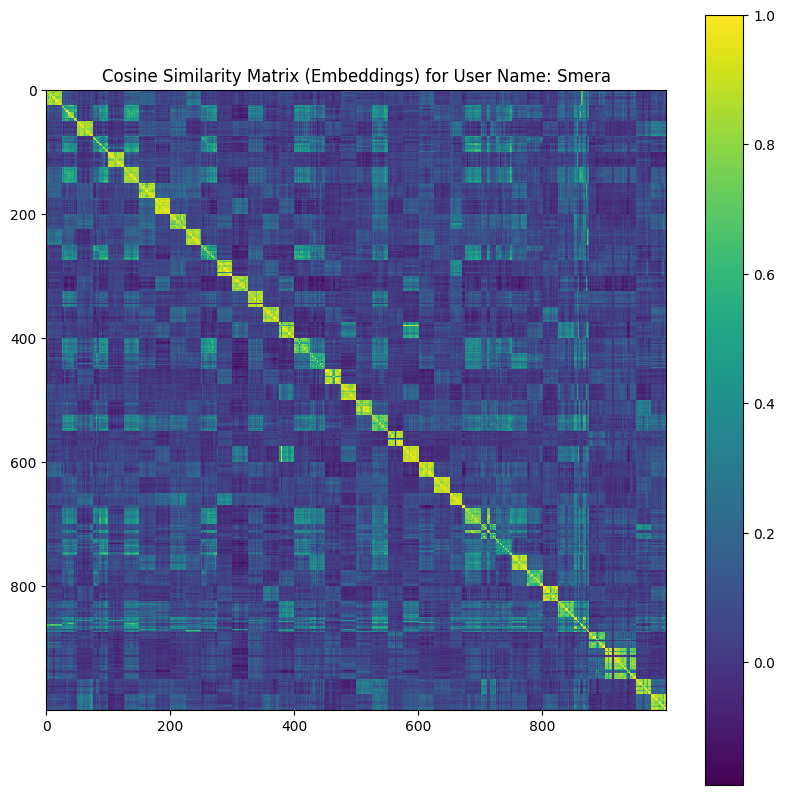

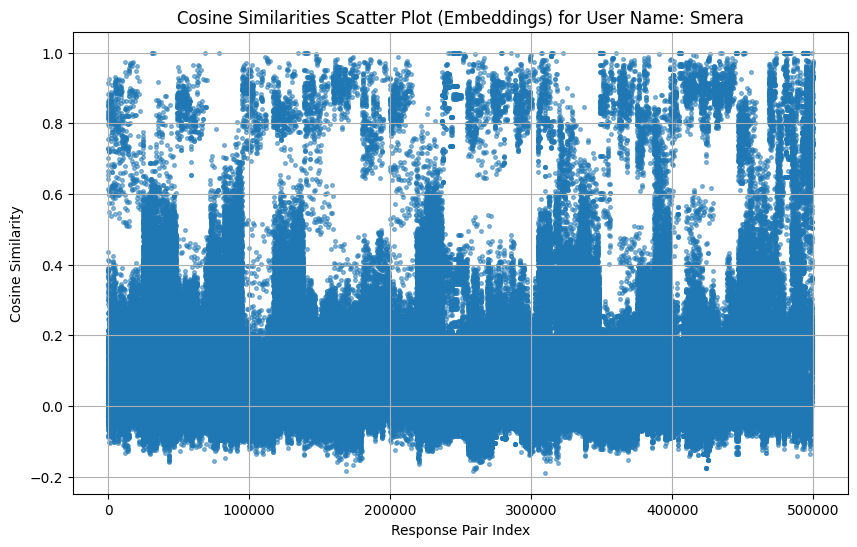

In [ ]:
# Analyze similarity by User Name (Embeddings)
print("\n--- Cosine Similarity Analysis by User Name (Embeddings) ---")
user_names = df_cleaned[df_cleaned.keys()[5]].unique()
for user_name in user_names:
    print(f"\n--- Analysis for User Name: {user_name} ---")
    user_name_df = df_cleaned[df_cleaned[df_cleaned.keys()[5]] == user_name].copy()

    if not user_name_df.empty and len(user_name_df) > 1:
        embeddings = np.array(user_name_df['Response Embedding'].tolist())

        cosine_similarities_embeddings = cosine_similarity(embeddings)

        plt.figure(figsize=(10, 10))
        plt.imshow(cosine_similarities_embeddings, cmap='viridis', interpolation='nearest')
        plt.title(f'Cosine Similarity Matrix (Embeddings) for User Name: {user_name}')
        plt.colorbar()
        plt.show()

        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        x_embeddings = np.arange(len(cosine_similarities_embeddings_unique))
        y_embeddings = cosine_similarities_embeddings_unique

        plt.figure(figsize=(10, 6))
        plt.scatter(x_embeddings, y_embeddings, s=7, alpha=0.5)
        plt.title(f'Cosine Similarities Scatter Plot (Embeddings) for User Name: {user_name}')
        plt.xlabel('Response Pair Index')
        plt.ylabel('Cosine Similarity')
        plt.grid(True)
        plt.show()
    else:
        print("Not enough data for this user to perform similarity analysis.")

In [ ]:
# Report on Cosine Similarity by Prompt Type (Embeddings)
print("--- Cosine Similarity Report by Prompt Type (Embeddings) ---")
prompt_types = df_cleaned['Prompt Type'].unique()
for prompt_type in prompt_types:
    prompt_type_df = df_cleaned[df_cleaned['Prompt Type'] == prompt_type].copy()
    if not prompt_type_df.empty and len(prompt_type_df) > 1:
        embeddings = np.array(prompt_type_df['Response Embedding'].tolist())
        cosine_similarities_embeddings = cosine_similarity(embeddings)

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique)
        print(f"Prompt Type: {prompt_type}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
        print(f"  Average Cosine Similarity (Embeddings): {average_similarity_embeddings:.4f}")
    else:
        print(f"Prompt Type: {prompt_type}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)

# Report on Cosine Similarity by Model (Embeddings)
print("\n--- Cosine Similarity Report by Model (Embeddings) ---")
models = df_cleaned['Model'].unique()
for model in models:
    model_df = df_cleaned[df_cleaned['Model'] == model].copy()
    if not model_df.empty and len(model_df) > 1:
        embeddings = np.array(model_df['Response Embedding'].tolist())
        cosine_similarities_embeddings = cosine_similarity(embeddings)

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique)
        print(f"Model: {model}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
        print(f"  Average Cosine Similarity (Embeddings): {average_similarity_embeddings:.4f}")
    else:
        print(f"Model: {model}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)

--- Cosine Similarity Report by Prompt Type (Embeddings) ---
Prompt Type: Specific Logical
  Number of response pairs analyzed: 124750
  Average Cosine Similarity (Embeddings): 0.1444
----------------------------------------
Prompt Type: Specific Creative
  Number of response pairs analyzed: 124750
  Average Cosine Similarity (Embeddings): 0.1836
----------------------------------------
Prompt Type: Vague Logical
  Number of response pairs analyzed: 124750
  Average Cosine Similarity (Embeddings): 0.1502
----------------------------------------
Prompt Type: Vague Creative
  Number of response pairs analyzed: 124750
  Average Cosine Similarity (Embeddings): 0.2237
----------------------------------------

--- Cosine Similarity Report by Model (Embeddings) ---
Model: DeepSeek 3.1
  Number of response pairs analyzed: 79800
  Average Cosine Similarity (Embeddings): 0.1076
----------------------------------------
Model: ChatGPT 5.0
  Number of response pairs analyzed: 79800
  Average Cosine

In [ ]:

# Report on Cosine Similarity by Prompt (Embeddings)
print("\n--- Cosine Similarity Report by Prompt (Embeddings) ---")
prompts = df_cleaned[df_cleaned.keys()[0]].unique() # Use df_cleaned
for prompt in prompts:
    prompt_df = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy() # Use df_cleaned
    if not prompt_df.empty and len(prompt_df) > 1:
        embeddings = np.array(prompt_df['Response Embedding'].tolist()) # Use embeddings
        cosine_similarities_embeddings = cosine_similarity(embeddings) # Use embeddings

        # Exclude self-similarity (diagonal) and duplicate pairs
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1) # Use embeddings
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings] # Use embeddings

        average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique) # Use embeddings
        print(f"Prompt: {prompt}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
        print(f"  Average Cosine Similarity (Embeddings): {average_similarity_embeddings:.4f}")
    else:
        print(f"Prompt: {prompt}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)

# Report on Cosine Similarity by Prompt, Prompt Type, and Model (Embeddings)
print("\n--- Cosine Similarity Report by Prompt, Prompt Type, and Model (Embeddings) ---")
prompts = df_cleaned[df_cleaned.keys()[0]].unique() # Use df_cleaned
for prompt in prompts:
    print(f"\nPrompt: {prompt}")
    prompt_df = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy() # Use df_cleaned
    prompt_types = prompt_df['Prompt Type'].unique()
    for prompt_type in prompt_types:
        print(f"  Prompt Type: {prompt_type}")
        prompt_type_df = prompt_df[prompt_df['Prompt Type'] == prompt_type].copy()
        models = prompt_type_df['Model'].unique()
        for model in models:
            model_df = prompt_type_df[prompt_type_df['Model'] == model].copy()

            # Check if there is enough text data before vectorizing
            if not model_df.empty and len(model_df) > 1 and any(model_df['Response Text'].str.strip().astype(bool)):
                # Create TF-IDF vectors
                try:
                    embeddings = np.array(model_df['Response Embedding'].tolist()) # Use embeddings
                    cosine_similarities_embeddings = cosine_similarity(embeddings) # Use embeddings

                    # Exclude self-similarity (diagonal) and duplicate pairs
                    upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1) # Use embeddings
                    cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings] # Use embeddings


                    average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique) # Use embeddings
                    print(f"    Model: {model}")
                    print(f"      Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
                    print(f"      Average Cosine Similarity (Embeddings): {average_similarity_embeddings:.4f}")
                except ValueError as e:
                    print(f"    Model: {model}")
                    print(f"      Could not calculate similarity: {e}")
            else:
                print(f"    Model: {model}")
                print("      Not enough data to calculate similarity.")
        print("-" * 40)
    print("=" * 60)


--- Cosine Similarity Report by Prompt (Embeddings) ---
Prompt: How would you go about solving a complex sudoku puzzle?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity (Embeddings): 0.8363
----------------------------------------
Prompt: Write a poem about absurdism.
  Number of response pairs analyzed: 1225
  Average Cosine Similarity (Embeddings): 0.6139
----------------------------------------
Prompt: Should governments prioritize economic growth or environmental protection?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity (Embeddings): 0.8502
----------------------------------------
Prompt: Write a short story.
  Number of response pairs analyzed: 1225
  Average Cosine Similarity (Embeddings): 0.4644
----------------------------------------
Prompt: What happened to each of Ragnar Lothbrok's sons?
  Number of response pairs analyzed: 1225
  Average Cosine Similarity (Embeddings): 0.8685
----------------------------------------
Prompt: Writ

In [ ]:
# Calculate average similarity for each prompt using embeddings
prompt_average_similarities_embeddings = {}
prompts = df_cleaned[df_cleaned.keys()[0]].unique() # Use df_cleaned
for prompt in prompts:
    prompt_df = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy() # Use df_cleaned
    if not prompt_df.empty and len(prompt_df) > 1:
        embeddings = np.array(prompt_df['Response Embedding'].tolist()) # Use embeddings
        cosine_similarities_embeddings = cosine_similarity(embeddings) # Use embeddings
        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1) # Use embeddings
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings] # Use embeddings
        average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique) # Use embeddings
        prompt_average_similarities_embeddings[prompt] = average_similarity_embeddings

# Convert the dictionary to a pandas Series for easy calculation of summary statistics
average_similarities_embeddings_series = pd.Series(prompt_average_similarities_embeddings)

# Report the 5-point summary
print("\n--- 5-Point Summary of Average Cosine Similarity by Prompt (Embeddings) ---")
print(average_similarities_embeddings_series.describe())

# Optionally, list the prompts with the highest, lowest, and median similarities
print("\nPrompt with Highest Average Similarity (Embeddings):")
print(average_similarities_embeddings_series.idxmax(), f": {average_similarities_embeddings_series.max():.4f}")

print("\nPrompt with Lowest Average Similarity (Embeddings):")
print(average_similarities_embeddings_series.idxmin(), f": {average_similarities_embeddings_series.min():.4f}")

print("\nPrompts with Median Average Similarity (Embeddings):")
# Find prompts with similarity close to the median
median_similarity_embeddings = average_similarities_embeddings_series.median()
prompts_at_median_embeddings = average_similarities_embeddings_series[np.isclose(average_similarities_embeddings_series, median_similarity_embeddings, atol=0.005)] # Use a small tolerance for floating point comparison
for prompt, similarity in prompts_at_median_embeddings.items():
    print(f"- {prompt}: {similarity:.4f}")


--- 5-Point Summary of Average Cosine Similarity by Prompt (Embeddings) ---
count    40.000000
mean      0.757607
std       0.129656
min       0.455947
25%       0.666464
50%       0.819472
75%       0.856164
max       0.908178
dtype: float64

Prompt with Highest Average Similarity (Embeddings):
Who makes a better leader: an extrovert or an introvert? : 0.9082

Prompt with Lowest Average Similarity (Embeddings):
How would you go about solving a complex sudoku puzzle? Write a poem about absurdism. Should governments prioritize economic growth or environmental protection? Write a short story. What happened to each of Ragnar Lothbrok's sons? Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. Write a poem about absurdism where a land surveyor attempts to survey the land surrounding a castle. How would you identify and resolve a conflict between two coworkers? Who makes a better leader: an extrovert or an introvert? Write a paragraph to dis

In [ ]:
# Report on Cosine Similarity by User Name (Embeddings)
print("\n--- Cosine Similarity Report by User Name (Embeddings) ---")
user_names = df_cleaned[df_cleaned.keys()[5]].unique()
for user_name in user_names:
    user_name_df = df_cleaned[df_cleaned[df_cleaned.keys()[5]] == user_name].copy()
    if not user_name_df.empty and len(user_name_df) > 1:
        embeddings = np.array(user_name_df['Response Embedding'].tolist())
        cosine_similarities_embeddings = cosine_similarity(embeddings)

        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]

        average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique)
        print(f"User Name: {user_name}")
        print(f"  Number of response pairs analyzed: {len(cosine_similarities_embeddings_unique)}")
        print(f"  Average Cosine Similarity (Embeddings): {average_similarity_embeddings:.4f}")
    else:
        print(f"User Name: {user_name}")
        print("  Not enough data to calculate similarity.")
    print("-" * 40)



--- Cosine Similarity Report by User Name (Embeddings) ---
User Name: Hayden
  Number of response pairs analyzed: 499500
  Average Cosine Similarity (Embeddings): 0.0977
----------------------------------------
User Name: Smera
  Number of response pairs analyzed: 499500
  Average Cosine Similarity (Embeddings): 0.0991
----------------------------------------


In [ ]:
# Calculate and report average in-group similarity for each model and prompt type using embeddings
print("\n--- Average In-Group Cosine Similarity by Model and Prompt Type (Embeddings) ---")

# Create dictionaries to store the sum of similarities and the count for each model and prompt type
model_similarity_sums_embeddings = {model: 0 for model in df_cleaned['Model'].unique()}
model_similarity_counts_embeddings = {model: 0 for model in df_cleaned['Model'].unique()}
prompt_type_similarity_sums_embeddings = {ptype: 0 for ptype in df_cleaned['Prompt Type'].unique()}
prompt_type_similarity_counts_embeddings = {ptype: 0 for ptype in df_cleaned['Prompt Type'].unique()}


prompts = df_cleaned[df_cleaned.keys()[0]].unique()
for prompt in prompts:
    prompt_df = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy()
    prompt_types = prompt_df['Prompt Type'].unique()
    for prompt_type in prompt_types:
        prompt_type_df = prompt_df[prompt_df['Prompt Type'] == prompt_type].copy()
        models = prompt_type_df['Model'].unique()
        for model in models:
            model_df = prompt_type_df[prompt_type_df['Model'] == model].copy()

            if not model_df.empty and len(model_df) > 1 and any(model_df['Response Text'].str.strip().astype(bool)):
                try:
                    embeddings = np.array(model_df['Response Embedding'].tolist())
                    cosine_similarities_embeddings = cosine_similarity(embeddings)
                    upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
                    cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]
                    average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique)

                    # Add the average similarity to the corresponding sums and increment counts
                    model_similarity_sums_embeddings[model] += average_similarity_embeddings
                    model_similarity_counts_embeddings[model] += 1
                    prompt_type_similarity_sums_embeddings[prompt_type] += average_similarity_embeddings
                    prompt_type_similarity_counts_embeddings[prompt_type] += 1

                except ValueError as e:
                    # Handle cases where similarity couldn't be calculated
                    pass # Skip this combination

# Calculate and print the average in-group similarity for each model
print("Average In-Group Similarity by Model (Embeddings):")
for model in model_similarity_sums_embeddings:
    if model_similarity_counts_embeddings[model] > 0:
        average_in_group_similarity_embeddings = model_similarity_sums_embeddings[model] / model_similarity_counts_embeddings[model]
        print(f"  {model}: {average_in_group_similarity_embeddings:.4f}")
    else:
        print(f"  {model}: Not enough data to calculate in-group similarity.")

print("-" * 40)

# Calculate and print the average in-group similarity for each prompt type
print("Average In-Group Similarity by Prompt Type (Embeddings):")
for prompt_type in prompt_type_similarity_sums_embeddings:
    if prompt_type_similarity_counts_embeddings[prompt_type] > 0:
        average_in_group_similarity_embeddings = prompt_type_similarity_sums_embeddings[prompt_type] / prompt_type_similarity_counts_embeddings[prompt_type]
        print(f"  {prompt_type}: {average_in_group_similarity_embeddings:.4f}")
    else:
        print(f"  {prompt_type}: Not enough data to calculate in-group similarity.")

print("-" * 40)


--- Average In-Group Cosine Similarity by Model and Prompt Type (Embeddings) ---
Average In-Group Similarity by Model (Embeddings):
  DeepSeek 3.1: 0.8510
  ChatGPT 5.0: 0.8277
  Google Gemini 2.5: 0.8272
  Meta Llama 4.0: 0.7834
  Grok 4.0: 0.8412
----------------------------------------
Average In-Group Similarity by Prompt Type (Embeddings):
  Specific Logical: 0.8656
  Specific Creative: 0.8102
  Vague Logical: 0.8884
  Vague Creative: 0.7403
----------------------------------------


Attempt cluster analysis to see if 'found' clusters agree with the ground truth

Mark each vector with their category

Report out results numerically

In [ ]:
print("\n--- Average In-Group Cosine Similarity by Prompt, Prompt Type, Model, and User ---")

prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    print(f"\nPrompt: {prompt}")
    prompt_df_full = df[df[df.keys()[0]] == prompt].copy()
    prompt_df_cleaned = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy()

    prompt_types = prompt_df_full['Prompt Type'].unique()
    for prompt_type in prompt_types:
        print(f"  Prompt Type: {prompt_type}")
        prompt_type_df_full = prompt_df_full[prompt_df_full['Prompt Type'] == prompt_type].copy()
        prompt_type_df_cleaned = prompt_df_cleaned[prompt_df_cleaned['Prompt Type'] == prompt_type].copy()

        models = prompt_type_df_full['Model'].unique()
        for model in models:
            print(f"    Model: {model}")
            model_df_full = prompt_type_df_full[prompt_type_df_full['Model'] == model].copy()
            model_df_cleaned = prompt_type_df_cleaned[prompt_type_df_cleaned['Model'] == model].copy()

            users = model_df_full[df.keys()[5]].unique()
            for user in users:
                user_model_df_full = model_df_full[model_df_full[df.keys()[5]] == user].copy()
                user_model_df_cleaned = model_df_cleaned[model_df_cleaned[df_cleaned.keys()[5]] == user].copy()

                tf_idf_similarity = "N/A"
                embeddings_similarity = "N/A"
                num_pairs_tfidf = 0
                num_pairs_embeddings = 0

                # --- TF-IDF Similarity Calculation ---
                if not user_model_df_full.empty and len(user_model_df_full) > 1 and any(user_model_df_full['Response Text'].str.strip().astype(bool)):
                    vectorizer = TfidfVectorizer()
                    try:
                        tfidf_matrix = vectorizer.fit_transform(user_model_df_full['Response Text'])
                        cosine_similarities = cosine_similarity(tfidf_matrix)
                        upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
                        cosine_similarities_unique = cosine_similarities[upper_triangular_indices]
                        if len(cosine_similarities_unique) > 0:
                            tf_idf_similarity = np.mean(cosine_similarities_unique)
                            num_pairs_tfidf = len(cosine_similarities_unique)
                    except ValueError:
                        pass # Not enough features for TF-IDF

                # --- Embeddings Similarity Calculation ---
                if not user_model_df_cleaned.empty and len(user_model_df_cleaned) > 1 and 'Response Embedding' in user_model_df_cleaned.columns and any(isinstance(x, list) and len(x) > 0 for x in user_model_df_cleaned['Response Embedding'] if x is not None):
                    try:
                        embeddings = np.array(user_model_df_cleaned['Response Embedding'].tolist())
                        cosine_similarities_embeddings = cosine_similarity(embeddings)
                        upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
                        cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]
                        if len(cosine_similarities_embeddings_unique) > 0:
                            embeddings_similarity = np.mean(cosine_similarities_embeddings_unique)
                            num_pairs_embeddings = len(cosine_similarities_embeddings_unique)
                    except ValueError:
                        pass # Embeddings not valid or not enough data

                print(f"      User: {user}")
                print(f"        Avg Cosine Similarity (TF-IDF): {tf_idf_similarity:.4f} ({num_pairs_tfidf} pairs)" if isinstance(tf_idf_similarity, float) else f"        Avg Cosine Similarity (TF-IDF): {tf_idf_similarity}")
                print(f"        Avg Cosine Similarity (Embeddings): {embeddings_similarity:.4f} ({num_pairs_embeddings} pairs)" if isinstance(embeddings_similarity, float) else f"        Avg Cosine Similarity (Embeddings): {embeddings_similarity}")
            print("    " + "-" * 50) # Separator for users within a model
        print("  " + "=" * 60) # Separator for models within a prompt type
    print("#" * 70) # Separator for prompt types within a prompt



--- Average In-Group Cosine Similarity by Prompt, Prompt Type, Model, and User ---

Prompt: How would you go about solving a complex sudoku puzzle?
  Prompt Type: Specific Logical
    Model: DeepSeek 3.1
      User: Hayden
        Avg Cosine Similarity (TF-IDF): 0.8450 (10 pairs)
        Avg Cosine Similarity (Embeddings): 0.8998 (10 pairs)
      User: Smera
        Avg Cosine Similarity (TF-IDF): 0.6909 (10 pairs)
        Avg Cosine Similarity (Embeddings): 0.8946 (10 pairs)
    --------------------------------------------------
    Model: ChatGPT 5.0
      User: Hayden
        Avg Cosine Similarity (TF-IDF): 0.7334 (10 pairs)
        Avg Cosine Similarity (Embeddings): 0.8952 (10 pairs)
      User: Smera
        Avg Cosine Similarity (TF-IDF): 0.6550 (10 pairs)
        Avg Cosine Similarity (Embeddings): 0.8068 (10 pairs)
    --------------------------------------------------
    Model: Google Gemini 2.5
      User: Hayden
        Avg Cosine Similarity (TF-IDF): 0.9026 (10 pairs)
  

In [ ]:
# Calculate and report average in-group similarity for each user
print("\n--- Average In-Group Cosine Similarity by User ---")

# Create dictionaries to store the sum of similarities and the count for each user (TF-IDF)
user_similarity_sums_tfidf = {user: 0 for user in df[df.keys()[5]].unique()}
user_similarity_counts_tfidf = {user: 0 for user in df[df.keys()[5]].unique()}

# Create dictionaries to store the sum of similarities and the count for each user (Embeddings)
user_similarity_sums_embeddings = {user: 0 for user in df_cleaned[df_cleaned.keys()[5]].unique()}
user_similarity_counts_embeddings = {user: 0 for user in df_cleaned[df_cleaned.keys()[5]].unique()}

prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    prompt_df_full = df[df[df.keys()[0]] == prompt].copy()
    prompt_df_cleaned = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy()

    users = prompt_df_full[df.keys()[5]].unique()
    for user in users:
        user_prompt_df_full = prompt_df_full[prompt_df_full[df.keys()[5]] == user].copy()
        user_prompt_df_cleaned = prompt_df_cleaned[prompt_df_cleaned[df_cleaned.keys()[5]] == user].copy()

        # --- TF-IDF Similarity Calculation ---
        if not user_prompt_df_full.empty and len(user_prompt_df_full) > 1 and any(user_prompt_df_full['Response Text'].str.strip().astype(bool)):
            vectorizer = TfidfVectorizer()
            try:
                tfidf_matrix = vectorizer.fit_transform(user_prompt_df_full['Response Text'])
                cosine_similarities = cosine_similarity(tfidf_matrix)
                upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
                cosine_similarities_unique = cosine_similarities[upper_triangular_indices]
                average_similarity = np.mean(cosine_similarities_unique)

                user_similarity_sums_tfidf[user] += average_similarity
                user_similarity_counts_tfidf[user] += 1
            except ValueError as e:
                pass # Not enough features for TF-IDF

        # --- Embeddings Similarity Calculation ---
        if not user_prompt_df_cleaned.empty and len(user_prompt_df_cleaned) > 1 and 'Response Embedding' in user_prompt_df_cleaned.columns:
            try:
                embeddings = np.array(user_prompt_df_cleaned['Response Embedding'].tolist())
                cosine_similarities_embeddings = cosine_similarity(embeddings)
                upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
                cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]
                average_similarity_embeddings = np.mean(cosine_similarities_embeddings_unique)

                user_similarity_sums_embeddings[user] += average_similarity_embeddings
                user_similarity_counts_embeddings[user] += 1
            except ValueError as e:
                pass # Embeddings not valid or not enough data

# Calculate and print the overall average in-group similarity for each user (TF-IDF)
print("Average In-Group Similarity by User (TF-IDF):")
for user in user_similarity_sums_tfidf:
    if user_similarity_counts_tfidf[user] > 0:
        average_in_group_similarity_tfidf = user_similarity_sums_tfidf[user] / user_similarity_counts_tfidf[user]
        print(f"  {user}: {average_in_group_similarity_tfidf:.4f}")
    else:
        print(f"  {user}: Not enough data to calculate in-group similarity (TF-IDF).")

print("-" * 40)

# Calculate and print the overall average in-group similarity for each user (Embeddings)
print("Average In-Group Similarity by User (Embeddings):")
for user in user_similarity_sums_embeddings:
    if user_similarity_counts_embeddings[user] > 0:
        average_in_group_similarity_embeddings = user_similarity_sums_embeddings[user] / user_similarity_counts_embeddings[user]
        print(f"  {user}: {average_in_group_similarity_embeddings:.4f}")
    else:
        print(f"  {user}: Not enough data to calculate in-group similarity (Embeddings).")

print("-" * 40)



--- Average In-Group Cosine Similarity by User ---
Average In-Group Similarity by User (TF-IDF):
  Hayden: 0.3961
  Smera: 0.3539
----------------------------------------
Average In-Group Similarity by User (Embeddings):
  Hayden: 0.7817
  Smera: 0.7413
----------------------------------------


In [ ]:
# Calculate average TF-IDF similarities for models
avg_model_tf_idf = {
    model: model_similarity_sums[model] / model_similarity_counts[model]
    for model in model_similarity_sums
    if model_similarity_counts[model] > 0
}

# Calculate average TF-IDF similarities for prompt types
avg_prompt_type_tf_idf = {
    ptype: prompt_type_similarity_sums[ptype] / prompt_type_similarity_counts[ptype]
    for ptype in prompt_type_similarity_sums
    if prompt_type_similarity_counts[ptype] > 0
}

# Calculate average embedding similarities for models
avg_model_embeddings = {
    model: model_similarity_sums_embeddings[model] / model_similarity_counts_embeddings[model]
    for model in model_similarity_sums_embeddings
    if model_similarity_counts_embeddings[model] > 0
}

# Calculate average embedding similarities for prompt types
avg_prompt_type_embeddings = {
    ptype: prompt_type_similarity_sums_embeddings[ptype] / prompt_type_similarity_counts_embeddings[ptype]
    for ptype in prompt_type_similarity_sums_embeddings
    if prompt_type_similarity_counts_embeddings[ptype] > 0
}

# Create DataFrames for models
df_models_tf_idf = pd.DataFrame.from_dict(avg_model_tf_idf, orient='index', columns=['Avg_Similarity_TFIDF'])
df_models_embeddings = pd.DataFrame.from_dict(avg_model_embeddings, orient='index', columns=['Avg_Similarity_Embeddings'])

# Merge model dataframes
df_models_comparison = df_models_tf_idf.merge(
    df_models_embeddings, left_index=True, right_index=True, how='outer'
)
df_models_comparison.index.name = 'Category'

print("\n--- Average In-Group Cosine Similarity Comparison by Model ---")
display(df_models_comparison)

# Create DataFrames for prompt types
df_prompt_types_tf_idf = pd.DataFrame.from_dict(avg_prompt_type_tf_idf, orient='index', columns=['Avg_Similarity_TFIDF'])
df_prompt_types_embeddings = pd.DataFrame.from_dict(avg_prompt_type_embeddings, orient='index', columns=['Avg_Similarity_Embeddings'])

# Merge prompt type dataframes
df_prompt_types_comparison = df_prompt_types_tf_idf.merge(
    df_prompt_types_embeddings, left_index=True, right_index=True, how='outer'
)
df_prompt_types_comparison.index.name = 'Category'

print("\n--- Average In-Group Cosine Similarity Comparison by Prompt Type ---")
display(df_prompt_types_comparison)



--- Average In-Group Cosine Similarity Comparison by Model ---


,Avg_Similarity_TFIDF,Avg_Similarity_Embeddings
Category,,
ChatGPT 5.0,0.465459,0.827731
DeepSeek 3.1,0.621627,0.851004
Google Gemini 2.5,0.592302,0.827187
Grok 4.0,0.472496,0.841213
Meta Llama 4.0,0.431409,0.783404



--- Average In-Group Cosine Similarity Comparison by Prompt Type ---


,Avg_Similarity_TFIDF,Avg_Similarity_Embeddings
Category,,
Specific Creative,0.469440,0.810162
Specific Logical,0.576272,0.865579
Vague Creative,0.482310,0.740309
Vague Logical,0.538614,0.888381


In [ ]:
results_list = []

prompts = df[df.keys()[0]].unique()
for prompt in prompts:
    prompt_df = df[df[df.keys()[0]] == prompt].copy()
    prompt_df_cleaned = df_cleaned[df_cleaned[df_cleaned.keys()[0]] == prompt].copy()

    prompt_types = prompt_df['Prompt Type'].unique()
    for prompt_type in prompt_types:
        prompt_type_df = prompt_df[prompt_df['Prompt Type'] == prompt_type].copy()
        prompt_type_df_cleaned = prompt_df_cleaned[prompt_df_cleaned['Prompt Type'] == prompt_type].copy()

        models = prompt_type_df['Model'].unique()
        for model in models:
            model_df = prompt_type_df[prompt_type_df['Model'] == model].copy()
            model_df_cleaned = prompt_type_df_cleaned[prompt_type_df_cleaned['Model'] == model].copy()

            avg_tf_idf_similarity = np.nan
            avg_embeddings_similarity = np.nan

            # Calculate TF-IDF similarity
            if not model_df.empty and len(model_df) > 1 and any(model_df['Response Text'].str.strip().astype(bool)):
                vectorizer = TfidfVectorizer()
                try:
                    tfidf_matrix = vectorizer.fit_transform(model_df['Response Text'])
                    cosine_similarities = cosine_similarity(tfidf_matrix)
                    upper_triangular_indices = np.triu_indices_from(cosine_similarities, k=1)
                    cosine_similarities_unique = cosine_similarities[upper_triangular_indices]
                    if len(cosine_similarities_unique) > 0:
                        avg_tf_idf_similarity = np.mean(cosine_similarities_unique)
                except ValueError:
                    pass # Not enough features for TF-IDF, keep as nan

            # Calculate embeddings similarity
            if not model_df_cleaned.empty and len(model_df_cleaned) > 1 and 'Response Embedding' in model_df_cleaned.columns and any(isinstance(x, list) and len(x) > 0 for x in model_df_cleaned['Response Embedding'] if x is not None):
                try:
                    embeddings = np.array(model_df_cleaned['Response Embedding'].tolist())
                    cosine_similarities_embeddings = cosine_similarity(embeddings)
                    upper_triangular_indices_embeddings = np.triu_indices_from(cosine_similarities_embeddings, k=1)
                    cosine_similarities_embeddings_unique = cosine_similarities_embeddings[upper_triangular_indices_embeddings]
                    if len(cosine_similarities_embeddings_unique) > 0:
                        avg_embeddings_similarity = np.mean(cosine_similarities_embeddings_unique)
                except ValueError:
                    pass # Embeddings not valid or not enough data, keep as nan

            results_list.append({
                'Prompt': prompt,
                'Prompt Type': prompt_type,
                'Model': model,
                'Avg_TFIDF_Similarity': avg_tf_idf_similarity,
                'Avg_Embeddings_Similarity': avg_embeddings_similarity
            })

# Convert the list of results into a DataFrame
df_detailed_similarities = pd.DataFrame(results_list)

# Group by 'Model' and 'Prompt Type' and calculate the mean of the similarities for specified columns
df_summary_similarities = df_detailed_similarities.groupby(['Model', 'Prompt Type'])[['Avg_TFIDF_Similarity', 'Avg_Embeddings_Similarity']].mean().reset_index()

#print("Detailed Similarities per Prompt, Prompt Type, and Model:")
#display(df_detailed_similarities.head())

#print("Summary of Average Similarities by Model and Prompt Type:")
#display(df_summary_similarities)


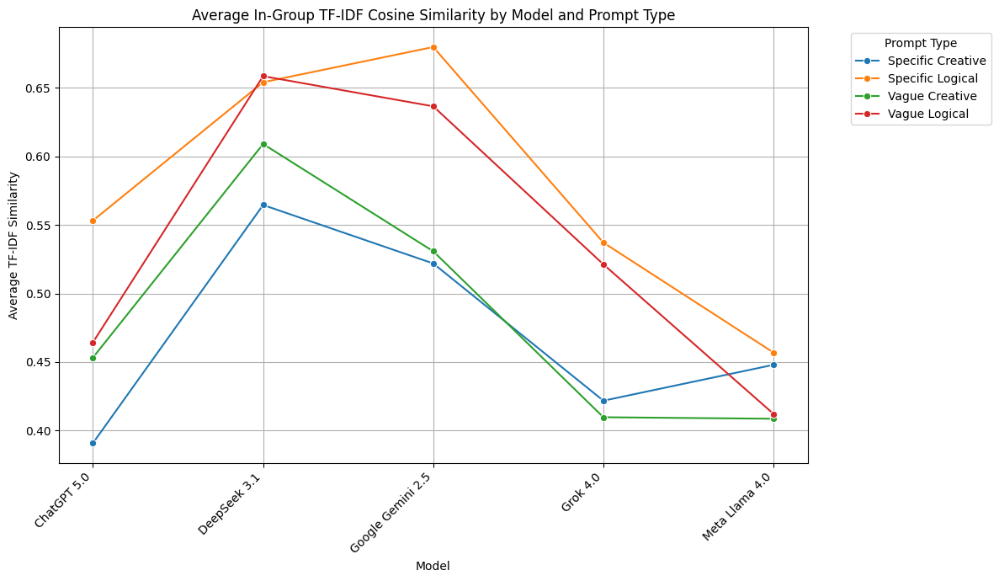

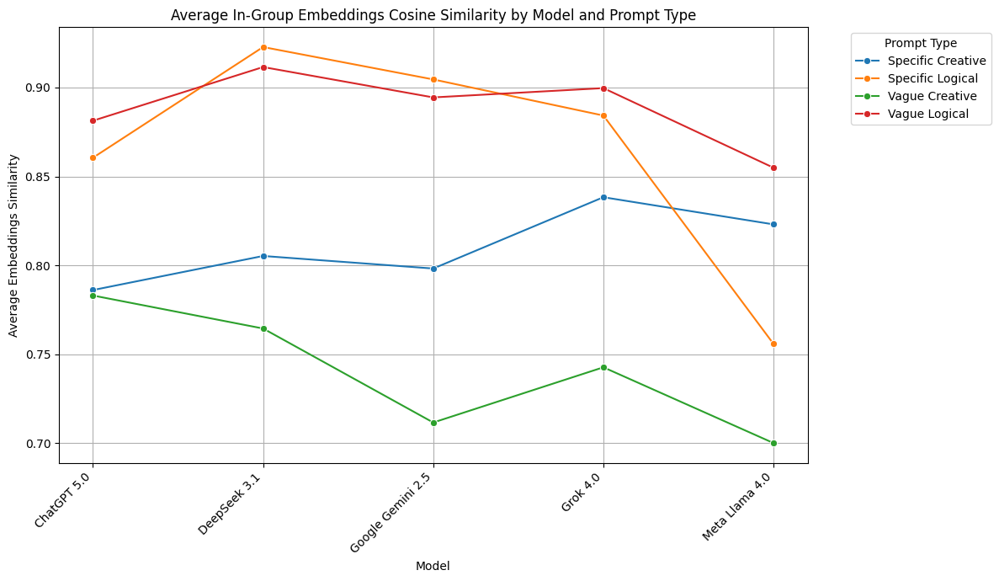

In [ ]:
plt.figure(figsize=(12, 7))
sns.lineplot(data=df_summary_similarities, x='Model', y='Avg_TFIDF_Similarity', hue='Prompt Type', marker='o')
plt.title('Average In-Group TF-IDF Cosine Similarity by Model and Prompt Type')
plt.xlabel('Model')
plt.ylabel('Average TF-IDF Similarity')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Prompt Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 7))
sns.lineplot(data=df_summary_similarities, x='Model', y='Avg_Embeddings_Similarity', hue='Prompt Type', marker='o')
plt.title('Average In-Group Embeddings Cosine Similarity by Model and Prompt Type')
plt.xlabel('Model')
plt.ylabel('Average Embeddings Similarity')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Prompt Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()


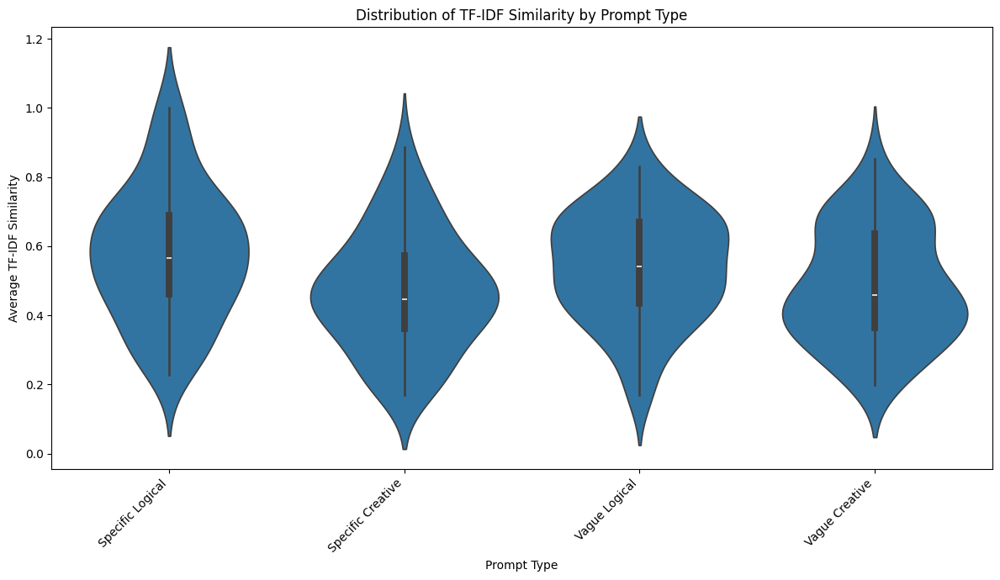

In [ ]:
plt.figure(figsize=(12, 7))
sns.violinplot(data=df_detailed_similarities, x='Prompt Type', y='Avg_TFIDF_Similarity')
plt.title('Distribution of TF-IDF Similarity by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Average TF-IDF Similarity')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

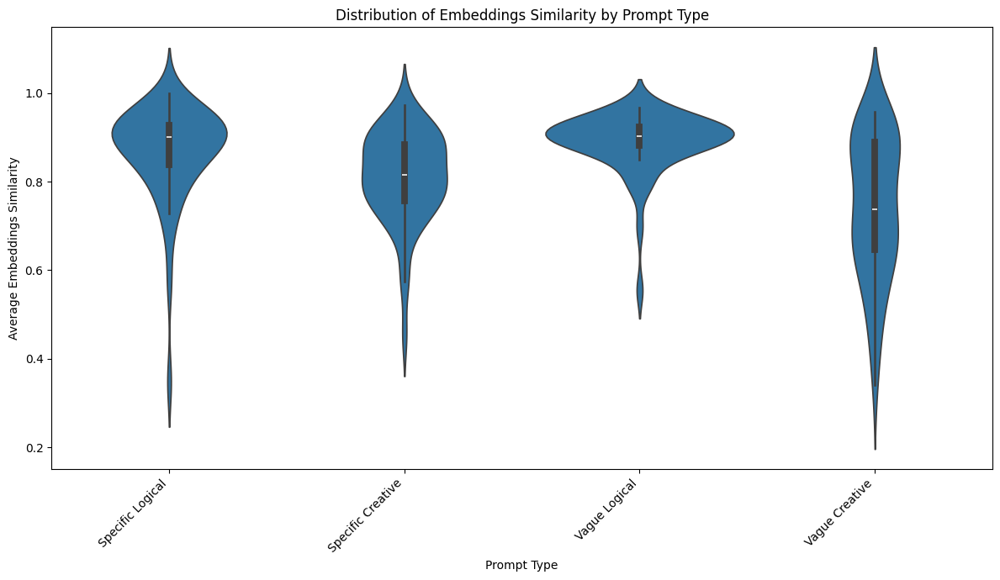

In [ ]:
plt.figure(figsize=(12, 7))
sns.violinplot(data=df_detailed_similarities, x='Prompt Type', y='Avg_Embeddings_Similarity')
plt.title('Distribution of Embeddings Similarity by Prompt Type')
plt.xlabel('Prompt Type')
plt.ylabel('Average Embeddings Similarity')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

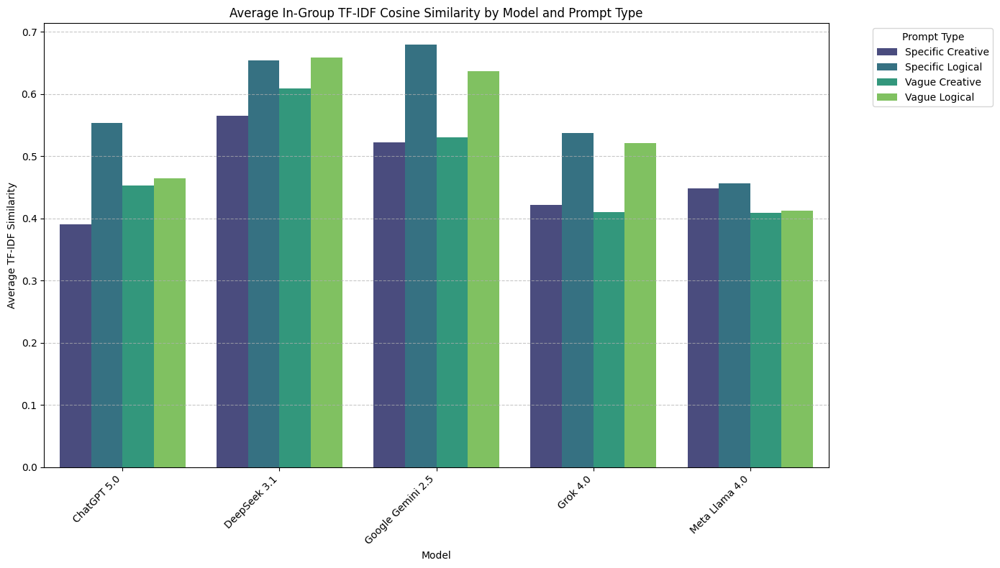

In [ ]:
plt.figure(figsize=(14, 8))
sns.barplot(data=df_summary_similarities, x='Model', y='Avg_TFIDF_Similarity', hue='Prompt Type', palette='viridis')
plt.title('Average In-Group TF-IDF Cosine Similarity by Model and Prompt Type')
plt.xlabel('Model')
plt.ylabel('Average TF-IDF Similarity')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Prompt Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

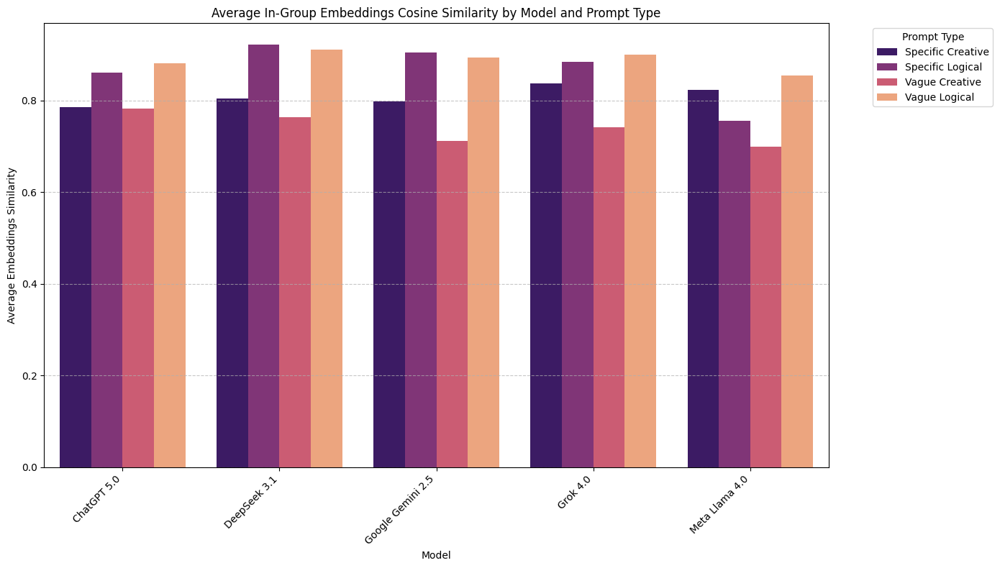

In [ ]:
plt.figure(figsize=(14, 8))
sns.barplot(data=df_summary_similarities, x='Model', y='Avg_Embeddings_Similarity', hue='Prompt Type', palette='magma')
plt.title('Average In-Group Embeddings Cosine Similarity by Model and Prompt Type')
plt.xlabel('Model')
plt.ylabel('Average Embeddings Similarity')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Prompt Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

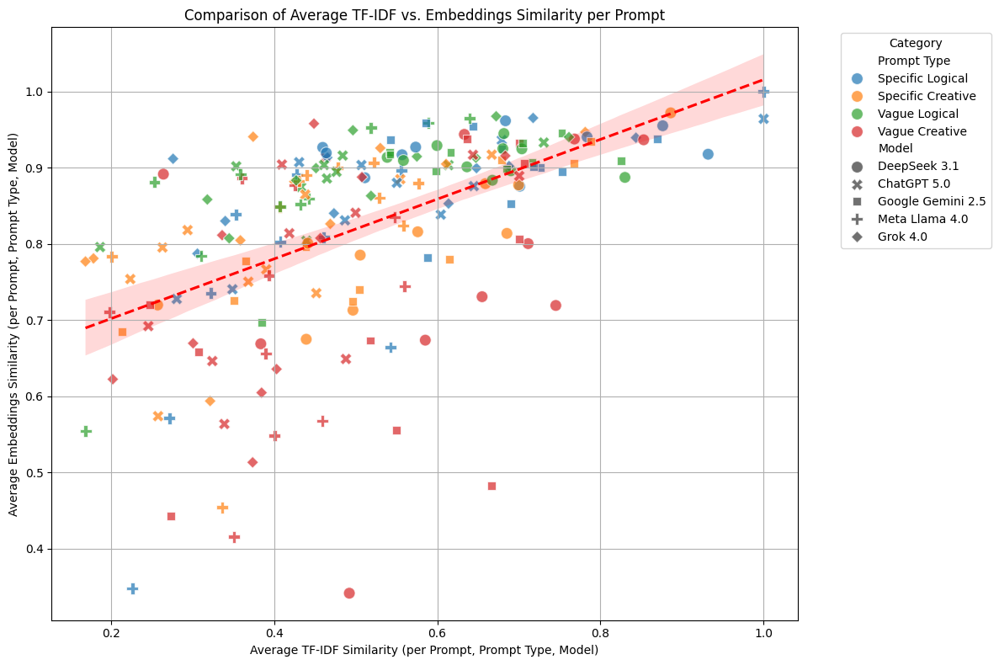

In [ ]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df_detailed_similarities, x='Avg_TFIDF_Similarity', y='Avg_Embeddings_Similarity', hue='Prompt Type', style='Model', s=100, alpha=0.7)
sns.regplot(data=df_detailed_similarities, x='Avg_TFIDF_Similarity', y='Avg_Embeddings_Similarity', scatter=False, color='red', line_kws={'linestyle':'--'})
plt.title('Comparison of Average TF-IDF vs. Embeddings Similarity per Prompt')
plt.xlabel('Average TF-IDF Similarity (per Prompt, Prompt Type, Model)')
plt.ylabel('Average Embeddings Similarity (per Prompt, Prompt Type, Model)')
plt.legend(title='Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()